In [ ]:

!pip install -q clean-fid==0.1.35
# then restart the runtime/kernel
!pip install torch-fidelity

In [ ]:
import os, glob, re, shutil, time
from pathlib import Path
import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from PIL import Image
from tqdm.auto import tqdm
import random

In [ ]:
# ---------- Single cell: resume training from latest checkpoint ----------
# Edit only these:
DRIVE_RUN_PATH = "/content/drive/MyDrive/StegoGAN_fresh"   # your Drive run folder
SRC_FOLDER = "/content/drive/MyDrive/PlanIGN/trainA"       # dataset A
TGT_FOLDER = "/content/drive/MyDrive/PlanIGN/trainB"       # dataset B
resume_epochs = 110  # how many epochs to run in this chunk
use_amp = True

# ---------- Do not edit below unless you know what you're doing ----------
import os, glob, re, shutil, time
from pathlib import Path
import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from PIL import Image
from tqdm.auto import tqdm
import random

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("Device:", device, "device_type:", device_type)

# small helpers
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg')):
    files=[]
    for e in exts:
        files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

# ensure folders
os.makedirs(DRIVE_RUN_PATH, exist_ok=True)
CKPT_DIR = os.path.join(DRIVE_RUN_PATH, "checkpoints"); os.makedirs(CKPT_DIR, exist_ok=True)
SAMPLES_DIR = os.path.join(DRIVE_RUN_PATH, "samples"); os.makedirs(SAMPLES_DIR, exist_ok=True)
LOCAL_CKPT_BACKUP = "/content/ckpts_backup"; os.makedirs(LOCAL_CKPT_BACKUP, exist_ok=True)
LOCAL_SAMPLES_BACKUP = "/content/samples_backup"; os.makedirs(LOCAL_SAMPLES_BACKUP, exist_ok=True)

# Models (same architecture you used)
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec = []
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self, x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# load dataset lists
src_files = sorted_files(SRC_FOLDER)
tgt_files = sorted_files(TGT_FOLDER)
if len(src_files)==0 or len(tgt_files)==0:
    raise RuntimeError("Dataset empty — check SRC_FOLDER/TGT_FOLDER paths in Drive.")
print("Found dataset sizes:", len(src_files), "->", len(tgt_files))

# default CFG (you can tweak later)
CFG = {
    'epochs': 200, 'batch_size':1, 'ngf':64, 'n_blocks':6, 'size':256,
    'lr_G':2e-4, 'lr_D':1e-4, 'lambda_cyc':10.0, 'lambda_id':0.5,
    'lambda_match':1.25, 'lambda_reg':0.01, 'grad_clip':5.0,
    'use_amp': use_amp, 'noise_eps':0.01, 'ema_decay':0.999
}

# instantiate models to determine mask channels
G_X2Y = ResNetGenerator(3,3,ngf=CFG['ngf'], n_blocks=CFG['n_blocks']).to(device)
G_Y2X = ResNetGenerator(3,3,ngf=CFG['ngf'], n_blocks=CFG['n_blocks']).to(device)
D_X = NLayerDiscriminator(3).to(device)
D_Y = NLayerDiscriminator(3).to(device)
with torch.no_grad():
    dummy = torch.randn(1,3,CFG['size'],CFG['size']).to(device)
    _, z = G_Y2X(dummy)
mask_predictor = MaskPredictor(in_ch=z.shape[1]).to(device)
print("Models created. mask channels:", z.shape[1])

# optimizers & scaler
all_G_params = list(G_X2Y.parameters()) + list(G_Y2X.parameters()) + list(mask_predictor.parameters())
opt_G = torch.optim.Adam(all_G_params, lr=CFG['lr_G'], betas=(0.5,0.999))
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

# Dataset
class PairDataset(Dataset):
    def __init__(self, src_files, tgt_files, size):
        self.src = src_files; self.tgt = tgt_files; self.size = size
        self.tf = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
    def __len__(self): return max(len(self.src), len(self.tgt))
    def __getitem__(self, idx):
        a = Image.open(self.src[idx % len(self.src)]).convert('RGB')
        b = Image.open(self.tgt[idx % len(self.tgt)]).convert('RGB')
        return {'A': self.tf(a), 'B': self.tf(b), 'A_path': self.src[idx%len(self.src)], 'B_path': self.tgt[idx%len(self.tgt)]}

ds = PairDataset(src_files, tgt_files, CFG['size'])
dl = DataLoader(ds, batch_size=CFG['batch_size'], shuffle=False, num_workers=0, drop_last=False)

# robust save helpers
def robust_save_checkpoint(state, epoch):
    local_tmp = os.path.join('/content', f'ckpt_ep{epoch}.pt')
    final_local = os.path.join(LOCAL_CKPT_BACKUP, f'ckpt_ep{epoch}.pt')
    dst = os.path.join(CKPT_DIR, f'ckpt_ep{epoch}.pt')
    try:
        torch.save(state, local_tmp)
    except Exception:
        torch.save(state, final_local)
        return False, final_local
    try:
        shutil.copy(local_tmp, dst)
        os.remove(local_tmp)
        return True, dst
    except Exception:
        shutil.move(local_tmp, final_local)
        return False, final_local

def robust_save_sample(grid, epoch):
    local = os.path.join(LOCAL_SAMPLES_BACKUP, f'sample_ep{epoch}.png')
    dst = os.path.join(SAMPLES_DIR, f'sample_ep{epoch}.png')
    try:
        vutils.save_image(grid, local)
    except Exception:
        return False, None
    try:
        shutil.copy(local, dst)
        return True, dst
    except Exception:
        return False, local

# choose latest checkpoint:
selected_path = None
# first prefer /content/selected_ckpt.txt if present
if os.path.exists("/content/selected_ckpt.txt"):
    p = open("/content/selected_ckpt.txt").read().strip()
    if os.path.exists(p):
        selected_path = p
        print("Using selected_ckpt.txt ->", selected_path)
# else scan CKPT_DIR and prefer checkpoint with highest internal 'epoch'
if selected_path is None:
    ckpts = sorted(glob.glob(os.path.join(CKPT_DIR, "ckpt*.pt")), key=natural_sort_key)
    if len(ckpts)>0:
        candidates = []
        for f in ckpts:
            internal = None
            try:
                st = torch.load(f, map_location='cpu')
                internal = int(st.get('epoch')) if 'epoch' in st and st.get('epoch') is not None else None
            except Exception:
                pass
            candidates.append({'path':f,'internal':internal,'mtime':os.path.getmtime(f)})
        # prefer highest internal epoch (not None) else highest filename epoch (natural sort already does), else newest mtime
        with_internal = [c for c in candidates if isinstance(c['internal'], int)]
        if with_internal:
            best = max(with_internal, key=lambda x: x['internal'])
        else:
            best = candidates[-1]  # natural-sorted last
        selected_path = best['path']
        print("Selected checkpoint by scanning CKPT_DIR ->", selected_path)
    else:
        print("No checkpoints found in CKPT_DIR; starting fresh.")
        selected_path = None

# if selected_path exists, load it safely into models/optimizers
start_epoch = 0
if selected_path:
    print("Loading checkpoint (map_location=cpu) for verification:", selected_path)
    state = torch.load(selected_path, map_location='cpu')
    # load model states (best-effort)
    def safe_load(m, key):
        if key in state:
            try:
                m.load_state_dict(state[key])
                print(f"Loaded {key}")
            except Exception as e:
                print("Warning: failed to load", key, "->", e)
    safe_load(G_X2Y, 'G_X2Y'); safe_load(G_Y2X, 'G_Y2X'); safe_load(D_X, 'D_X'); safe_load(D_Y, 'D_Y'); safe_load(mask_predictor, 'mask')
    # load optimizers & scaler if present
    try:
        if 'opt_G' in state: opt_G.load_state_dict(state['opt_G']); print("opt_G restored")
        if 'opt_Dx' in state: opt_Dx.load_state_dict(state['opt_Dx']); print("opt_Dx restored")
        if 'opt_Dy' in state: opt_Dy.load_state_dict(state['opt_Dy']); print("opt_Dy restored")
    except Exception as e:
        print("Warning: partial optimizer restore:", e)
    try:
        if 'scaler' in state: scaler.load_state_dict(state['scaler']); print("scaler restored")
    except Exception as e:
        print("Warning: scaler restore failed:", e)
    start_epoch = int(state.get('epoch', 0))
    print("Resuming from epoch", start_epoch)
else:
    print("No checkpoint loaded, starting from scratch (epoch 0).")

# move all models to device AFTER loading their CPU states (to avoid mismatched devices)
G_X2Y.to(device); G_Y2X.to(device); D_X.to(device); D_Y.to(device); mask_predictor.to(device)

# losses
mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) + mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

# resume loop
end_epoch = min(CFG['epochs'], start_epoch + resume_epochs)
print(f"Will run epochs {start_epoch+1} -> {end_epoch}")

for epoch in range(start_epoch, end_epoch):
    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}/{CFG['epochs']}")
    running = {'G':0.0, 'D':0.0, 'mask_mean':0.0}
    steps = 0
    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)
        # forward
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            y_from_A, z_A = G_X2Y(A)
            x_from_B, z_B = G_Y2X(B)
            mask = mask_predictor(z_B)
            z_unmatch = mask * z_B
            z_match = (1.0 - mask) * z_B
            xgen = G_Y2X.decoder(z_match)
            eps = (torch.randn_like(z_unmatch) * CFG.get('noise_eps', 0.01)).to(device)
            combined = z_A + z_unmatch + eps
            yrec = G_X2Y.decoder(combined)

        # update discriminators
        opt_Dx.zero_grad(); opt_Dy.zero_grad()
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_D(D_Y, B, y_from_A)
            loss_D = loss_Dx + loss_Dy

        scaler.scale(loss_D).backward()
        try:
            scaler.unscale_(opt_Dx); scaler.unscale_(opt_Dy)
        except RuntimeError as e:
            print("Warn: scaler.unscale_() failed (skipping):", e)
        torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG.get('grad_clip',5.0))
        torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG.get('grad_clip',5.0))
        scaler.step(opt_Dx); scaler.step(opt_Dy)

        # generator
        opt_G.zero_grad()
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_G_adv = adv_G(D_X, xgen) + adv_G(D_Y, y_from_A)
            X_rec, _ = G_Y2X(y_from_A)
            Y_rec, _ = G_X2Y(x_from_B)
            loss_cycle = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)
            id_x, _ = G_Y2X(A); id_y, _ = G_X2Y(B)
            loss_id = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)
            lreg = (mask.abs() + 1e-6).pow(0.5).mean()
            loss_match = F.l1_loss(x_from_B, xgen)
            loss_G = loss_G_adv + 10.0*loss_cycle + 0.5*loss_id + CFG['lambda_reg']*lreg + CFG['lambda_match']*loss_match

        scaler.scale(loss_G).backward()
        try:
            scaler.unscale_(opt_G)
        except RuntimeError as e:
            print("Warn: scaler.unscale_() failed (skipping):", e)
        torch.nn.utils.clip_grad_norm_(all_G_params, CFG.get('grad_clip',5.0))
        scaler.step(opt_G)
        scaler.update()

        mm = float(mask.mean().detach().cpu().item())
        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += mm
        pbar.set_postfix({'G_loss': running['G']/steps, 'D_loss': running['D']/steps, 'mask_mean': running['mask_mean']/steps})

    # epoch end: save checkpoint and sample
    eid = epoch + 1
    state = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'mask': mask_predictor.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    ok, where = robust_save_checkpoint(state, eid)
    print(f"[CHECKPOINT] saved? {ok}, path: {where}")

    with torch.no_grad():
        a = (A[:1].detach().cpu().clamp(-1,1)+1)/2
        x_s = (xgen[:1].detach().cpu().clamp(-1,1)+1)/2
        b = (B[:1].detach().cpu().clamp(-1,1)+1)/2
        y_s = (y_from_A[:1].detach().cpu().clamp(-1,1)+1)/2
        mask_mean = mask.mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_mean, size=(CFG.get('size',256),CFG.get('size',256)), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)
        grid = vutils.make_grid(torch.cat([a, x_s, b, y_s, mask_up], dim=0), nrow=5)
        ok_s, where_s = robust_save_sample(grid, eid)
        print(f"[SAMPLE] saved? {ok_s}, path: {where_s}")

    print(f"Epoch {eid} done. AvgG={running['G']/len(dl):.4f}, AvgD={running['D']/len(dl):.4f}, mask_mean={running['mask_mean']/len(dl):.6f}")

print("Resume chunk finished. Check Drive (or /content/ckpts_backup) for new ckpts & samples.")


Device: cuda device_type: cuda
Found dataset sizes: 1000 -> 1000
Models created. mask channels: 256
Selected checkpoint by scanning CKPT_DIR -> /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep87.pt
Loading checkpoint (map_location=cpu) for verification: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep87.pt
Loaded G_X2Y
Loaded G_Y2X
Loaded D_X
Loaded D_Y
Loaded mask
opt_G restored
opt_Dx restored
opt_Dy restored
scaler restored
Resuming from epoch 87
Will run epochs 88 -> 197


Epoch 88/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep88.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep88.png
Epoch 88 done. AvgG=1.8359, AvgD=0.1797, mask_mean=0.142559


Epoch 89/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep89.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep89.png
Epoch 89 done. AvgG=1.8160, AvgD=0.1699, mask_mean=0.141656


Epoch 90/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep90.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep90.png
Epoch 90 done. AvgG=1.8259, AvgD=0.1719, mask_mean=0.141913


Epoch 91/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep91.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep91.png
Epoch 91 done. AvgG=1.8239, AvgD=0.1830, mask_mean=0.141014


Epoch 92/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep92.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep92.png
Epoch 92 done. AvgG=1.8233, AvgD=0.1832, mask_mean=0.141990


Epoch 93/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep93.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep93.png
Epoch 93 done. AvgG=1.8204, AvgD=0.1749, mask_mean=0.140996


Epoch 94/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep94.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep94.png
Epoch 94 done. AvgG=1.8119, AvgD=0.1750, mask_mean=0.141689


Epoch 95/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep95.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep95.png
Epoch 95 done. AvgG=1.8147, AvgD=0.1723, mask_mean=0.141754


Epoch 96/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep96.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep96.png
Epoch 96 done. AvgG=1.8169, AvgD=0.1749, mask_mean=0.141033


Epoch 97/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep97.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep97.png
Epoch 97 done. AvgG=1.8006, AvgD=0.1699, mask_mean=0.140900


Epoch 98/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep98.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep98.png
Epoch 98 done. AvgG=1.8014, AvgD=0.1674, mask_mean=0.139890


Epoch 99/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep99.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep99.png
Epoch 99 done. AvgG=1.8032, AvgD=0.1715, mask_mean=0.140674


Epoch 100/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep100.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep100.png
Epoch 100 done. AvgG=1.8087, AvgD=0.1683, mask_mean=0.140446


Epoch 101/200:   0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
# ---------- Single-cell evaluation & mask stats (paste into Colab) ----------
DRIVE_RUN_PATH = "/content/drive/MyDrive/StegoGAN_fresh"   # your run folder
SRC_FOLDER = "/content/drive/MyDrive/PlanIGN/trainA"       # dataset A (real satellite)
TGT_FOLDER = "/content/drive/MyDrive/PlanIGN/trainB"       # dataset B (map)
OUT_EVAL_DIR = os.path.join(DRIVE_RUN_PATH, "eval") if 'os' in globals() else "/content/drive/MyDrive/StegoGAN_fresh/eval"
NUM_SAMPLES_TO_SAVE = 36   # how many sample pairs to visualize
DEVICE = "cuda"            # or "cpu" if no GPU

# ---- do not edit below ----
import os, glob, re, math, shutil, statistics
from pathlib import Path
import torch, torch.nn as nn, torch.nn.functional as F
from torchvision import transforms, utils as vutils
from PIL import Image
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt
import numpy as np

device = torch.device(DEVICE if torch.cuda.is_available() else "cpu")
print("Using device:", device)

def natural_sort_key(s):
    return [int(p) if p.isdigit() else p.lower() for p in re.split(r'(\d+)', s)]

def sorted_files(folder, exts=('png','jpg','jpeg')):
    files=[]
    for e in exts:
        files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

os.makedirs(OUT_EVAL_DIR, exist_ok=True)

# recreate model classes (matching training)
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec = []
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self, x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# load file lists
src_files = sorted_files(SRC_FOLDER)
tgt_files = sorted_files(TGT_FOLDER)
assert len(src_files)>0 and len(tgt_files)>0, "Empty dataset path(s) — check SRC_FOLDER/TGT_FOLDER"
print("Found sizes:", len(src_files), "->", len(tgt_files))

# instantiate models (we need channel sizes)
CFG_SIZE = 256
G_X2Y = ResNetGenerator(3,3,ngf=64,n_blocks=6).to(device)
G_Y2X = ResNetGenerator(3,3,ngf=64,n_blocks=6).to(device)
with torch.no_grad():
    d = torch.randn(1,3,CFG_SIZE,CFG_SIZE).to(device)
    _, z = G_Y2X(d)
mask_predictor = MaskPredictor(in_ch=z.shape[1]).to(device)

# find latest checkpoint by internal 'epoch' field (best-effort)
ckpt_dir = os.path.join(DRIVE_RUN_PATH, "checkpoints")
ckpts = sorted(glob.glob(os.path.join(ckpt_dir, "ckpt*.pt")), key=natural_sort_key)
if len(ckpts)==0:
    raise RuntimeError("No checkpoints found in " + ckpt_dir)
best = None
best_epoch_val = -1
for p in ckpts:
    try:
        st = torch.load(p, map_location='cpu')
        ep = int(st.get('epoch', -1)) if 'epoch' in st else -1
    except Exception:
        ep = -1
    if ep>best_epoch_val:
        best_epoch_val = ep; best = p
# fallback: last file
if best is None:
    best = ckpts[-1]
print("Using checkpoint:", best, "(internal epoch:", best_epoch_val, ")")

# load checkpoint (map to device)
state = torch.load(best, map_location=device)
loaded = 0
for key,mdl in (('G_X2Y',G_X2Y),('G_Y2X',G_Y2X),('mask',mask_predictor)):
    if key in state:
        try:
            mdl.load_state_dict(state[key])
            loaded += 1
            print("Loaded", key)
        except Exception as e:
            print("Warning load", key, "->", e)
# put models in eval mode
G_X2Y.eval(); G_Y2X.eval(); mask_predictor.eval()

# dataset transforms + loader (no augmentation)
tf = transforms.Compose([
    transforms.Resize((CFG_SIZE,CFG_SIZE), Image.BICUBIC),
    transforms.ToTensor(),
    transforms.Normalize((0.5,)*3,(0.5,)*3)
])
class PairDatasetEval(Dataset):
    def __init__(self, src, tgt, tf):
        self.src = src; self.tgt = tgt; self.tf = tf
    def __len__(self): return max(len(self.src), len(self.tgt))
    def __getitem__(self, idx):
        a = Image.open(self.src[idx % len(self.src)]).convert('RGB')
        b = Image.open(self.tgt[idx % len(self.tgt)]).convert('RGB')
        return {'A': self.tf(a), 'B': self.tf(b), 'A_path': self.src[idx%len(self.src)], 'B_path': self.tgt[idx%len(self.tgt)]}

ds = PairDatasetEval(src_files, tgt_files, tf)
dl = DataLoader(ds, batch_size=1, shuffle=False, num_workers=0)

# evaluation metrics collection
mse = nn.MSELoss(reduction='mean')
mask_means = []
mask_vals_all = []
match_gen_mses = []
cycle_A_mses = []
cycle_B_mses = []

saved_imgs = []  # will hold (A,B,xgen, Xrec, mask_up, paths)

MAX_SAVE = NUM_SAMPLES_TO_SAVE

with torch.no_grad():
    for i, batch in enumerate(dl):
        A = batch['A'].to(device); B = batch['B'].to(device)
        A_path = batch['A_path'][0]; B_path = batch['B_path'][0]
        # forward passes
        y_from_A, z_A = G_X2Y(A)
        x_from_B, z_B = G_Y2X(B)
        mask = mask_predictor(z_B)               # [1, C, h, w] in latent space
        z_unmatch = mask * z_B
        z_match = (1.0 - mask) * z_B
        xgen = G_Y2X.decoder(z_match)           # match-only decoded
        eps = (torch.randn_like(z_unmatch) * 0.01).to(device)
        combined = z_A + z_unmatch + eps
        yrec = G_X2Y.decoder(combined)

        # cycle reconstructions
        X_rec, _ = G_Y2X(y_from_A)
        Y_rec, _ = G_X2Y(x_from_B)

        # MSEs (in normalized [-1,1] space) -> compute on unnormalized pixel space for interpretability
        def to_image_tensor(t):
            return (t.clamp(-1,1)+1)/2.0   # [0,1]

        A_img = to_image_tensor(A)
        B_img = to_image_tensor(B)
        xgen_img = to_image_tensor(xgen)
        Xrec_img = to_image_tensor(X_rec)
        Yrec_img = to_image_tensor(Y_rec)

        mg_mse = float(mse(x_from_B, xgen).item())          # match->gen mse
        cycA_mse = float(mse(X_rec, A).item())
        cycB_mse = float(mse(Y_rec, B).item())

        # mask stats
        mm = float(mask.mean().cpu().item())
        mask_means.append(mm)
        mask_vals_all.append(mask.cpu().numpy().ravel())

        match_gen_mses.append(mg_mse)
        cycle_A_mses.append(cycA_mse)
        cycle_B_mses.append(cycB_mse)

        # optionally save some images for visual inspection
        if len(saved_imgs) < MAX_SAVE:
            # upsample mask to image size for visualization (mean across channels)
            mask_mean_ch = mask.mean(dim=1, keepdim=True)  # [1,1,h,w]
            mask_up = F.interpolate(mask_mean_ch, size=(CFG_SIZE,CFG_SIZE), mode='bilinear', align_corners=False).repeat(1,3,1,1)
            saved_imgs.append((A_img.cpu(), B_img.cpu(), xgen_img.cpu(), Xrec_img.cpu(), mask_up.cpu(), (A_path, B_path)))

# aggregate statistics
mask_vals_concat = np.concatenate(mask_vals_all) if len(mask_vals_all)>0 else np.array([])
print("Evaluated samples:", len(match_gen_mses))
print("match->gen MSE mean,std:", np.mean(match_gen_mses), np.std(match_gen_mses))
print("cycle A MSE mean,std:", np.mean(cycle_A_mses), np.std(cycle_A_mses))
print("cycle B MSE mean,std:", np.mean(cycle_B_mses), np.std(cycle_B_mses))
print("Mask mean across samples (mean,std):", np.mean(mask_means), np.std(mask_means), " (median:", np.median(mask_means), ")")

# save histogram plot
hist_path = os.path.join(OUT_EVAL_DIR, "mask_hist.png")
plt.figure(figsize=(8,4))
plt.hist(mask_vals_concat, bins=100)
plt.title("Mask value histogram (all evaluated samples)")
plt.savefig(hist_path, bbox_inches='tight', dpi=120)
plt.close()
print("Saved mask histogram to:", hist_path)

# create a grid of saved images (A,B,xgen,Xrec,mask) for visual check
if len(saved_imgs)>0:
    tosave = []
    labels = []
    for (A_img, B_img, xgen_img, Xrec_img, mask_up, paths) in saved_imgs:
        tosave.extend([A_img[0], B_img[0], xgen_img[0], Xrec_img[0], mask_up[0]])
        labels.append(paths)
    grid = vutils.make_grid(tosave, nrow=5, padding=4)
    grid_path = os.path.join(OUT_EVAL_DIR, "eval_grid.png")
    vutils.save_image(grid, grid_path)
    print("Saved eval grid to:", grid_path)
    # also write a simple index file with paths
    idx_path = os.path.join(OUT_EVAL_DIR, "eval_index.txt")
    with open(idx_path, 'w') as f:
        for p in labels:
            f.write(f"{p[0]} || {p[1]}\n")
    print("Saved eval_index listing to:", idx_path)

# small human-friendly summary file
summary = {
    "match_gen_mse_mean": float(np.mean(match_gen_mses)),
    "match_gen_mse_std": float(np.std(match_gen_mses)),
    "cycle_A_mse_mean": float(np.mean(cycle_A_mses)),
    "cycle_A_mse_std": float(np.std(cycle_A_mses)),
    "cycle_B_mse_mean": float(np.mean(cycle_B_mses)),
    "cycle_B_mse_std": float(np.std(cycle_B_mses)),
    "mask_mean_mean": float(np.mean(mask_means)),
    "mask_mean_std": float(np.std(mask_means)),
    "num_samples": len(match_gen_mses),
    "checkpoint_used": best
}
import json
with open(os.path.join(OUT_EVAL_DIR, "eval_summary.json"), "w") as f:
    json.dump(summary, f, indent=2)
print("Saved summary to:", os.path.join(OUT_EVAL_DIR, "eval_summary.json"))
print("Done. Inspect mask_hist.png and eval_grid.png in the eval folder on Drive.")


Using device: cuda
Found sizes: 1000 -> 1000


RuntimeError: No checkpoints found in /content/drive/MyDrive/StegoGAN_fresh/checkpoints

In [ ]:
import shutil
import os

local_ckpt_path = "/content/ckpt_ep101.pt"
drive_ckpt_dir = "/content/drive/MyDrive/StegoGAN_fresh/checkpoints"
drive_ckpt_path = os.path.join(drive_ckpt_dir, "ckpt_ep101.pt")

try:
    shutil.copy(local_ckpt_path, drive_ckpt_path)
    print(f"Successfully copied {local_ckpt_path} to {drive_ckpt_path}")
except FileNotFoundError:
    print(f"Error: {local_ckpt_path} not found.")
except Exception as e:
    print(f"An error occurred while copying the file: {e}")

Successfully copied /content/ckpt_ep101.pt to /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep101.pt


In [ ]:
# ---------- Robust resume-from-latest checkpoint (paste into Colab) ----------
# EDIT ONLY THESE:
DRIVE_RUN_PATH = "/content/drive/MyDrive/StegoGAN_fresh"   # your Drive run folder
SRC_FOLDER = "/content/drive/MyDrive/PlanIGN/trainA"       # dataset A
TGT_FOLDER = "/content/drive/MyDrive/PlanIGN/trainB"       # dataset B
resume_epochs = 20   # how many epochs to run in this chunk
use_amp = True

# ---------- DO NOT EDIT BELOW UNLESS YOU KNOW WHAT YOU'RE DOING ----------
import os, glob, re, shutil, time
from pathlib import Path
import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from PIL import Image
from tqdm.auto import tqdm
import random

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("Device:", device, "device_type:", device_type)

def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg')):
    files=[]
    for e in exts:
        files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

os.makedirs(DRIVE_RUN_PATH, exist_ok=True)
CKPT_DIR = os.path.join(DRIVE_RUN_PATH, "checkpoints"); os.makedirs(CKPT_DIR, exist_ok=True)
SAMPLES_DIR = os.path.join(DRIVE_RUN_PATH, "samples"); os.makedirs(SAMPLES_DIR, exist_ok=True)
LOCAL_CKPT_BACKUP = "/content/ckpts_backup"; os.makedirs(LOCAL_CKPT_BACKUP, exist_ok=True)
LOCAL_SAMPLES_BACKUP = "/content/samples_backup"; os.makedirs(LOCAL_SAMPLES_BACKUP, exist_ok=True)

# ---------------- minimal model impl (must match training network) ----------------
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec = []
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self, x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# load dataset lists
src_files = sorted_files(SRC_FOLDER)
tgt_files = sorted_files(TGT_FOLDER)
if len(src_files)==0 or len(tgt_files)==0:
    raise RuntimeError("Dataset empty — check SRC_FOLDER/TGT_FOLDER paths in Drive.")
print("Found dataset sizes:", len(src_files), "->", len(tgt_files))

# config (tweak if needed)
CFG = {
    'epochs': 200, 'batch_size':1, 'ngf':64, 'n_blocks':6, 'size':256,
    'lr_G':2e-4, 'lr_D':1e-4, 'lambda_cyc':10.0, 'lambda_id':0.5,
    'lambda_match':1.75, 'lambda_reg':0.005, 'grad_clip':5.0,
    'use_amp': use_amp, 'noise_eps':0.01, 'ema_decay':0.999
}

# instantiate models (to determine mask in_ch)
G_X2Y = ResNetGenerator(3,3,ngf=CFG['ngf'], n_blocks=CFG['n_blocks'])
G_Y2X = ResNetGenerator(3,3,ngf=CFG['ngf'], n_blocks=CFG['n_blocks'])
D_X = NLayerDiscriminator(3)
D_Y = NLayerDiscriminator(3)
with torch.no_grad():
    dummy = torch.randn(1,3,CFG['size'],CFG['size'])
    _, z = G_Y2X(dummy)
mask_predictor = MaskPredictor(in_ch=z.shape[1])
print("Models created. mask channels:", z.shape[1])

# optimizers and scaler (will be moved to device later)
all_G_params = list(G_X2Y.parameters()) + list(G_Y2X.parameters()) + list(mask_predictor.parameters())
opt_G = torch.optim.Adam(all_G_params, lr=CFG['lr_G'], betas=(0.5,0.999))
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

# Dataset & Dataloader
class PairDataset(Dataset):
    def __init__(self, src_files, tgt_files, size):
        self.src = src_files; self.tgt = tgt_files; self.size = size
        self.tf = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
    def __len__(self): return max(len(self.src), len(self.tgt))
    def __getitem__(self, idx):
        a = Image.open(self.src[idx % len(self.src)]).convert('RGB')
        b = Image.open(self.tgt[idx % len(self.tgt)]).convert('RGB')
        return {'A': self.tf(a), 'B': self.tf(b), 'A_path': self.src[idx%len(self.src)], 'B_path': self.tgt[idx%len(self.tgt)]}

ds = PairDataset(src_files, tgt_files, CFG['size'])
dl = DataLoader(ds, batch_size=CFG['batch_size'], shuffle=False, num_workers=0, drop_last=False)

# robust save helpers
def robust_save_checkpoint(state, epoch):
    local_tmp = os.path.join('/content', f'ckpt_ep{epoch}.pt')
    final_local = os.path.join(LOCAL_CKPT_BACKUP, f'ckpt_ep{epoch}.pt')
    dst = os.path.join(CKPT_DIR, f'ckpt_ep{epoch}.pt')
    try:
        torch.save(state, local_tmp)
    except Exception:
        torch.save(state, final_local)
        return False, final_local
    try:
        shutil.copy(local_tmp, dst)
        os.remove(local_tmp)
        return True, dst
    except Exception:
        shutil.move(local_tmp, final_local)
        return False, final_local

def robust_save_sample(grid, epoch):
    local = os.path.join(LOCAL_SAMPLES_BACKUP, f'sample_ep{epoch}.png')
    dst = os.path.join(SAMPLES_DIR, f'sample_ep{epoch}.png')
    try:
        vutils.save_image(grid, local)
    except Exception:
        return False, None
    try:
        shutil.copy(local, dst)
        return True, dst
    except Exception:
        return False, local

# ---------- NEW: Robust checkpoint chooser ----------
def choose_latest_checkpoint(ckpt_dir):
    files = sorted(glob.glob(os.path.join(ckpt_dir, "ckpt*.pt")), key=natural_sort_key)
    if not files:
        return None
    candidates = []
    for f in files:
        internal_epoch = None
        try:
            st = torch.load(f, map_location='cpu')
            if 'epoch' in st and st.get('epoch') is not None:
                internal_epoch = int(st.get('epoch'))
        except Exception as e:
            # corrupted / partial file -> still include but None internal
            internal_epoch = None
        candidates.append({'path': f, 'internal': internal_epoch, 'mtime': os.path.getmtime(f)})
    # prefer highest internal epoch
    with_internal = [c for c in candidates if isinstance(c['internal'], int)]
    if with_internal:
        best = max(with_internal, key=lambda x: (x['internal'], x['mtime']))
        return best['path']
    # if none have internal epoch, fallback to newest mtime among natural-sorted files
    best = max(candidates, key=lambda x: x['mtime'])
    return best['path']

selected_path = choose_latest_checkpoint(CKPT_DIR)
print("Selected checkpoint:", selected_path)

# load chosen checkpoint (if any)
start_epoch = 0
if selected_path:
    state = torch.load(selected_path, map_location='cpu')
    def safe_load(mdl, key):
        if key in state:
            try:
                mdl.load_state_dict(state[key])
                print("Loaded", key)
            except Exception as e:
                print("Warning: failed loading", key, "->", e)
    safe_load(G_X2Y, 'G_X2Y'); safe_load(G_Y2X, 'G_Y2X'); safe_load(D_X, 'D_X'); safe_load(D_Y, 'D_Y'); safe_load(mask_predictor, 'mask')
    try:
        if 'opt_G' in state: opt_G.load_state_dict(state['opt_G']); print("opt_G restored")
        if 'opt_Dx' in state: opt_Dx.load_state_dict(state['opt_Dx']); print("opt_Dx restored")
        if 'opt_Dy' in state: opt_Dy.load_state_dict(state['opt_Dy']); print("opt_Dy restored")
    except Exception as e:
        print("Warning: partial optimizer restore:", e)
    try:
        if 'scaler' in state: scaler.load_state_dict(state['scaler']); print("scaler restored")
    except Exception as e:
        print("Warning: scaler restore failed:", e)
    start_epoch = int(state.get('epoch', 0)) if 'epoch' in state and state.get('epoch') is not None else 0
    print("Resuming from internal epoch:", start_epoch)
else:
    print("No checkpoint found -> starting fresh from epoch 0")

# move models to device AFTER safe CPU state loads
G_X2Y.to(device); G_Y2X.to(device); D_X.to(device); D_Y.to(device); mask_predictor.to(device)

# training helpers
mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) + mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

# resume chunk
end_epoch = min(CFG['epochs'], start_epoch + resume_epochs)
print(f"Will run epochs {start_epoch+1} -> {end_epoch}")

for epoch in range(start_epoch, end_epoch):
    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}/{CFG['epochs']}")
    running = {'G':0.0, 'D':0.0, 'mask_mean':0.0}
    steps = 0
    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            y_from_A, z_A = G_X2Y(A)
            x_from_B, z_B = G_Y2X(B)
            mask = mask_predictor(z_B)
            z_unmatch = mask * z_B
            z_match = (1.0 - mask) * z_B
            xgen = G_Y2X.decoder(z_match)
            eps = (torch.randn_like(z_unmatch) * CFG.get('noise_eps', 0.01)).to(device)
            combined = z_A + z_unmatch + eps
            yrec = G_X2Y.decoder(combined)

        # D update
        opt_Dx.zero_grad(); opt_Dy.zero_grad()
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_D(D_Y, B, y_from_A)
            loss_D = loss_Dx + loss_Dy
        scaler.scale(loss_D).backward()
        try:
            scaler.unscale_(opt_Dx); scaler.unscale_(opt_Dy)
        except RuntimeError as e:
            print("Warn: scaler.unscale_() failed (skipping):", e)
        torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG.get('grad_clip',5.0))
        torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG.get('grad_clip',5.0))
        scaler.step(opt_Dx); scaler.step(opt_Dy)

        # G update
        opt_G.zero_grad()
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_G_adv = adv_G(D_X, xgen) + adv_G(D_Y, y_from_A)
            X_rec, _ = G_Y2X(y_from_A)
            Y_rec, _ = G_X2Y(x_from_B)
            loss_cycle = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)
            id_x, _ = G_Y2X(A); id_y, _ = G_X2Y(B)
            loss_id = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)
            lreg = (mask.abs() + 1e-6).pow(0.5).mean()
            loss_match = F.l1_loss(x_from_B, xgen)
            loss_G = loss_G_adv + 10.0*loss_cycle + 0.5*loss_id + CFG['lambda_reg']*lreg + CFG['lambda_match']*loss_match
        scaler.scale(loss_G).backward()
        try:
            scaler.unscale_(opt_G)
        except RuntimeError as e:
            print("Warn: scaler.unscale_() failed (skipping):", e)
        torch.nn.utils.clip_grad_norm_(all_G_params, CFG.get('grad_clip',5.0))
        scaler.step(opt_G)
        scaler.update()

        mm = float(mask.mean().detach().cpu().item())
        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += mm
        pbar.set_postfix({'G_loss': running['G']/steps, 'D_loss': running['D']/steps, 'mask_mean': running['mask_mean']/steps})

    # epoch end: save checkpoint and sample
    eid = epoch + 1
    state = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'mask': mask_predictor.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    ok, where = robust_save_checkpoint(state, eid)
    print(f"[CHECKPOINT] saved? {ok}, path: {where}")

    # save sample using last batch
    with torch.no_grad():
        a = (A[:1].detach().cpu().clamp(-1,1)+1)/2
        x_s = (xgen[:1].detach().cpu().clamp(-1,1)+1)/2
        b = (B[:1].detach().cpu().clamp(-1,1)+1)/2
        y_s = (y_from_A[:1].detach().cpu().clamp(-1,1)+1)/2
        mask_mean = mask.mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_mean, size=(CFG.get('size',256),CFG.get('size',256)), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)
        grid = vutils.make_grid(torch.cat([a, x_s, b, y_s, mask_up], dim=0), nrow=5)
        ok_s, where_s = robust_save_sample(grid, eid)
        print(f"[SAMPLE] saved? {ok_s}, path: {where_s}")

    print(f"Epoch {eid} done. AvgG={running['G']/len(dl):.4f}, AvgD={running['D']/len(dl):.4f}, mask_mean={running['mask_mean']/len(dl):.6f}")

print("Resume chunk finished. Check Drive for new ckpts & samples.")


Device: cuda device_type: cuda
Found dataset sizes: 1000 -> 1000
Models created. mask channels: 256
Selected checkpoint: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep87.pt
Loaded G_X2Y
Loaded G_Y2X
Loaded D_X
Loaded D_Y
Loaded mask
opt_G restored
opt_Dx restored
opt_Dy restored
scaler restored
Resuming from internal epoch: 87
Will run epochs 88 -> 107


Epoch 88/200:   0%|          | 0/1000 [00:00<?, ?it/s]

RuntimeError: Expected all tensors to be on the same device, but found at least two devices, cuda:0 and cpu!

In [ ]:
# ---------- Single cell: resume training from latest checkpoint ----------
# Edit only these:
DRIVE_RUN_PATH = "/content/drive/MyDrive/StegoGAN_fresh"   # your Drive run folder
SRC_FOLDER = "/content/drive/MyDrive/PlanIGN/trainA"       # dataset A
TGT_FOLDER = "/content/drive/MyDrive/PlanIGN/trainB"       # dataset B
resume_epochs = 20   # how many epochs to run in this chunk
use_amp = True

# ---------- Do not edit below unless you know what you're doing ----------
import os, glob, re, shutil, time
from pathlib import Path
import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from PIL import Image
from tqdm.auto import tqdm
import random

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("Device:", device, "device_type:", device_type)

# small helpers
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg')):
    files=[]
    for e in exts:
        files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

# ensure folders
os.makedirs(DRIVE_RUN_PATH, exist_ok=True)
CKPT_DIR = os.path.join(DRIVE_RUN_PATH, "checkpoints"); os.makedirs(CKPT_DIR, exist_ok=True)
SAMPLES_DIR = os.path.join(DRIVE_RUN_PATH, "samples"); os.makedirs(SAMPLES_DIR, exist_ok=True)
LOCAL_CKPT_BACKUP = "/content/ckpts_backup"; os.makedirs(LOCAL_CKPT_BACKUP, exist_ok=True)
LOCAL_SAMPLES_BACKUP = "/content/samples_backup"; os.makedirs(LOCAL_SAMPLES_BACKUP, exist_ok=True)

# Models (same architecture you used)
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec = []
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self, x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# load dataset lists
src_files = sorted_files(SRC_FOLDER)
tgt_files = sorted_files(TGT_FOLDER)
if len(src_files)==0 or len(tgt_files)==0:
    raise RuntimeError("Dataset empty — check SRC_FOLDER/TGT_FOLDER paths in Drive.")
print("Found dataset sizes:", len(src_files), "->", len(tgt_files))

# default CFG (you can tweak later)
CFG = {
    'epochs': 200, 'batch_size':1, 'ngf':64, 'n_blocks':6, 'size':256,
    'lr_G':2e-4, 'lr_D':1e-4, 'lambda_cyc':10.0, 'lambda_id':0.5,
    'lambda_match':1.125, 'lambda_reg':0.001, 'grad_clip':5.0,
    'use_amp': use_amp, 'noise_eps':0.01, 'ema_decay':0.999
}

# instantiate models to determine mask channels
G_X2Y = ResNetGenerator(3,3,ngf=CFG['ngf'], n_blocks=CFG['n_blocks']).to(device)
G_Y2X = ResNetGenerator(3,3,ngf=CFG['ngf'], n_blocks=CFG['n_blocks']).to(device)
D_X = NLayerDiscriminator(3).to(device)
D_Y = NLayerDiscriminator(3).to(device)
with torch.no_grad():
    dummy = torch.randn(1,3,CFG['size'],CFG['size']).to(device)
    _, z = G_Y2X(dummy)
mask_predictor = MaskPredictor(in_ch=z.shape[1]).to(device)
print("Models created. mask channels:", z.shape[1])

# optimizers & scaler
all_G_params = list(G_X2Y.parameters()) + list(G_Y2X.parameters()) + list(mask_predictor.parameters())
opt_G = torch.optim.Adam(all_G_params, lr=CFG['lr_G'], betas=(0.5,0.999))
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

# Dataset
class PairDataset(Dataset):
    def __init__(self, src_files, tgt_files, size):
        self.src = src_files; self.tgt = tgt_files; self.size = size
        self.tf = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
    def __len__(self): return max(len(self.src), len(self.tgt))
    def __getitem__(self, idx):
        a = Image.open(self.src[idx % len(self.src)]).convert('RGB')
        b = Image.open(self.tgt[idx % len(self.tgt)]).convert('RGB')
        return {'A': self.tf(a), 'B': self.tf(b), 'A_path': self.src[idx%len(self.src)], 'B_path': self.tgt[idx%len(self.tgt)]}

ds = PairDataset(src_files, tgt_files, CFG['size'])
dl = DataLoader(ds, batch_size=CFG['batch_size'], shuffle=False, num_workers=0, drop_last=False)

# robust save helpers
def robust_save_checkpoint(state, epoch):
    local_tmp = os.path.join('/content', f'ckpt_ep{epoch}.pt')
    final_local = os.path.join(LOCAL_CKPT_BACKUP, f'ckpt_ep{epoch}.pt')
    dst = os.path.join(CKPT_DIR, f'ckpt_ep{epoch}.pt')
    try:
        torch.save(state, local_tmp)
    except Exception:
        torch.save(state, final_local)
        return False, final_local
    try:
        shutil.copy(local_tmp, dst)
        os.remove(local_tmp)
        return True, dst
    except Exception:
        shutil.move(local_tmp, final_local)
        return False, final_local

def robust_save_sample(grid, epoch):
    local = os.path.join(LOCAL_SAMPLES_BACKUP, f'sample_ep{epoch}.png')
    dst = os.path.join(SAMPLES_DIR, f'sample_ep{epoch}.png')
    try:
        vutils.save_image(grid, local)
    except Exception:
        return False, None
    try:
        shutil.copy(local, dst)
        return True, dst
    except Exception:
        return False, local

# choose latest checkpoint:
selected_path = None
# first prefer /content/selected_ckpt.txt if present
if os.path.exists("/content/selected_ckpt.txt"):
    p = open("/content/selected_ckpt.txt").read().strip()
    if os.path.exists(p):
        selected_path = p
        print("Using selected_ckpt.txt ->", selected_path)
# else scan CKPT_DIR and prefer checkpoint with highest internal 'epoch'
if selected_path is None:
    ckpts = sorted(glob.glob(os.path.join(CKPT_DIR, "ckpt*.pt")), key=natural_sort_key)
    if len(ckpts)>0:
        candidates = []
        for f in ckpts:
            internal = None
            try:
                st = torch.load(f, map_location='cpu')
                internal = int(st.get('epoch')) if 'epoch' in st and st.get('epoch') is not None else None
            except Exception:
                pass
            candidates.append({'path':f,'internal':internal,'mtime':os.path.getmtime(f)})
        # prefer highest internal epoch (not None) else highest filename epoch (natural sort already does), else newest mtime
        with_internal = [c for c in candidates if isinstance(c['internal'], int)]
        if with_internal:
            best = max(with_internal, key=lambda x: x['internal'])
        else:
            best = candidates[-1]  # natural-sorted last
        selected_path = best['path']
        print("Selected checkpoint by scanning CKPT_DIR ->", selected_path)
    else:
        print("No checkpoints found in CKPT_DIR; starting fresh.")
        selected_path = None

# if selected_path exists, load it safely into models/optimizers
start_epoch = 0
if selected_path:
    print("Loading checkpoint (map_location=cpu) for verification:", selected_path)
    state = torch.load(selected_path, map_location='cpu')
    # load model states (best-effort)
    def safe_load(m, key):
        if key in state:
            try:
                m.load_state_dict(state[key])
                print(f"Loaded {key}")
            except Exception as e:
                print("Warning: failed to load", key, "->", e)
    safe_load(G_X2Y, 'G_X2Y'); safe_load(G_Y2X, 'G_Y2X'); safe_load(D_X, 'D_X'); safe_load(D_Y, 'D_Y'); safe_load(mask_predictor, 'mask')
    # load optimizers & scaler if present
    try:
        if 'opt_G' in state: opt_G.load_state_dict(state['opt_G']); print("opt_G restored")
        if 'opt_Dx' in state: opt_Dx.load_state_dict(state['opt_Dx']); print("opt_Dx restored")
        if 'opt_Dy' in state: opt_Dy.load_state_dict(state['opt_Dy']); print("opt_Dy restored")
    except Exception as e:
        print("Warning: partial optimizer restore:", e)
    try:
        if 'scaler' in state: scaler.load_state_dict(state['scaler']); print("scaler restored")
    except Exception as e:
        print("Warning: scaler restore failed:", e)
    start_epoch = int(state.get('epoch', 0))
    print("Resuming from epoch", start_epoch)
else:
    print("No checkpoint loaded, starting from scratch (epoch 0).")

# move all models to device AFTER loading their CPU states (to avoid mismatched devices)
G_X2Y.to(device); G_Y2X.to(device); D_X.to(device); D_Y.to(device); mask_predictor.to(device)

# losses
mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) + mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

# resume loop
end_epoch = min(CFG['epochs'], start_epoch + resume_epochs)
print(f"Will run epochs {start_epoch+1} -> {end_epoch}")

for epoch in range(start_epoch, end_epoch):
    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}/{CFG['epochs']}")
    running = {'G':0.0, 'D':0.0, 'mask_mean':0.0}
    steps = 0
    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)
        # forward
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            y_from_A, z_A = G_X2Y(A)
            x_from_B, z_B = G_Y2X(B)
            mask = mask_predictor(z_B)
            z_unmatch = mask * z_B
            z_match = (1.0 - mask) * z_B
            xgen = G_Y2X.decoder(z_match)
            eps = (torch.randn_like(z_unmatch) * CFG.get('noise_eps', 0.01)).to(device)
            combined = z_A + z_unmatch + eps
            yrec = G_X2Y.decoder(combined)

        # update discriminators
        opt_Dx.zero_grad(); opt_Dy.zero_grad()
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_D(D_Y, B, y_from_A)
            loss_D = loss_Dx + loss_Dy

        scaler.scale(loss_D).backward()
        try:
            scaler.unscale_(opt_Dx); scaler.unscale_(opt_Dy)
        except RuntimeError as e:
            print("Warn: scaler.unscale_() failed (skipping):", e)
        torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG.get('grad_clip',5.0))
        torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG.get('grad_clip',5.0))
        scaler.step(opt_Dx); scaler.step(opt_Dy)

        # generator
        opt_G.zero_grad()
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_G_adv = adv_G(D_X, xgen) + adv_G(D_Y, y_from_A)
            X_rec, _ = G_Y2X(y_from_A)
            Y_rec, _ = G_X2Y(x_from_B)
            loss_cycle = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)
            id_x, _ = G_Y2X(A); id_y, _ = G_X2Y(B)
            loss_id = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)
            lreg = (mask.abs() + 1e-6).pow(0.5).mean()
            loss_match = F.l1_loss(x_from_B, xgen)
            loss_G = loss_G_adv + 10.0*loss_cycle + 0.5*loss_id + CFG['lambda_reg']*lreg + CFG['lambda_match']*loss_match

        scaler.scale(loss_G).backward()
        try:
            scaler.unscale_(opt_G)
        except RuntimeError as e:
            print("Warn: scaler.unscale_() failed (skipping):", e)
        torch.nn.utils.clip_grad_norm_(all_G_params, CFG.get('grad_clip',5.0))
        scaler.step(opt_G)
        scaler.update()

        mm = float(mask.mean().detach().cpu().item())
        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += mm
        pbar.set_postfix({'G_loss': running['G']/steps, 'D_loss': running['D']/steps, 'mask_mean': running['mask_mean']/steps})

    # epoch end: save checkpoint and sample
    eid = epoch + 1
    state = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'mask': mask_predictor.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    ok, where = robust_save_checkpoint(state, eid)
    print(f"[CHECKPOINT] saved? {ok}, path: {where}")

    with torch.no_grad():
        a = (A[:1].detach().cpu().clamp(-1,1)+1)/2
        x_s = (xgen[:1].detach().cpu().clamp(-1,1)+1)/2
        b = (B[:1].detach().cpu().clamp(-1,1)+1)/2
        y_s = (y_from_A[:1].detach().cpu().clamp(-1,1)+1)/2
        mask_mean = mask.mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_mean, size=(CFG.get('size',256),CFG.get('size',256)), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)
        grid = vutils.make_grid(torch.cat([a, x_s, b, y_s, mask_up], dim=0), nrow=5)
        ok_s, where_s = robust_save_sample(grid, eid)
        print(f"[SAMPLE] saved? {ok_s}, path: {where_s}")

    print(f"Epoch {eid} done. AvgG={running['G']/len(dl):.4f}, AvgD={running['D']/len(dl):.4f}, mask_mean={running['mask_mean']/len(dl):.6f}")

print("Resume chunk finished. Check Drive (or /content/ckpts_backup) for new ckpts & samples.")


Device: cuda device_type: cuda
Found dataset sizes: 1000 -> 1000
Models created. mask channels: 256
Selected checkpoint by scanning CKPT_DIR -> /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep132.pt
Loading checkpoint (map_location=cpu) for verification: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep132.pt
Loaded G_X2Y
Loaded G_Y2X
Loaded D_X
Loaded D_Y
Loaded mask
opt_G restored
opt_Dx restored
opt_Dy restored
scaler restored
Resuming from epoch 132
Will run epochs 133 -> 152


Epoch 133/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep133.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep133.png
Epoch 133 done. AvgG=1.7507, AvgD=0.1626, mask_mean=0.141865


Epoch 134/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep134.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep134.png
Epoch 134 done. AvgG=1.7455, AvgD=0.1646, mask_mean=0.142150


Epoch 135/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep135.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep135.png
Epoch 135 done. AvgG=1.7462, AvgD=0.1652, mask_mean=0.143664


Epoch 136/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep136.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep136.png
Epoch 136 done. AvgG=1.7476, AvgD=0.1638, mask_mean=0.143501


Epoch 137/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep137.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep137.png
Epoch 137 done. AvgG=1.7385, AvgD=0.1596, mask_mean=0.143459


Epoch 138/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep138.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep138.png
Epoch 138 done. AvgG=1.7434, AvgD=0.1618, mask_mean=0.143626


Epoch 139/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep139.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep139.png
Epoch 139 done. AvgG=1.7434, AvgD=0.1596, mask_mean=0.144079


Epoch 140/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep140.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep140.png
Epoch 140 done. AvgG=1.7489, AvgD=0.1658, mask_mean=0.144008


Epoch 141/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep141.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep141.png
Epoch 141 done. AvgG=1.7485, AvgD=0.1627, mask_mean=0.144381


Epoch 142/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep142.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep142.png
Epoch 142 done. AvgG=1.7438, AvgD=0.1626, mask_mean=0.143939


Epoch 143/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep143.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep143.png
Epoch 143 done. AvgG=1.7447, AvgD=0.1648, mask_mean=0.145168


Epoch 144/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep144.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep144.png
Epoch 144 done. AvgG=1.7400, AvgD=0.1609, mask_mean=0.144884


Epoch 145/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep145.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep145.png
Epoch 145 done. AvgG=1.7348, AvgD=0.1606, mask_mean=0.144995


Epoch 146/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep146.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep146.png
Epoch 146 done. AvgG=1.7369, AvgD=0.1607, mask_mean=0.145391


Epoch 147/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep147.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep147.png
Epoch 147 done. AvgG=1.7378, AvgD=0.1578, mask_mean=0.146068


Epoch 148/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep148.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep148.png
Epoch 148 done. AvgG=1.7304, AvgD=0.1645, mask_mean=0.146394


Epoch 149/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep149.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep149.png
Epoch 149 done. AvgG=1.7374, AvgD=0.1645, mask_mean=0.145728


Epoch 150/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep150.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep150.png
Epoch 150 done. AvgG=1.7307, AvgD=0.1606, mask_mean=0.146458


Epoch 151/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep151.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep151.png
Epoch 151 done. AvgG=1.7320, AvgD=0.1596, mask_mean=0.146492


Epoch 152/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep152.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep152.png
Epoch 152 done. AvgG=1.7364, AvgD=0.1624, mask_mean=0.146679
Resume chunk finished. Check Drive (or /content/ckpts_backup) for new ckpts & samples.


Device: cpu
Found 1000 A images; evaluating 200
Loading checkpoint: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep152.pt
Loaded G_X2Y
Loaded G_Y2X
Loaded mask


  0%|          | 0/200 [00:00<?, ?it/s]

Reconstruction MSE (match->gen) mean,std: 0.003251, 0.002040
Mask mean,std: 0.168167, 0.328441


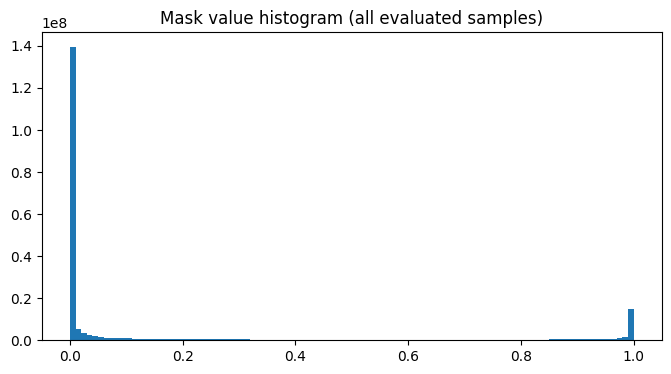

Saved grid to: /content/drive/MyDrive/StegoGAN_fresh/eval/eval_grid.png


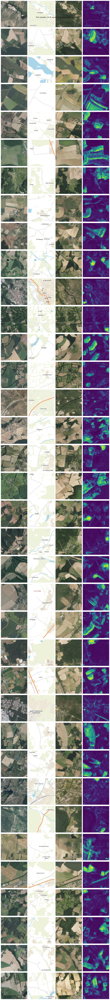

In [ ]:
# ---------- Evaluation / reconstruction-check cell ----------
# Edit these:
DRIVE_RUN_PATH = "/content/drive/MyDrive/StegoGAN_fresh"   # path with checkpoints & samples
SRC_FOLDER = "/content/drive/MyDrive/PlanIGN/trainA"
TGT_FOLDER = "/content/drive/MyDrive/PlanIGN/trainB"
CKPT_FILE = None   # e.g. "/content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep85.pt" or None -> latest
NUM_SAMPLES_TO_EVAL = 200   # number of dataset items to evaluate; set None to run all
OUT_DIR = os.path.join(DRIVE_RUN_PATH, "eval")
os.makedirs(OUT_DIR, exist_ok=True)

# ---------- do not edit below ----------
import os, glob, re, math
from pathlib import Path
import torch, torch.nn as nn, torch.nn.functional as F
from torchvision import transforms, utils as vutils
from PIL import Image
import numpy as np, matplotlib.pyplot as plt
from tqdm.auto import tqdm

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print("Device:", device)

def natural_sort_key(s):
    import re
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg')):
    files=[]
    for e in exts:
        files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

# load simple model definitions (must match training)
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1), nn.Conv2d(dim, dim, 3, padding=0), nn.InstanceNorm2d(dim, affine=False), nn.ReLU(True),
            nn.ReflectionPad2d(1), nn.Conv2d(dim, dim, 3, padding=0), nn.InstanceNorm2d(dim, affine=False)
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec = []
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self, x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# dataset lists
src_files = sorted_files(SRC_FOLDER)
tgt_files = sorted_files(TGT_FOLDER)
if len(src_files)==0 or len(tgt_files)==0:
    raise RuntimeError("Dataset empty — check SRC/TGT paths.")
N = min(len(src_files), NUM_SAMPLES_TO_EVAL) if NUM_SAMPLES_TO_EVAL else len(src_files)
print("Found", len(src_files), "A images; evaluating", N)

# instantiate dummy networks to get z shape
G_Y2X = ResNetGenerator().to(device)
with torch.no_grad():
    d = torch.randn(1,3,256,256).to(device)
    _, z = G_Y2X(d)
in_ch = z.shape[1]
mask_predictor = MaskPredictor(in_ch).to(device)
G_X2Y = ResNetGenerator().to(device)
G_Y2X = ResNetGenerator().to(device)

# load checkpoint
ckpts = []
if CKPT_FILE:
    ckpts = [CKPT_FILE]
else:
    ckpts = sorted(glob.glob(os.path.join(DRIVE_RUN_PATH,"checkpoints","ckpt_ep*.pt")), key=natural_sort_key)
if not ckpts:
    raise RuntimeError("No checkpoint found in drive path.")
ckpt = ckpts[-1]
print("Loading checkpoint:", ckpt)
state = torch.load(ckpt, map_location=device)
for k, mdl in (('G_X2Y', G_X2Y), ('G_Y2X', G_Y2X), ('mask', mask_predictor)):
    if k in state:
        try:
            mdl.load_state_dict(state[k])
            print("Loaded", k)
        except Exception as e:
            print("Warning loading", k, e)

# transforms
tf = transforms.Compose([
    transforms.Resize((256,256), Image.BICUBIC),
    transforms.ToTensor(),
    transforms.Normalize((0.5,)*3,(0.5,)*3)
])
inv_tf = lambda t: ((t.clamp(-1,1)+1)/2).permute(1,2,0).cpu().numpy()

mse = nn.MSELoss(reduction='mean')
mask_vals = []
mse_vals = []
sample_count = 0

# create small grid images for first K samples and save
K_show = min(36, N)
show_images = []

for idx in tqdm(range(N)):
    a_p = src_files[idx]
    b_p = tgt_files[idx] if idx < len(tgt_files) else tgt_files[idx % len(tgt_files)]
    A_img = Image.open(a_p).convert('RGB')
    B_img = Image.open(b_p).convert('RGB')
    A = tf(A_img).unsqueeze(0).to(device)
    B = tf(B_img).unsqueeze(0).to(device)

    with torch.no_grad():
        y_from_A, z_A = G_X2Y(A)
        x_from_B, z_B = G_Y2X(B)
        mask = mask_predictor(z_B)         # shape [1, C, H, W]
        z_unmatch = mask * z_B
        z_match = (1.0 - mask) * z_B
        xgen = G_Y2X.decoder(z_match)     # reconstruct (match only)
        eps = torch.zeros_like(z_unmatch)
        combined = z_A + z_unmatch + eps
        yrec = G_X2Y.decoder(combined)    # reconstruct Y from combined

    # compute MSE between original A and reconstructed from match-only path?
    # The original paper did reconstruction of original type from matched parts; adjust as required.
    # We'll compute reconstruction MSE for A <- decode(G_Y2X.decoder(z_match)) if desired; here compute MSE between x_from_B and xgen
    current_mse = float(mse(x_from_B.detach(), xgen.detach()).item())
    mse_vals.append(current_mse)

    mask_vals.append(mask.detach().cpu().numpy().ravel())

    # save images for visualization for first K
    if idx < K_show:
        a_vis = inv_tf(A[0])
        b_vis = inv_tf(B[0])
        xgen_vis = inv_tf(xgen[0])
        mask_mean = mask.mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_mean, size=(256,256), mode='bilinear', align_corners=False)[0].permute(1,2,0).cpu().numpy()
        show_images.append((a_vis, b_vis, xgen_vis, mask_up))

# aggregate stats
mask_all = np.concatenate(mask_vals, axis=0)
mask_mean_overall = mask_all.mean()
mask_std_overall = mask_all.std()
mse_mean = np.mean(mse_vals); mse_std = np.std(mse_vals)
print(f"Reconstruction MSE (match->gen) mean,std: {mse_mean:.6f}, {mse_std:.6f}")
print(f"Mask mean,std: {mask_mean_overall:.6f}, {mask_std_overall:.6f}")

# plot histogram
plt.figure(figsize=(8,4))
plt.hist(mask_all.flatten(), bins=100)
plt.title("Mask value histogram (all evaluated samples)")
plt.savefig(os.path.join(OUT_DIR, "mask_histogram.png"))
plt.show()

# save a grid of the first K_show samples: A | B | xgen | mask
cols = 4
rows = math.ceil(len(show_images))
fig, axes = plt.subplots(rows, cols, figsize=(cols*3, rows*3))
if rows == 1:
    axes = np.expand_dims(axes, 0)
for r in range(rows):
    for c in range(cols):
        ax = axes[r,c]
        i = r  # we stored each sample as row (A,B,xgen,mask)
        idx_show = r
        if idx_show < len(show_images):
            img_tuple = show_images[idx_show]
            to_plot = img_tuple[c]  # A,B,xgen,mask_up
            ax.imshow(to_plot if to_plot.ndim==3 else to_plot[:,:,0], cmap='gray' if to_plot.ndim==2 else None)
            ax.axis('off')
        else:
            ax.axis('off')
plt.suptitle("First samples: (A, B, xgen(match-only), mask_up)")
plt.tight_layout()
out_grid = os.path.join(OUT_DIR, "eval_grid.png")
plt.savefig(out_grid, dpi=150)
print("Saved grid to:", out_grid)


In [ ]:
# =================== One-cell FID/KID eval on full test set ===================
# Edit these:
DRIVE_RUN_PATH = "/content/drive/MyDrive/StegoGAN_fresh"
CKPT_DIR       = f"{DRIVE_RUN_PATH}/checkpoints"
OUT_BASE       = "/content/gen_cache_full"
TEST_A         = "/content/drive/MyDrive/PlanIGN/testA"   # inputs for A→B
TEST_B         = "/content/drive/MyDrive/PlanIGN/testB"   # real target B
GEN_DIRECTION  = "A2B"   # "A2B" (recommended) or "B2A"
USE_AMP        = False    # keep False for deterministic eval
NUM_WORKERS    = 2

import os, re, glob, shutil, json, time
import torch, torch.nn as nn, torch.nn.functional as F
from torchvision import transforms, utils as vutils
from PIL import Image
from tqdm.auto import tqdm

# ---- helpers ----
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print("Device:", device)

def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def list_images(folder, exts=('png','jpg','jpeg','bmp','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

# ---- model defs (must match training) ----
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec = []
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1),
                    nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self, x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# ---- build, then load latest ckpt ----
G_X2Y = ResNetGenerator().to(device)
G_Y2X = ResNetGenerator().to(device)

# dummy to size mask head
with torch.no_grad():
    d = torch.randn(1,3,256,256, device=device)
    _, z = G_Y2X(d)
mask_predictor = MaskPredictor(z.shape[1]).to(device)

ckpts = sorted(glob.glob(os.path.join(CKPT_DIR, "ckpt_ep*.pt")), key=natural_sort_key)
assert ckpts, "No checkpoints found."
# choose by internal epoch field if present
best = ckpts[-1]
best_epoch = None
for p in reversed(ckpts):
    try:
        st = torch.load(p, map_location='cpu')
        if 'epoch' in st and isinstance(st['epoch'], int):
            if best_epoch is None or st['epoch'] > best_epoch:
                best = p; best_epoch = st['epoch']
    except Exception:
        pass

print("Using checkpoint:", best, "(internal epoch:", best_epoch, ")")
state = torch.load(best, map_location='cpu')
for key, mdl in (('G_X2Y', G_X2Y), ('G_Y2X', G_Y2X), ('mask', mask_predictor)):
    if key in state:
        mdl.load_state_dict(state[key], strict=False)
G_X2Y.to(device).eval(); G_Y2X.to(device).eval(); mask_predictor.to(device).eval()

# ---- dataset (full test) ----
tf = transforms.Compose([
    transforms.Resize((256,256), Image.BICUBIC),
    transforms.ToTensor(),
    transforms.Normalize((0.5,)*3,(0.5,)*3),
])

if GEN_DIRECTION == "A2B":
    inp_files = list_images(TEST_A)
    real_dir  = TEST_B
else:
    inp_files = list_images(TEST_B)
    real_dir  = TEST_A

assert inp_files, f"No images found for inputs: {TEST_A if GEN_DIRECTION=='A2B' else TEST_B}"
N = len(inp_files)
print(f"Generating {N} images for {GEN_DIRECTION} to match real={real_dir}")

# ---- generate full set (N fakes) ----
out_dir = os.path.join(OUT_BASE, f"ep{best_epoch or 'X'}_{GEN_DIRECTION}")
os.makedirs(out_dir, exist_ok=True)
mask_vals = []
with torch.no_grad():
    pbar = tqdm(inp_files, desc="Generating")
    for idx, path in enumerate(pbar):
        im = Image.open(path).convert('RGB')
        x = tf(im).unsqueeze(0).to(device)
        if GEN_DIRECTION == "A2B":
            y, zA = G_X2Y(x)
            # standard output for eval is y
            out = y
        else:
            xB, zB = G_Y2X(x)
            # decode match-only branch to be consistent with training’s xgen
            m = mask_predictor(zB)
            z_match = (1.0 - m) * zB
            out = G_Y2X.decoder(z_match)
            mask_vals.append(float(m.mean().item()))
        y_np = ((out.clamp(-1,1)+1)/2.0).cpu()
        vutils.save_image(y_np, os.path.join(out_dir, f"{idx:05d}.png"))

mask_mean = float(sum(mask_vals)/len(mask_vals)) if mask_vals else float('nan')
print("Mask mean (only meaningful for B2A):", mask_mean)

# ---- compute FID / KID (cleanfid) ----
def compute_fid_kid(gen_dir, real_dir, mode="clean"):
    try:
        # newer split
        from cleanfid import fid as _fid, kid as _kid
        fid_value = _fid.compute_fid(gen_dir, real_dir, mode=mode)
        # kid may be a function or module depending on version
        try:
            kid_mean, kid_std = _kid.compute_kid(gen_dir, real_dir, mode=mode)
        except Exception:
            kid_mean = _kid.compute_kid(gen_dir, real_dir, mode=mode)
            kid_std = float('nan')
    except Exception:
        # older API
        import cleanfid as _fid
        fid_value = _fid.compute_fid(gen_dir, real_dir, mode=mode)
        # KID might live under fid
        if hasattr(_fid, "compute_kid"):
            kid_mean = _fid.compute_kid(gen_dir, real_dir, mode=mode)
            kid_std = float('nan')
        else:
            # try submodule
            from cleanfid import fid as _fid2
            kid_mean = _fid2.compute_kid(gen_dir, real_dir, mode=mode)
            kid_std = float('nan')
    return float(fid_value), float(kid_mean), float(kid_std)

print("compute FID/KID between:")
print("  gen_dir:", out_dir)
print("  real_dir:", real_dir)
fid_val, kid_mean, kid_std = compute_fid_kid(out_dir, real_dir, mode="clean")
print(f"\n>>> FID={fid_val:.2f}   KID={kid_mean:.4f}", end="")
if not (kid_std != kid_std):  # not NaN
    print(f" ± {kid_std:.4f}")
else:
    print()

# save tiny summary
summary = {
    "epoch": best_epoch,
    "gen_direction": GEN_DIRECTION,
    "gen_dir": out_dir,
    "real_dir": real_dir,
    "fid": fid_val,
    "kid_mean": kid_mean,
    "kid_std": kid_std,
    "mask_mean": mask_mean,
    "timestamp": int(time.time())
}
os.makedirs(f"{DRIVE_RUN_PATH}/eval", exist_ok=True)
with open(f"{DRIVE_RUN_PATH}/eval/fidkid_ep{best_epoch or 'X'}_{GEN_DIRECTION}.json","w") as f:
    json.dump(summary, f, indent=2)
print("\nSaved summary to", f"{DRIVE_RUN_PATH}/eval/fidkid_ep{best_epoch or 'X'}_{GEN_DIRECTION}.json")
# =============================================================================


Device: cuda
Using checkpoint: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep152.pt (internal epoch: 152 )


OSError: [Errno 107] Transport endpoint is not connected: '/content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep152.pt'

In [ ]:
# ==== Clean remount (only when Drive glitches) ====
from google.colab import drive
try:
    drive.flush_and_unmount()
except Exception:
    pass

!fusermount -u /content/drive 2>/dev/null || true
!rm -rf /content/drive
drive.mount('/content/drive', force_remount=True)


Mounted at /content/drive


In [ ]:
import os, time, shutil, subprocess, glob, re, torch

# ---------- helpers ----------
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def _copy_to_local(src_path, dst_path, tries=3, sleep_s=2):
    os.makedirs(os.path.dirname(dst_path), exist_ok=True)
    last_err = None
    for t in range(tries):
        # try Python copy
        try:
            shutil.copy2(src_path, dst_path)
            if os.path.getsize(dst_path) > 0:
                return dst_path
        except Exception as e:
            last_err = e
        # fallback to shell copy (sometimes more resilient with Drive)
        try:
            subprocess.run(["cp", "-f", src_path, dst_path], check=True)
            if os.path.getsize(dst_path) > 0:
                return dst_path
        except Exception as e:
            last_err = e
        time.sleep(sleep_s * (t+1))
    raise OSError(f"Failed to copy {src_path} to {dst_path}. Last error: {last_err}")

def safe_load_ckpt(drive_path, map_location="cpu"):
    """
    Copy ckpt from Drive to local cache, then load locally to avoid FUSE errors.
    """
    local_tmp = f"/content/_ckpt_cache/{os.path.basename(drive_path)}"
    local_path = _copy_to_local(drive_path, local_tmp)
    return torch.load(local_path, map_location=map_location)

def robust_save_checkpoint(state, epoch, drive_dir, local_backup="/content/ckpts_backup"):
    """
    Save locally first, try copying to Drive, keep a local backup if Drive copy fails.
    """
    os.makedirs(local_backup, exist_ok=True)
    os.makedirs(drive_dir, exist_ok=True)
    local_tmp = os.path.join("/content", f"ckpt_ep{epoch}.pt")
    final_local = os.path.join(local_backup, f"ckpt_ep{epoch}.pt")
    drive_dst  = os.path.join(drive_dir, f"ckpt_ep{epoch}.pt")
    try:
        torch.save(state, local_tmp)
    except Exception:
        # fallback: save directly to backup
        torch.save(state, final_local)
        return False, final_local
    # try to send to Drive
    try:
        shutil.copy(local_tmp, drive_dst)
        os.remove(local_tmp)
        return True, drive_dst
    except Exception:
        # keep local backup if Drive copy fails
        shutil.move(local_tmp, final_local)
        return False, final_local


In [ ]:
CKPT_DIR = "/content/drive/MyDrive/StegoGAN_fresh/checkpoints"

# find latest by internal 'epoch' (preferred), else by filename
ckpts = sorted(glob.glob(os.path.join(CKPT_DIR, "ckpt_ep*.pt")), key=natural_sort_key)
assert ckpts, "No checkpoints found."
candidates = []
for f in ckpts:
    try:
        st = safe_load_ckpt(f, map_location="cpu")  # load from local cache
        ep = int(st.get("epoch", 0))
    except Exception:
        ep = None
    mtime = os.path.getmtime(f)
    candidates.append((f, ep, mtime))

with_internal = [c for c in candidates if isinstance(c[1], int)]
best = max(with_internal, key=lambda x: x[1])[0] if with_internal else max(candidates, key=lambda x: x[2])[0]
print("Using checkpoint:", best)

# now actually load your models from the state dict
state = safe_load_ckpt(best, map_location="cpu")
for key, mdl in (("G_X2Y", G_X2Y), ("G_Y2X", G_Y2X), ("D_X", D_X), ("D_Y", D_Y), ("mask", mask_predictor)):
    if key in state:
        mdl.load_state_dict(state[key], strict=False)


Using checkpoint: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep152.pt


NameError: name 'D_X' is not defined

In [ ]:
# load the state with the safe loader you already defined
state = safe_load_ckpt(best, map_location="cpu")

for key, mdl in (("G_X2Y", G_X2Y), ("G_Y2X", G_Y2X), ("mask", mask_predictor)):
    if key in state:
        mdl.load_state_dict(state[key], strict=False)
    else:
        print(f"[warn] {key} not found in checkpoint")


In [ ]:
# ======================= CONFIG (edit these) =======================
CKPT_DIR   = "/content/_ckpt_cache"  # folder with ckpt_ep*.pt you copied locally
TEST_B_DIR = "/content/drive/MyDrive/PlanIGN/testB"      # your testB folder (real targets)
OUT_ROOT   = "/content/drive/MyDrive/StegoGAN_fresh/eval_runs"          # where to write generated images & logs

# pick a specific checkpoint (full path) or leave None to auto-pick the latest by epoch
BEST_CKPT  = None
BATCH_SIZE = 8
IMG_SIZE   = 256
NUM_WORKERS = 2
# ================================================================

import os, re, glob, math, json, shutil
from pathlib import Path
import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from PIL import Image
from tqdm.auto import tqdm
import numpy as np

# --------------------- device ---------------------
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Device:", device)

# --------------------- utils ----------------------
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def find_latest_ckpt(ckpt_dir):
    ckpts = sorted(glob.glob(os.path.join(ckpt_dir, "ckpt_ep*.pt")), key=natural_sort_key)
    if not ckpts:
        raise FileNotFoundError(f"No checkpoints found in {ckpt_dir}")
    # prefer highest epoch embedded in state if available, else highest filename epoch
    best = ckpts[-1]
    try:
        st = torch.load(best, map_location="cpu")
        e_best = int(st.get("epoch", 0))
        # scan for max internal epoch
        cand = []
        for p in ckpts:
            try:
                e = int(torch.load(p, map_location="cpu").get("epoch", -1))
            except Exception:
                e = -1
            cand.append((e, p))
        cand = [x for x in cand if x[0] >= 0]
        if cand:
            best = max(cand, key=lambda x: x[0])[1]
    except Exception:
        pass
    return best

def safe_load_ckpt(path, map_location="cpu"):
    # robust torch.load (helps with occasional FS errors)
    for i in range(3):
        try:
            return torch.load(path, map_location=map_location)
        except Exception as e:
            if i == 2:
                raise
            print(f"[warn] load retry {i+1}/3 for {path}: {e}")

# --------------------- models (eval-only) ----------------------
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec = []
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1),
                    nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self, x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# --------------------- dataset ----------------------
class FolderDataset(Dataset):
    def __init__(self, folder, size):
        self.paths = sorted(glob.glob(os.path.join(folder, "*.*")), key=natural_sort_key)
        if not self.paths:
            raise FileNotFoundError(f"No images found in {folder}")
        self.tf = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),                                  # [0,1]
            transforms.Normalize((0.5,)*3, (0.5,)*3)                # [-1,1]
        ])
    def __len__(self): return len(self.paths)
    def __getitem__(self, idx):
        im = Image.open(self.paths[idx]).convert("RGB")
        return self.tf(im), self.paths[idx]

# ------------------- clean-fid wrapper -------------------
def compute_fid_kid(gen_dir, real_dir, mode="clean"):
    """
    Works with multiple clean-fid versions. Returns (fid, kid_mean).
    (Some versions don't expose kid std or separate module.)
    """
    try:
        from cleanfid import fid as _fid, features
        # FID
        fid_value = _fid.compute_fid(gen_dir, real_dir, mode=mode)
        # try to get KID
        if hasattr(_fid, "compute_kid"):
            kid = _fid.compute_kid(gen_dir, real_dir, mode=mode)
            if isinstance(kid, (list, tuple)) and len(kid) >= 1:
                kid_mean = float(kid[0])
            else:
                kid_mean = float(kid)
        else:
            # fallback: no kid in this version
            kid_mean = float("nan")
        return float(fid_value), kid_mean
    except Exception as e:
        print("[warn] clean-fid KID not available:", e)
        # still try FID via the top-level API (older version)
        try:
            import cleanfid
            fid_value = cleanfid.compute_fid(gen_dir, real_dir, mode=mode)
            return float(fid_value), float("nan")
        except Exception as e2:
            print("[error] clean-fid not working:", e2)
            return float("nan"), float("nan")

# ------------------- build models & load ckpt -------------------
# instantiate to infer z channels for mask
G_X2Y = ResNetGenerator(3,3,ngf=64, n_blocks=6).to(device)
G_Y2X = ResNetGenerator(3,3,ngf=64, n_blocks=6).to(device)
with torch.no_grad():
    d = torch.randn(1,3,IMG_SIZE,IMG_SIZE, device=device)
    _, z = G_Y2X(d)
mask_predictor = MaskPredictor(in_ch=z.shape[1]).to(device)

if BEST_CKPT is None:
    BEST_CKPT = find_latest_ckpt(CKPT_DIR)
print("Using checkpoint:", BEST_CKPT)

state = safe_load_ckpt(BEST_CKPT, map_location="cpu")
for key, mdl in (("G_X2Y", G_X2Y), ("G_Y2X", G_Y2X), ("mask", mask_predictor)):
    if key in state:
        mdl.load_state_dict(state[key], strict=False)
    else:
        print(f"[warn] key '{key}' not in checkpoint (ok for eval if you don't use it)")

G_X2Y.to(device).eval()
G_Y2X.to(device).eval()
mask_predictor.to(device).eval()

# ------------------- generate & score -------------------
ds  = FolderDataset(TEST_B_DIR, IMG_SIZE)
dl  = DataLoader(ds, batch_size=BATCH_SIZE, shuffle=False,
                 num_workers=NUM_WORKERS, pin_memory=True)

# create output folder for this ckpt
ep = re.search(r"ckpt_ep(\d+)\.pt", os.path.basename(BEST_CKPT))
ep_str = ep.group(1) if ep else "X"
RUN_DIR  = os.path.join(OUT_ROOT, f"ep{ep_str}")
IMG_DIR  = os.path.join(RUN_DIR, "gen")
os.makedirs(IMG_DIR, exist_ok=True)

rmse_acc = []
with torch.no_grad():
    for batch, paths in tqdm(dl, desc="Generating"):
        B = batch.to(device, non_blocking=True).float()    # [-1,1], ensure float32
        # forward B side
        x_from_B, z_B  = G_Y2X(B)
        mask           = mask_predictor(z_B)
        z_match        = (1.0 - mask) * z_B
        xgen           = G_Y2X.decoder(z_match)

        # save generated (xgen) as [0,1]
        imgs = ((xgen.clamp(-1,1) + 1) / 2.0).cpu()
        for img, p in zip(imgs, paths):
            fn = os.path.splitext(os.path.basename(p))[0] + ".png"
            vutils.save_image(img, os.path.join(IMG_DIR, fn))

        # rmse between x_from_B and xgen (0..1)
        x1 = ((x_from_B.clamp(-1,1)+1)/2.0).cpu().numpy()
        x2 = ((xgen.clamp(-1,1)+1)/2.0).cpu().numpy()
        rmse = float(np.sqrt(np.mean((x1 - x2)**2)))
        rmse_acc.append(rmse)

rmse_mean = float(np.mean(rmse_acc)) if rmse_acc else float("nan")

# compute FID/KID against real testB
fid, kid = compute_fid_kid(IMG_DIR, TEST_B_DIR, mode="clean")
print(f"\nResults for ep{ep_str}:  FID={fid:.2f}   KID={kid:.4f}   RMSE={rmse_mean:.6f}")

# save a small grid preview of the last batch (A=B? We show: B (real), x_from_B, xgen, mask)
# Re-run one tiny batch for the grid
with torch.no_grad():
    B, paths = next(iter(dl))
    B = B.to(device).float()
    x_from_B, z_B  = G_Y2X(B)
    mask           = mask_predictor(z_B)
    z_match        = (1.0 - mask) * z_B
    xgen           = G_Y2X.decoder(z_match)

    vis_B   = ((B.clamp(-1,1) + 1)/2.0).cpu()
    vis_xfb = ((x_from_B.clamp(-1,1) + 1)/2.0).cpu()
    vis_xg  = ((xgen.clamp(-1,1) + 1)/2.0).cpu()
    mask_m  = mask.mean(dim=1, keepdim=True)
    mask_up = F.interpolate(mask_m, size=(IMG_SIZE,IMG_SIZE), mode="bilinear", align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)

    grid = vutils.make_grid(torch.cat([vis_B[:8], vis_xfb[:8], vis_xg[:8], mask_up[:8]], dim=0), nrow=8)
    os.makedirs(RUN_DIR, exist_ok=True)
    vutils.save_image(grid, os.path.join(RUN_DIR, "preview_grid.png"))

# dump metrics
os.makedirs(RUN_DIR, exist_ok=True)
with open(os.path.join(RUN_DIR, "metrics.json"), "w") as f:
    json.dump({"epoch": ep_str, "fid": fid, "kid": kid, "rmse": rmse_mean}, f, indent=2)

print(f"\nSaved images -> {IMG_DIR}")
print(f"Saved preview -> {os.path.join(RUN_DIR, 'preview_grid.png')}")
print(f"Saved metrics -> {os.path.join(RUN_DIR, 'metrics.json')}")


Device: cuda
Using checkpoint: /content/_ckpt_cache/ckpt_ep152.pt


Generating:   0%|          | 0/113 [00:00<?, ?it/s]

/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


compute FID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_runs/ep152/gen


FID gen : 100%|██████████| 29/29 [00:15<00:00,  1.85it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB


FID testB : 100%|██████████| 29/29 [00:12<00:00,  2.26it/s]


compute KID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_runs/ep152/gen


KID gen : 100%|██████████| 29/29 [00:14<00:00,  1.94it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB


KID testB : 100%|██████████| 29/29 [00:13<00:00,  2.21it/s]



Results for ep152:  FID=276.17   KID=0.2662   RMSE=0.027181

Saved images -> /content/drive/MyDrive/StegoGAN_fresh/eval_runs/ep152/gen
Saved preview -> /content/drive/MyDrive/StegoGAN_fresh/eval_runs/ep152/preview_grid.png
Saved metrics -> /content/drive/MyDrive/StegoGAN_fresh/eval_runs/ep152/metrics.json


In [ ]:
!pip install pytorch-fid


In [ ]:
from pytorch_fid import fid_score
fid_value = fid_score.calculate_fid_given_paths([gen_dir, real_dir], batch_size=50, device=device, dims=2048)


NameError: name 'gen_dir' is not defined

In [ ]:
!git clone https://github.com/GaParmar/clean-fid.git
%cd clean-fid
!pip install .
%cd ..


Cloning into 'clean-fid'...
remote: Enumerating objects: 1160, done.
remote: Counting objects: 100% (239/239), done.
remote: Compressing objects: 100% (82/82), done.
remote: Total 1160 (delta 169), reused 214 (delta 157), pack-reused 921 (from 1)
Receiving objects: 100% (1160/1160), 4.73 MiB | 9.55 MiB/s, done.
Resolving deltas: 100% (716/716), done.
/content/clean-fid
Processing /content/clean-fid
  Preparing metadata (setup.py) ... done
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-install-gbqsae0a/clip_76468981408b450d8e7b15e47ff45fb6
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-install-gbqsae0a/clip_76468981408b450d8e7b15e47ff45fb6
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.8 MB/s eta 0:00:00
  Created wheel for clean-fid: filename=clean_fid-0.1.35-py3-none-any.whl s

In [ ]:
# %%capture
# If running in Colab, install deps once:
# !pip -q install clean-fid==0.1.35 torch-fidelity==0.3.0 opencv-python-headless==4.10.0.84

# ================== CONFIG ==================
DRIVE_RUN_PATH = "/content/drive/MyDrive/StegoGAN_fresh"
CKPT_DIR       = f"{DRIVE_RUN_PATH}/checkpoints"

TEST_A = "/content/drive/MyDrive/PlanIGN/testA"   # satellite inputs
TEST_B = "/content/drive/MyDrive/PlanIGN/testB"   # map ground truth

OUT_ROOT = f"{DRIVE_RUN_PATH}/eval_batch_A2B_1"     # where results go

EPOCHS_TO_EVAL = [175, 180, 185, 190, 200]        # <-- requested list
IMG_SIZE       = 256
BATCH          = 16
N_WORKERS      = 0                                 # 0 is safest with Drive
SIGMAS         = (2, 4)                            # px for edge accuracy
PREVIEW_N      = 12                                # preview rows (A,GT,Gen) x N
USE_FULL_SET   = True                              # True: use all pairs; False: subsample below
SUBSAMPLE_N    = 256                               # only used if USE_FULL_SET=False
# ============================================

import os, re, glob, json, time, warnings
warnings.filterwarnings("ignore")
import numpy as np
from PIL import Image
from tqdm.auto import tqdm

import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from scipy.ndimage import distance_transform_edt as edt

# metrics libs
from cleanfid import fid as _fid
try:
    from cleanfid import kid as _kid
except Exception:
    _kid = None

from torch_fidelity import calculate_metrics as tf_calculate_metrics
import cv2

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Device:", device)

# ----------------- helpers -----------------
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def to01(x): return (x.clamp(-1,1)+1)/2
def rmse_01(pred, gt): return torch.sqrt(F.mse_loss(pred, gt))

def canny_edges(img01):
    g = (img01*255).astype(np.uint8)
    g = cv2.cvtColor(g, cv2.COLOR_RGB2GRAY)
    g = cv2.GaussianBlur(g, (3,3), 0)
    edges = cv2.Canny(g, 80, 160)
    return (edges>0).astype(np.uint8)

def acc_sigma(pred01, gt01, sigma_px):
    e_pred = canny_edges(pred01)
    e_gt   = canny_edges(gt01)
    if e_pred.sum()==0 and e_gt.sum()==0: return 1.0
    if e_pred.sum()==0: return 0.0
    dist = edt(1 - e_gt)
    close = dist[e_pred==1] <= sigma_px
    return float(close.mean()) if close.size>0 else 0.0

def compute_cleanfid(gen_dir, real_dir, mode="clean"):
    fid_v = _fid.compute_fid(gen_dir, real_dir, mode=mode)
    kid_m = float("nan")
    try:
        if _kid is not None:
            km = _kid.compute_kid(gen_dir, real_dir, mode=mode)
            kid_m = float(km[0] if isinstance(km,(list,tuple)) else km)
        else:
            km = _fid.compute_kid(gen_dir, real_dir, mode=mode)
            kid_m = float(km[0] if isinstance(km,(list,tuple)) else km)
    except Exception:
        kid_m = float("nan")
    return float(fid_v), float(kid_m)

def compute_torch_fidelity(gen_dir, real_dir, cuda=torch.cuda.is_available()):
    m = tf_calculate_metrics(
        input1=gen_dir, input2=real_dir,
        fid=True, kid=True,
        feature_layer_fid="2048",
        kid_subsets=50,                # number of random subsets
        kid_subset_size=min(256, len(os.listdir(gen_dir))),  # <= your dataset size
        verbose=False, cuda=cuda
    )
    return float(m['frechet_inception_distance']), float(m['kernel_inception_distance_mean'])


# ----------------- models (match training) -----------------
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    # same layout used during training: encoder/decoder, returns (out, z)
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec = []
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self, x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

# ----------------- data -----------------
A_all = sorted_files(TEST_A)
B_all = sorted_files(TEST_B)
A_dict = {extract_id(p): p for p in A_all}
B_dict = {extract_id(p): p for p in B_all}
common_ids = sorted(set(A_dict.keys()) & set(B_dict.keys()), key=natural_sort_key)
if not USE_FULL_SET:
    common_ids = common_ids[:SUBSAMPLE_N]
pairs = [(A_dict[i], B_dict[i], i) for i in common_ids]
print(f"Found {len(pairs)} matching test pairs.")

class PairDataset(Dataset):
    def __init__(self, pairs, size):
        self.pairs = pairs; self.size=size
        self.tfA = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
        self.tfB = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor()
        ])
    def __len__(self): return len(self.pairs)
    def __getitem__(self, idx):
        a_path, b_path, id_str = self.pairs[idx]
        A = Image.open(a_path).convert('RGB')
        B = Image.open(b_path).convert('RGB')
        return {'A': self.tfA(A), 'B': self.tfB(B), 'id': id_str}

ds = PairDataset(pairs, IMG_SIZE)
dl = DataLoader(ds, batch_size=BATCH, shuffle=False, num_workers=N_WORKERS, drop_last=False)

# ----------------- main loop over epochs -----------------
os.makedirs(OUT_ROOT, exist_ok=True)
summary_rows = []

for ep in EPOCHS_TO_EVAL:
    ckpt_path = os.path.join(CKPT_DIR, f"ckpt_ep{ep}.pt")
    if not os.path.exists(ckpt_path):
        print(f"[skip] ckpt not found: {ckpt_path}")
        continue

    # load G_X2Y
    G_X2Y = ResNetGenerator().to(device)
    state = torch.load(ckpt_path, map_location=device)
    if 'G_X2Y' in state:
        G_X2Y.load_state_dict(state['G_X2Y'], strict=False)
    else:
        # fallback if the state dict is flat
        G_X2Y.load_state_dict(state, strict=False)
    G_X2Y.eval()
    print(f"\n=== Epoch {ep} ===  (loaded {os.path.basename(ckpt_path)})")

    out_ep  = os.path.join(OUT_ROOT, f"ep{ep}")
    gen_dir = os.path.join(out_ep, "gen")
    os.makedirs(gen_dir, exist_ok=True)

    # generate
    rmse_list, acc2_list, acc4_list = [], [], []
    saved_paths = []

    with torch.no_grad():
        pbar = tqdm(dl, desc=f"[ep{ep}] generate A->B")
        for batch in pbar:
            A = batch['A'].to(device)
            B = batch['B'].to(device)
            ids = batch['id']

            Y, _ = G_X2Y(A)                 # [-1,1]
            Y01  = to01(Y).cpu()            # [0,1]
            B01  = B.cpu()

            # save with test ID
            for i in range(Y01.size(0)):
                y_np = (Y01[i].clamp(0,1).numpy()*255).astype(np.uint8)
                y_np = np.transpose(y_np, (1,2,0))
                p = os.path.join(gen_dir, f"{ids[i]}.png")
                Image.fromarray(y_np).save(p)
                saved_paths.append(p)

            # batch metrics
            rmse_list.append(float(rmse_01(Y01, B01).item()))
            Ynp = np.transpose(Y01.numpy(), (0,2,3,1))
            Bnp = np.transpose(B01.numpy(), (0,2,3,1))
            for k in range(Ynp.shape[0]):
                acc2_list.append(acc_sigma(Ynp[k], Bnp[k], SIGMAS[0]))
                acc4_list.append(acc_sigma(Ynp[k], Bnp[k], SIGMAS[1]))

    print(f"Generated {len(saved_paths)} images → {gen_dir}")

    # make preview grid
    try:
        sel_ids = [extract_id(p) for p in saved_paths[:PREVIEW_N]]
        tiles=[]
        for sid in sel_ids:
            a_img = Image.open(A_dict[sid]).convert('RGB').resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC)
            b_img = Image.open(B_dict[sid]).convert('RGB').resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC)
            g_img = Image.open(os.path.join(gen_dir, f"{sid}.png")).convert('RGB')
            tiles += [a_img, b_img, g_img]
        grid = vutils.make_grid(torch.stack([transforms.ToTensor()(im) for im in tiles]), nrow=3)
        vutils.save_image(grid, os.path.join(out_ep, "preview_grid.png"))
    except Exception as e:
        print(f"[ep{ep}] preview save failed:", e)

    # metrics: clean-fid
    fid_cf, kid_cf = compute_cleanfid(gen_dir, TEST_B, mode="clean")
    # metrics: torch-fidelity
    fid_tf, kid_tf = compute_torch_fidelity(gen_dir, TEST_B, cuda=torch.cuda.is_available())

    row = {
        "epoch": ep,
        "pairs": len(saved_paths),
        "fid_cleanfid": fid_cf,
        "kid_cleanfid": kid_cf,
        "kid_cleanfid_x100": (None if np.isnan(kid_cf) else kid_cf*100.0),
        "fid_torch_fidelity": fid_tf,
        "kid_torch_fidelity": kid_tf,
        "kid_torch_fidelity_x100": kid_tf*100.0,
        "rmse_mean": float(np.mean(rmse_list)),
        f"acc_sigma{SIGMAS[0]}_mean": float(np.mean(acc2_list)),
        f"acc_sigma{SIGMAS[1]}_mean": float(np.mean(acc4_list)),
        "gen_dir": gen_dir
    }
    with open(os.path.join(out_ep, "metrics.json"), "w") as f:
        json.dump(row, f, indent=2)

    summary_rows.append(row)

# ---------- print/save summary ----------
import pandas as pd
df = pd.DataFrame(summary_rows).sort_values("fid_cleanfid")
csv_path = os.path.join(OUT_ROOT, "summary_A2B_epochs.csv")
df.to_csv(csv_path, index=False)
print("\nSaved summary →", csv_path)
print(df.to_string(index=False))


Device: cuda
Found 900 matching test pairs.


ModuleNotFoundError: No module named 'torch.utils.serialization'

In [ ]:
# ================= INSTALL ALL REQUIRED LIBRARIES =================
!pip install --quiet \
  torch torchvision torchaudio \
  numpy pandas pillow tqdm opencv-python-headless \
  clean-fid==0.1.35 torch-fidelity==0.3.0 \
  scipy==1.13.0 matplotlib==3.9.0
# ================================================================

# Optional sanity check (run after install)
import torch, torchvision, cleanfid, torch_fidelity, cv2, PIL, tqdm, numpy, pandas, scipy
print("✅ All libraries imported successfully.")
print("Torch version:", torch.__version__)
print("CleanFID version:", cleanfid.__version__)
print("Torch-Fidelity version:", torch_fidelity.__version__)


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.2/38.2 MB 41.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 96.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.9/887.9 MB 840.2 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 594.3/594.3 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 102.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.0/88.0 MB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 954.8/954.8 kB 68.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 706.8/706.8 MB 697.1 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.1/193.1 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 32.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.6/63.6 MB 13.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 267.

AttributeError: module 'sympy' has no attribute 'core'

In [ ]:
# ================= SAFE CLEAN INSTALL =================
!pip uninstall -y sympy scipy clean-fid torch-fidelity opencv-python-headless
!pip install --quiet \
  sympy==1.12 \
  scipy==1.14.0 \
  clean-fid==0.1.35 \
  torch-fidelity==0.3.0 \
  opencv-python-headless==4.10.0.84 \
  tqdm numpy pandas pillow matplotlib
# ======================================================

# ✅ Verify everything loads cleanly
import torch, torchvision, cleanfid, torch_fidelity, cv2, PIL, tqdm, numpy, pandas, scipy, sympy
print("✅ All imports successful.")
print("Torch:", torch.__version__)
print("Clean-FID:", cleanfid.__version__)
print("Torch-Fidelity:", torch_fidelity.__version__)
print("Sympy:", sympy.__version__)
print("Scipy:", scipy.__version__)


Found existing installation: sympy 1.14.0
Uninstalling sympy-1.14.0:
  Successfully uninstalled sympy-1.14.0
Found existing installation: scipy 1.13.0
Uninstalling scipy-1.13.0:
  Successfully uninstalled scipy-1.13.0
Found existing installation: clean-fid 0.1.35
Uninstalling clean-fid-0.1.35:
  Successfully uninstalled clean-fid-0.1.35
Found existing installation: torch-fidelity 0.3.0
Uninstalling torch-fidelity-0.3.0:
  Successfully uninstalled torch-fidelity-0.3.0
Found existing installation: opencv-python-headless 4.10.0.84
Uninstalling opencv-python-headless-4.10.0.84:
  Successfully uninstalled opencv-python-headless-4.10.0.84
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 kB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.7/5.7 MB 65.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.8/40.8 MB 13.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 797.0/797.0 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

AttributeError: type object 'GuardSource' has no attribute 'LOCAL_NN_MODULE'

In [ ]:
# 🧹 remove the conflicting audio pkg we don't use
!pip uninstall -y torchaudio

# 📦 align deps + reinstall eval libs
!pip install -q --upgrade pip
!pip install -q \
  "torchvision==0.19.1" \
  "sympy==1.12" \
  "scipy==1.14.0" \
  "cleanfid==0.1.35" \
  "torch-fidelity==0.3.0" \
  "opencv-python-headless==4.10.0.84" \
  tqdm numpy pandas pillow packaging

# ✅ sanity check
python - << 'PY'
import torch, torchvision, cleanfid, torch_fidelity, cv2, numpy, pandas, scipy, sympy
print("Torch        :", torch.__version__)
print("TorchVision  :", torchvision.__version__)
print("Clean-FID    :", cleanfid.__version__)
print("Torch-Fid    :", torch_fidelity.__version__)
print("Sympy        :", sympy.__version__)
print("Scipy        :", scipy.__version__)
print("OpenCV       :", cv2.__version__)
PY


SyntaxError: invalid syntax (ipython-input-3915270433.py, line 9)

In [ ]:
# 🧹 Clean up old torch packages and reinstall compatible ones
!pip uninstall -y torch torchvision torchaudio sympy
!pip install -q torch==2.4.1 torchvision==0.19.1 --index-url https://download.pytorch.org/whl/cu121

# 🧩 Install all needed libraries for your eval script
!pip install -q clean-fid==0.1.35 torch-fidelity==0.3.0 opencv-python-headless==4.10.0.84 tqdm numpy pandas pillow scipy==1.14.0 sympy==1.12 packaging

# ✅ Verify
import torch, torchvision, cleanfid, torch_fidelity, cv2, numpy, pandas, scipy, sympy
print("✅ All OK")
print("Torch:", torch.__version__, "| TorchVision:", torchvision.__version__)


Found existing installation: torch 2.4.1
Uninstalling torch-2.4.1:
  Successfully uninstalled torch-2.4.1
Found existing installation: torchvision 0.19.1
Uninstalling torchvision-0.19.1:
  Successfully uninstalled torchvision-0.19.1
Found existing installation: torchaudio 2.8.0
Uninstalling torchaudio-2.8.0:
  Successfully uninstalled torchaudio-2.8.0
Found existing installation: sympy 1.12
Uninstalling sympy-1.12:
  Successfully uninstalled sympy-1.12
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 798.9/798.9 MB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.1/7.1 MB 119.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.2/6.2 MB 118.2 MB/s eta 0:00:00
✅ All OK
Torch: 2.8.0+cu126 | TorchVision: 0.19.1+cu121


In [ ]:
# %%capture
# If running in Colab, install deps once:
# !pip -q install clean-fid==0.1.35 torch-fidelity==0.3.0 opencv-python-headless==4.10.0.84

# ================== CONFIG ==================
DRIVE_RUN_PATH = "/content/drive/MyDrive/StegoGAN_fresh"
CKPT_DIR       = f"{DRIVE_RUN_PATH}/checkpoints"

TEST_A = "/content/drive/MyDrive/PlanIGN/testA"   # satellite inputs
TEST_B = "/content/drive/MyDrive/PlanIGN/testB_TU"   # map ground truth

OUT_ROOT = f"{DRIVE_RUN_PATH}/eval_batch_A2B_3"     # where results go

EPOCHS_TO_EVAL = [175,177,180,183,185,187,190]       # <-- requested list
IMG_SIZE       = 256
BATCH          = 16
N_WORKERS      = 0                                 # 0 is safest with Drive
SIGMAS         = (2, 4)                            # px for edge accuracy
PREVIEW_N      = 12                                # preview rows (A,GT,Gen) x N
USE_FULL_SET   = True                              # True: use all pairs; False: subsample below
SUBSAMPLE_N    = 256                               # only used if USE_FULL_SET=False
# ============================================

import os, re, glob, json, time, warnings
warnings.filterwarnings("ignore")
import numpy as np
from PIL import Image
from tqdm.auto import tqdm

import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from scipy.ndimage import distance_transform_edt as edt

# metrics libs
from cleanfid import fid as _fid
try:
    from cleanfid import kid as _kid
except Exception:
    _kid = None

from torch_fidelity import calculate_metrics as tf_calculate_metrics
import cv2

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Device:", device)

# ----------------- helpers -----------------
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def to01(x): return (x.clamp(-1,1)+1)/2
def rmse_01(pred, gt): return torch.sqrt(F.mse_loss(pred, gt))

def canny_edges(img01):
    g = (img01*255).astype(np.uint8)
    g = cv2.cvtColor(g, cv2.COLOR_RGB2GRAY)
    g = cv2.GaussianBlur(g, (3,3), 0)
    edges = cv2.Canny(g, 80, 160)
    return (edges>0).astype(np.uint8)

def acc_sigma(pred01, gt01, sigma_px):
    e_pred = canny_edges(pred01)
    e_gt   = canny_edges(gt01)
    if e_pred.sum()==0 and e_gt.sum()==0: return 1.0
    if e_pred.sum()==0: return 0.0
    dist = edt(1 - e_gt)
    close = dist[e_pred==1] <= sigma_px
    return float(close.mean()) if close.size>0 else 0.0

def compute_cleanfid(gen_dir, real_dir, mode="clean"):
    fid_v = _fid.compute_fid(gen_dir, real_dir, mode=mode)
    kid_m = float("nan")
    try:
        if _kid is not None:
            km = _kid.compute_kid(gen_dir, real_dir, mode=mode)
            kid_m = float(km[0] if isinstance(km,(list,tuple)) else km)
        else:
            km = _fid.compute_kid(gen_dir, real_dir, mode=mode)
            kid_m = float(km[0] if isinstance(km,(list,tuple)) else km)
    except Exception:
        kid_m = float("nan")
    return float(fid_v), float(kid_m)

def compute_torch_fidelity(gen_dir, real_dir, cuda=torch.cuda.is_available()):
    m = tf_calculate_metrics(
        input1=gen_dir, input2=real_dir,
        fid=True, kid=True,
        feature_layer_fid="2048",
        kid_subsets=50,                # number of random subsets
        kid_subset_size=min(256, len(os.listdir(gen_dir))),  # <= your dataset size
        verbose=False, cuda=cuda
    )
    return float(m['frechet_inception_distance']), float(m['kernel_inception_distance_mean'])


# ----------------- models (match training) -----------------
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    # same layout used during training: encoder/decoder, returns (out, z)
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec = []
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self, x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

# ----------------- data -----------------
A_all = sorted_files(TEST_A)
B_all = sorted_files(TEST_B)
A_dict = {extract_id(p): p for p in A_all}
B_dict = {extract_id(p): p for p in B_all}
common_ids = sorted(set(A_dict.keys()) & set(B_dict.keys()), key=natural_sort_key)
if not USE_FULL_SET:
    common_ids = common_ids[:SUBSAMPLE_N]
pairs = [(A_dict[i], B_dict[i], i) for i in common_ids]
print(f"Found {len(pairs)} matching test pairs.")

class PairDataset(Dataset):
    def __init__(self, pairs, size):
        self.pairs = pairs; self.size=size
        self.tfA = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
        self.tfB = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor()
        ])
    def __len__(self): return len(self.pairs)
    def __getitem__(self, idx):
        a_path, b_path, id_str = self.pairs[idx]
        A = Image.open(a_path).convert('RGB')
        B = Image.open(b_path).convert('RGB')
        return {'A': self.tfA(A), 'B': self.tfB(B), 'id': id_str}

ds = PairDataset(pairs, IMG_SIZE)
dl = DataLoader(ds, batch_size=BATCH, shuffle=False, num_workers=N_WORKERS, drop_last=False)

# ----------------- main loop over epochs -----------------
os.makedirs(OUT_ROOT, exist_ok=True)
summary_rows = []

for ep in EPOCHS_TO_EVAL:
    ckpt_path = os.path.join(CKPT_DIR, f"ckpt_ep{ep}.pt")
    if not os.path.exists(ckpt_path):
        print(f"[skip] ckpt not found: {ckpt_path}")
        continue

    # load G_X2Y
    G_X2Y = ResNetGenerator().to(device)
    state = torch.load(ckpt_path, map_location=device)
    if 'G_X2Y' in state:
        G_X2Y.load_state_dict(state['G_X2Y'], strict=False)
    else:
        # fallback if the state dict is flat
        G_X2Y.load_state_dict(state, strict=False)
    G_X2Y.eval()
    print(f"\n=== Epoch {ep} ===  (loaded {os.path.basename(ckpt_path)})")

    out_ep  = os.path.join(OUT_ROOT, f"ep{ep}")
    gen_dir = os.path.join(out_ep, "gen")
    os.makedirs(gen_dir, exist_ok=True)

    # generate
    rmse_list, acc2_list, acc4_list = [], [], []
    saved_paths = []

    with torch.no_grad():
        pbar = tqdm(dl, desc=f"[ep{ep}] generate A->B")
        for batch in pbar:
            A = batch['A'].to(device)
            B = batch['B'].to(device)
            ids = batch['id']

            Y, _ = G_X2Y(A)                 # [-1,1]
            Y01  = to01(Y).cpu()            # [0,1]
            B01  = B.cpu()

            # save with test ID
            for i in range(Y01.size(0)):
                y_np = (Y01[i].clamp(0,1).numpy()*255).astype(np.uint8)
                y_np = np.transpose(y_np, (1,2,0))
                p = os.path.join(gen_dir, f"{ids[i]}.png")
                Image.fromarray(y_np).save(p)
                saved_paths.append(p)

            # batch metrics
            rmse_list.append(float(rmse_01(Y01, B01).item()))
            Ynp = np.transpose(Y01.numpy(), (0,2,3,1))
            Bnp = np.transpose(B01.numpy(), (0,2,3,1))
            for k in range(Ynp.shape[0]):
                acc2_list.append(acc_sigma(Ynp[k], Bnp[k], SIGMAS[0]))
                acc4_list.append(acc_sigma(Ynp[k], Bnp[k], SIGMAS[1]))

    print(f"Generated {len(saved_paths)} images → {gen_dir}")

    # make preview grid
    try:
        sel_ids = [extract_id(p) for p in saved_paths[:PREVIEW_N]]
        tiles=[]
        for sid in sel_ids:
            a_img = Image.open(A_dict[sid]).convert('RGB').resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC)
            b_img = Image.open(B_dict[sid]).convert('RGB').resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC)
            g_img = Image.open(os.path.join(gen_dir, f"{sid}.png")).convert('RGB')
            tiles += [a_img, b_img, g_img]
        grid = vutils.make_grid(torch.stack([transforms.ToTensor()(im) for im in tiles]), nrow=3)
        vutils.save_image(grid, os.path.join(out_ep, "preview_grid.png"))
    except Exception as e:
        print(f"[ep{ep}] preview save failed:", e)

    # metrics: clean-fid
    fid_cf, kid_cf = compute_cleanfid(gen_dir, TEST_B, mode="clean")
    # metrics: torch-fidelity
    fid_tf, kid_tf = compute_torch_fidelity(gen_dir, TEST_B, cuda=torch.cuda.is_available())

    row = {
        "epoch": ep,
        "pairs": len(saved_paths),
        "fid_cleanfid": fid_cf,
        "kid_cleanfid": kid_cf,
        "kid_cleanfid_x100": (None if np.isnan(kid_cf) else kid_cf*100.0),
        "fid_torch_fidelity": fid_tf,
        "kid_torch_fidelity": kid_tf,
        "kid_torch_fidelity_x100": kid_tf*100.0,
        "rmse_mean": float(np.mean(rmse_list)),
        f"acc_sigma{SIGMAS[0]}_mean": float(np.mean(acc2_list)),
        f"acc_sigma{SIGMAS[1]}_mean": float(np.mean(acc4_list)),
        "gen_dir": gen_dir
    }
    with open(os.path.join(out_ep, "metrics.json"), "w") as f:
        json.dump(row, f, indent=2)

    summary_rows.append(row)

# ---------- print/save summary ----------
import pandas as pd
df = pd.DataFrame(summary_rows).sort_values("fid_cleanfid")
csv_path = os.path.join(OUT_ROOT, "summary_A2B_epochs.csv")
df.to_csv(csv_path, index=False)
print("\nSaved summary →", csv_path)
print(df.to_string(index=False))


Device: cuda
Found 900 matching test pairs.

=== Epoch 175 ===  (loaded ckpt_ep175.pt)


[ep175] generate A->B:   0%|          | 0/57 [00:00<?, ?it/s]

Generated 900 images → /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep175/gen
compute FID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep175/gen


FID gen : 100%|██████████| 29/29 [00:21<00:00,  1.38it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:18<00:00,  1.57it/s]


compute KID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep175/gen


KID gen : 100%|██████████| 29/29 [00:16<00:00,  1.73it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


KID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  2.07it/s]



=== Epoch 177 ===  (loaded ckpt_ep177.pt)


[ep177] generate A->B:   0%|          | 0/57 [00:00<?, ?it/s]

Generated 900 images → /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep177/gen
compute FID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep177/gen


FID gen : 100%|██████████| 29/29 [00:20<00:00,  1.43it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:19<00:00,  1.48it/s]


compute KID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep177/gen


KID gen : 100%|██████████| 29/29 [00:16<00:00,  1.78it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


KID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.12it/s]



=== Epoch 180 ===  (loaded ckpt_ep180.pt)


[ep180] generate A->B:   0%|          | 0/57 [00:00<?, ?it/s]

Generated 900 images → /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep180/gen
compute FID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep180/gen


FID gen : 100%|██████████| 29/29 [00:22<00:00,  1.28it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:22<00:00,  1.28it/s]


compute KID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep180/gen


KID gen : 100%|██████████| 29/29 [00:16<00:00,  1.81it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


KID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  2.07it/s]



=== Epoch 183 ===  (loaded ckpt_ep183.pt)


[ep183] generate A->B:   0%|          | 0/57 [00:00<?, ?it/s]

Generated 900 images → /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep183/gen
compute FID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep183/gen


FID gen : 100%|██████████| 29/29 [00:24<00:00,  1.17it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:18<00:00,  1.57it/s]


compute KID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep183/gen


KID gen : 100%|██████████| 29/29 [00:18<00:00,  1.58it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


KID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.13it/s]



=== Epoch 185 ===  (loaded ckpt_ep185.pt)


[ep185] generate A->B:   0%|          | 0/57 [00:00<?, ?it/s]

Generated 900 images → /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep185/gen
compute FID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep185/gen


FID gen : 100%|██████████| 29/29 [00:21<00:00,  1.33it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:18<00:00,  1.58it/s]


compute KID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep185/gen


KID gen : 100%|██████████| 29/29 [00:15<00:00,  1.83it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


KID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  2.06it/s]



=== Epoch 187 ===  (loaded ckpt_ep187.pt)


[ep187] generate A->B:   0%|          | 0/57 [00:00<?, ?it/s]

Generated 900 images → /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep187/gen
compute FID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep187/gen


FID gen : 100%|██████████| 29/29 [00:21<00:00,  1.34it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:19<00:00,  1.49it/s]


compute KID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep187/gen


KID gen : 100%|██████████| 29/29 [00:16<00:00,  1.74it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


KID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  2.05it/s]



=== Epoch 190 ===  (loaded ckpt_ep190.pt)


[ep190] generate A->B:   0%|          | 0/57 [00:00<?, ?it/s]

Generated 900 images → /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep190/gen
compute FID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep190/gen


FID gen : 100%|██████████| 29/29 [00:20<00:00,  1.38it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:18<00:00,  1.54it/s]


compute KID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep190/gen


KID gen : 100%|██████████| 29/29 [00:15<00:00,  1.87it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


KID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.08it/s]



Saved summary → /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/summary_A2B_epochs.csv
 epoch  pairs  fid_cleanfid  kid_cleanfid  kid_cleanfid_x100  fid_torch_fidelity  kid_torch_fidelity  kid_torch_fidelity_x100  rmse_mean  acc_sigma2_mean  acc_sigma4_mean                                                          gen_dir
   190    900    117.400332      0.073642           7.364194          115.728906            0.071795                 7.179451   0.079966         0.344865         0.404662 /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep190/gen
   177    900    118.418140      0.076734           7.673447          117.422384            0.075058                 7.505837   0.083603         0.321333         0.381361 /content/drive/MyDrive/StegoGAN_fresh/eval_batch_A2B_3/ep177/gen
   180    900    118.565494      0.075407           7.540740          118.410384            0.074677                 7.467667   0.077773         0.349593         0.410369 /content/drive/MyDrive/Ste

In [ ]:
EPOCHS_TO_EVAL = [i for i in range(175,201)]
print(EPOCHS_TO_EVAL)

[175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200]


In [ ]:
# ---------- Single cell: resume training from latest checkpoint ----------
# Edit only these:
DRIVE_RUN_PATH = "/content/drive/MyDrive/StegoGAN_fresh"   # your Drive run folder
SRC_FOLDER = "/content/drive/MyDrive/PlanIGN/trainA"       # dataset A
TGT_FOLDER = "/content/drive/MyDrive/PlanIGN/trainB_TU"       # dataset B
resume_epochs = 20   # how many epochs to run in this chunk
use_amp = True

# ---------- Do not edit below unless you know what you're doing ----------
import os, glob, re, shutil, time
from pathlib import Path
import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from PIL import Image
from tqdm.auto import tqdm
import random

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("Device:", device, "device_type:", device_type)

# small helpers
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg')):
    files=[]
    for e in exts:
        files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

# ensure folders
os.makedirs(DRIVE_RUN_PATH, exist_ok=True)
CKPT_DIR = os.path.join(DRIVE_RUN_PATH, "checkpoints"); os.makedirs(CKPT_DIR, exist_ok=True)
SAMPLES_DIR = os.path.join(DRIVE_RUN_PATH, "samples"); os.makedirs(SAMPLES_DIR, exist_ok=True)
LOCAL_CKPT_BACKUP = "/content/ckpts_backup"; os.makedirs(LOCAL_CKPT_BACKUP, exist_ok=True)
LOCAL_SAMPLES_BACKUP = "/content/samples_backup"; os.makedirs(LOCAL_SAMPLES_BACKUP, exist_ok=True)

# Models (same architecture you used)
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec = []
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self, x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# load dataset lists
src_files = sorted_files(SRC_FOLDER)
tgt_files = sorted_files(TGT_FOLDER)
if len(src_files)==0 or len(tgt_files)==0:
    raise RuntimeError("Dataset empty — check SRC_FOLDER/TGT_FOLDER paths in Drive.")
print("Found dataset sizes:", len(src_files), "->", len(tgt_files))

# default CFG (you can tweak later)
CFG = {
    'epochs': 200, 'batch_size':1, 'ngf':64, 'n_blocks':6, 'size':256,
    'lr_G':5e-5, 'lr_D':2e-5, 'lambda_cyc':10.0, 'lambda_id':0.5,
    'lambda_match':1.125, 'lambda_reg':0.001, 'grad_clip':5.0,
    'use_amp': use_amp, 'noise_eps':0.01, 'ema_decay':0.999
}

# instantiate models to determine mask channels
G_X2Y = ResNetGenerator(3,3,ngf=CFG['ngf'], n_blocks=CFG['n_blocks']).to(device)
G_Y2X = ResNetGenerator(3,3,ngf=CFG['ngf'], n_blocks=CFG['n_blocks']).to(device)
D_X = NLayerDiscriminator(3).to(device)
D_Y = NLayerDiscriminator(3).to(device)
with torch.no_grad():
    dummy = torch.randn(1,3,CFG['size'],CFG['size']).to(device)
    _, z = G_Y2X(dummy)
mask_predictor = MaskPredictor(in_ch=z.shape[1]).to(device)
print("Models created. mask channels:", z.shape[1])

# optimizers & scaler
all_G_params = list(G_X2Y.parameters()) + list(G_Y2X.parameters()) + list(mask_predictor.parameters())
opt_G = torch.optim.Adam(all_G_params, lr=CFG['lr_G'], betas=(0.5,0.999))
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

# Dataset
class PairDataset(Dataset):
    def __init__(self, src_files, tgt_files, size):
        self.src = src_files; self.tgt = tgt_files; self.size = size
        self.tf = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
    def __len__(self): return max(len(self.src), len(self.tgt))
    def __getitem__(self, idx):
        a = Image.open(self.src[idx % len(self.src)]).convert('RGB')
        b = Image.open(self.tgt[idx % len(self.tgt)]).convert('RGB')
        return {'A': self.tf(a), 'B': self.tf(b), 'A_path': self.src[idx%len(self.src)], 'B_path': self.tgt[idx%len(self.tgt)]}

ds = PairDataset(src_files, tgt_files, CFG['size'])
dl = DataLoader(ds, batch_size=CFG['batch_size'], shuffle=False, num_workers=0, drop_last=False)

# robust save helpers
def robust_save_checkpoint(state, epoch):
    local_tmp = os.path.join('/content', f'ckpt_ep{epoch}.pt')
    final_local = os.path.join(LOCAL_CKPT_BACKUP, f'ckpt_ep{epoch}.pt')
    dst = os.path.join(CKPT_DIR, f'ckpt_ep{epoch}.pt')
    try:
        torch.save(state, local_tmp)
    except Exception:
        torch.save(state, final_local)
        return False, final_local
    try:
        shutil.copy(local_tmp, dst)
        os.remove(local_tmp)
        return True, dst
    except Exception:
        shutil.move(local_tmp, final_local)
        return False, final_local

def robust_save_sample(grid, epoch):
    local = os.path.join(LOCAL_SAMPLES_BACKUP, f'sample_ep{epoch}.png')
    dst = os.path.join(SAMPLES_DIR, f'sample_ep{epoch}.png')
    try:
        vutils.save_image(grid, local)
    except Exception:
        return False, None
    try:
        shutil.copy(local, dst)
        return True, dst
    except Exception:
        return False, local

# choose latest checkpoint:
selected_path = None
# ---- Force-resume from a specific checkpoint (epoch 180) ----
selected_path = os.path.join(CKPT_DIR, "ckpt_ep180.pt")
assert os.path.exists(selected_path), f"Missing {selected_path}"
print("Forcing resume from:", selected_path)
# --------------------------------------------------------------

# else scan CKPT_DIR and prefer checkpoint with highest internal 'epoch'
if selected_path is None:
    ckpts = sorted(glob.glob(os.path.join(CKPT_DIR, "ckpt*.pt")), key=natural_sort_key)
    if len(ckpts)>0:
        candidates = []
        for f in ckpts:
            internal = None
            try:
                st = torch.load(f, map_location='cpu')
                internal = int(st.get('epoch')) if 'epoch' in st and st.get('epoch') is not None else None
            except Exception:
                pass
            candidates.append({'path':f,'internal':internal,'mtime':os.path.getmtime(f)})
        # prefer highest internal epoch (not None) else highest filename epoch (natural sort already does), else newest mtime
        with_internal = [c for c in candidates if isinstance(c['internal'], int)]
        if with_internal:
            best = max(with_internal, key=lambda x: x['internal'])
        else:
            best = candidates[-1]  # natural-sorted last
        selected_path = best['path']
        print("Selected checkpoint by scanning CKPT_DIR ->", selected_path)
    else:
        print("No checkpoints found in CKPT_DIR; starting fresh.")
        selected_path = None

# if selected_path exists, load it safely into models/optimizers
start_epoch = 0
if selected_path:
    print("Loading checkpoint (map_location=cpu) for verification:", selected_path)
    state = torch.load(selected_path, map_location='cpu')
    # load model states (best-effort)
    def safe_load(m, key):
        if key in state:
            try:
                m.load_state_dict(state[key])
                print(f"Loaded {key}")
            except Exception as e:
                print("Warning: failed to load", key, "->", e)
    safe_load(G_X2Y, 'G_X2Y'); safe_load(G_Y2X, 'G_Y2X'); safe_load(D_X, 'D_X'); safe_load(D_Y, 'D_Y'); safe_load(mask_predictor, 'mask')
    # load optimizers & scaler if present
    try:
        if 'opt_G' in state: opt_G.load_state_dict(state['opt_G']); print("opt_G restored")
        if 'opt_Dx' in state: opt_Dx.load_state_dict(state['opt_Dx']); print("opt_Dx restored")
        if 'opt_Dy' in state: opt_Dy.load_state_dict(state['opt_Dy']); print("opt_Dy restored")
    except Exception as e:
        print("Warning: partial optimizer restore:", e)
    try:
        if 'scaler' in state: scaler.load_state_dict(state['scaler']); print("scaler restored")
    except Exception as e:
        print("Warning: scaler restore failed:", e)
    start_epoch = int(state.get('epoch', 0))
    print("Resuming from epoch", start_epoch)
else:
    print("No checkpoint loaded, starting from scratch (epoch 0).")

# move all models to device AFTER loading their CPU states (to avoid mismatched devices)
G_X2Y.to(device); G_Y2X.to(device); D_X.to(device); D_Y.to(device); mask_predictor.to(device)

# losses
mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) + mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

# resume loop
end_epoch = min(CFG['epochs'], start_epoch + resume_epochs)
print(f"Will run epochs {start_epoch+1} -> {end_epoch}")

for epoch in range(start_epoch, end_epoch):
    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}/{CFG['epochs']}")
    running = {'G':0.0, 'D':0.0, 'mask_mean':0.0}
    steps = 0
    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)
        # forward
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            y_from_A, z_A = G_X2Y(A)
            x_from_B, z_B = G_Y2X(B)
            mask = mask_predictor(z_B)
            z_unmatch = mask * z_B
            z_match = (1.0 - mask) * z_B
            xgen = G_Y2X.decoder(z_match)
            eps = (torch.randn_like(z_unmatch) * CFG.get('noise_eps', 0.01)).to(device)
            combined = z_A + z_unmatch + eps
            yrec = G_X2Y.decoder(combined)

        # update discriminators
        opt_Dx.zero_grad(); opt_Dy.zero_grad()
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_D(D_Y, B, y_from_A)
            loss_D = loss_Dx + loss_Dy

        scaler.scale(loss_D).backward()
        try:
            scaler.unscale_(opt_Dx); scaler.unscale_(opt_Dy)
        except RuntimeError as e:
            print("Warn: scaler.unscale_() failed (skipping):", e)
        torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG.get('grad_clip',5.0))
        torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG.get('grad_clip',5.0))
        scaler.step(opt_Dx); scaler.step(opt_Dy)

        # generator
        opt_G.zero_grad()
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_G_adv = adv_G(D_X, xgen) + adv_G(D_Y, y_from_A)
            X_rec, _ = G_Y2X(y_from_A)
            Y_rec, _ = G_X2Y(x_from_B)
            loss_cycle = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)
            id_x, _ = G_Y2X(A); id_y, _ = G_X2Y(B)
            loss_id = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)
            lreg = (mask.abs() + 1e-6).pow(0.5).mean()
            loss_match = F.l1_loss(x_from_B, xgen)
            loss_G = loss_G_adv + 10.0*loss_cycle + 0.5*loss_id + CFG['lambda_reg']*lreg + CFG['lambda_match']*loss_match

        scaler.scale(loss_G).backward()
        try:
            scaler.unscale_(opt_G)
        except RuntimeError as e:
            print("Warn: scaler.unscale_() failed (skipping):", e)
        torch.nn.utils.clip_grad_norm_(all_G_params, CFG.get('grad_clip',5.0))
        scaler.step(opt_G)
        scaler.update()

        mm = float(mask.mean().detach().cpu().item())
        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += mm
        pbar.set_postfix({'G_loss': running['G']/steps, 'D_loss': running['D']/steps, 'mask_mean': running['mask_mean']/steps})

    # epoch end: save checkpoint and sample
    eid = epoch + 1
    state = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'mask': mask_predictor.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    ok, where = robust_save_checkpoint(state, eid)
    print(f"[CHECKPOINT] saved? {ok}, path: {where}")

    with torch.no_grad():
        a = (A[:1].detach().cpu().clamp(-1,1)+1)/2
        x_s = (xgen[:1].detach().cpu().clamp(-1,1)+1)/2
        b = (B[:1].detach().cpu().clamp(-1,1)+1)/2
        y_s = (y_from_A[:1].detach().cpu().clamp(-1,1)+1)/2
        mask_mean = mask.mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_mean, size=(CFG.get('size',256),CFG.get('size',256)), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)
        grid = vutils.make_grid(torch.cat([a, x_s, b, y_s, mask_up], dim=0), nrow=5)
        ok_s, where_s = robust_save_sample(grid, eid)
        print(f"[SAMPLE] saved? {ok_s}, path: {where_s}")

    print(f"Epoch {eid} done. AvgG={running['G']/len(dl):.4f}, AvgD={running['D']/len(dl):.4f}, mask_mean={running['mask_mean']/len(dl):.6f}")

print("Resume chunk finished. Check Drive (or /content/ckpts_backup) for new ckpts & samples.")


Device: cuda device_type: cuda
Found dataset sizes: 1000 -> 1000
Models created. mask channels: 256
Forcing resume from: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep180.pt
Loading checkpoint (map_location=cpu) for verification: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep180.pt
Loaded G_X2Y
Loaded G_Y2X
Loaded D_X
Loaded D_Y
Loaded mask
opt_G restored
opt_Dx restored
opt_Dy restored
Resuming from epoch 180
Will run epochs 181 -> 200


Epoch 181/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep181.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep181.png
Epoch 181 done. AvgG=2.2175, AvgD=0.6555, mask_mean=0.073503


Epoch 182/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep182.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep182.png
Epoch 182 done. AvgG=1.6383, AvgD=0.2327, mask_mean=0.063623


Epoch 183/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep183.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep183.png
Epoch 183 done. AvgG=1.6316, AvgD=0.2150, mask_mean=0.058543


Epoch 184/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep184.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep184.png
Epoch 184 done. AvgG=1.6405, AvgD=0.2018, mask_mean=0.059626


Epoch 185/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep185.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep185.png
Epoch 185 done. AvgG=1.6487, AvgD=0.1952, mask_mean=0.059027


Epoch 186/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep186.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep186.png
Epoch 186 done. AvgG=1.6422, AvgD=0.1931, mask_mean=0.061481


Epoch 187/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep187.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep187.png
Epoch 187 done. AvgG=1.6545, AvgD=0.1878, mask_mean=0.061074


Epoch 188/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep188.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep188.png
Epoch 188 done. AvgG=1.6716, AvgD=0.1812, mask_mean=0.061525


Epoch 189/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep189.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep189.png
Epoch 189 done. AvgG=1.6697, AvgD=0.1793, mask_mean=0.061392


Epoch 190/200:   0%|          | 0/1000 [00:00<?, ?it/s]

[CHECKPOINT] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/checkpoints/ckpt_ep190.pt
[SAMPLE] saved? True, path: /content/drive/MyDrive/StegoGAN_fresh/samples/sample_ep190.png
Epoch 190 done. AvgG=1.6709, AvgD=0.1815, mask_mean=0.062148


Epoch 191/200:   0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
# ---------- Single cell: resume training into a NEW run dir ----------
# === EDIT THESE ===
RESUME_FROM_DIR = "/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints"

# And keep saving INTO the same run directory
NEW_RUN_DIR     = "/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU"
NEW_CKPT_DIR    = f"{NEW_RUN_DIR}/checkpoints"
NEW_SAMPLES_DIR = f"{NEW_RUN_DIR}/samples"
os.makedirs(NEW_CKPT_DIR, exist_ok=True)
os.makedirs(NEW_SAMPLES_DIR, exist_ok=True)                  # new run tag (everything new goes here)
SRC_FOLDER          = "/content/drive/MyDrive/PlanIGN/trainA"      # dataset A (aerial)
TGT_FOLDER          = "/content/drive/MyDrive/PlanIGN/trainB_TU"   # dataset B (maps without toponyms)
QUICK_FID_REAL_DIR  = "/content/drive/MyDrive/PlanIGN/testB_TU"    # for quick FID@64 each epoch
resume_epochs       = 25                                           # how many epochs to run in this chunk
use_amp             = True

# === Do not edit below unless you know what you're doing ===
import os, glob, re, shutil, time, random
from pathlib import Path
import numpy as np
from PIL import Image

import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from tqdm.auto import tqdm

# quick FID
from cleanfid import fid as _fid

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("Device:", device, "device_type:", device_type)

# ---------- paths: NEW run folders ----------
os.makedirs(NEW_RUN_DIR, exist_ok=True)
NEW_CKPT_DIR       = os.path.join(NEW_RUN_DIR, "checkpoints")
NEW_SAMPLES_DIR    = os.path.join(NEW_RUN_DIR, "samples")
NEW_LOG_DIR        = os.path.join(NEW_RUN_DIR, "logs")
os.makedirs(NEW_CKPT_DIR, exist_ok=True)
os.makedirs(NEW_SAMPLES_DIR, exist_ok=True)
os.makedirs(NEW_LOG_DIR, exist_ok=True)

LOCAL_CKPT_BACKUP   = "/content/ckpts_backup";    os.makedirs(LOCAL_CKPT_BACKUP, exist_ok=True)
LOCAL_SAMPLES_BACKUP= "/content/samples_backup";  os.makedirs(LOCAL_SAMPLES_BACKUP, exist_ok=True)

# ---------- helpers ----------
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def robust_copy(src, dst):
    os.makedirs(os.path.dirname(dst), exist_ok=True)
    tmp = dst + ".tmp"
    shutil.copy(src, tmp)
    os.replace(tmp, dst)

# ---------- dataset ----------
class PairDataset(Dataset):
    def __init__(self, src_files, tgt_files, size=256):
        self.src = src_files; self.tgt = tgt_files; self.size=size
        self.tfA = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
        self.tfB = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
    def __len__(self): return max(len(self.src), len(self.tgt))
    def __getitem__(self, idx):
        a = Image.open(self.src[idx % len(self.src)]).convert('RGB')
        b = Image.open(self.tgt[idx % len(self.tgt)]).convert('RGB')
        return {'A': self.tfA(a), 'B': self.tfB(b)}

src_files = sorted_files(SRC_FOLDER)
tgt_files = sorted_files(TGT_FOLDER)
if len(src_files)==0 or len(tgt_files)==0:
    raise RuntimeError("Dataset empty — check SRC_FOLDER/TGT_FOLDER.")
print("Found dataset sizes:", len(src_files), "->", len(tgt_files))

# ---------- models ----------
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# instantiate to know z channels
tmpG = ResNetGenerator().to(device)
with torch.no_grad():
    dummy = torch.randn(1,3,256,256, device=device)
    _, z_tmp = tmpG(dummy)
mask_predictor = MaskPredictor(z_tmp.shape[1]).to(device)
del tmpG, z_tmp

G_X2Y = ResNetGenerator().to(device)
G_Y2X = ResNetGenerator().to(device)
D_X = NLayerDiscriminator(3).to(device)
D_Y = NLayerDiscriminator(3).to(device)

# ---------- hyperparams (+ stability) ----------
CFG = {
    'epochs': 220, 'batch_size':1, 'size':256,
    # TTUR: stronger G, weaker D for late FT
    'lr_G': 2e-4,
    'lr_D': 5e-6,
    'lambda_cyc':10.0, 'lambda_id':0.5,
    'lambda_match':1.125,     # stronger structure match
    'lambda_reg':0.0001,      # stronger regularization to avoid mask collapse
    'grad_clip':5.0,
    'use_amp': use_amp, 'noise_eps': 0.0,  # stop noise in late FT
    'ema_decay': 0.999
}

# optimizers & scaler
all_G_params = list(G_X2Y.parameters()) + list(G_Y2X.parameters()) + list(mask_predictor.parameters())
opt_G = torch.optim.Adam(all_G_params, lr=CFG['lr_G'], betas=(0.5,0.999))
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

# EMA generator (for saving/eval)
G_X2Y_ema = ResNetGenerator().to(device)
G_X2Y_ema.load_state_dict(G_X2Y.state_dict())
for p in G_X2Y_ema.parameters(): p.requires_grad = False

def ema_update(model, ema, decay):
    with torch.no_grad():
        msd, esd = model.state_dict(), ema.state_dict()
        for k in msd.keys():
            esd[k].mul_(decay).add_(msd[k], alpha=1.0-decay)

# losses
mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) +
                mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

# ---------- load from EXISTING ep180 ----------
# ---- Resume from the LATEST checkpoint inside RESUME_FROM_DIR ----
def _pick_latest_ckpt(folder):
    import glob, os, re, torch
    def natural_key(s):
        parts = re.split(r'(\d+)', s)
        return [int(p) if p.isdigit() else p.lower() for p in parts]
    ckpts = sorted(glob.glob(os.path.join(folder, "ckpt_ep*.pt")), key=natural_key)
    if not ckpts:
        raise FileNotFoundError(f"No checkpoints found in {folder}")
    # Prefer highest internal 'epoch' if present; otherwise last by name
    best = ckpts[-1]
    best_ep = -1
    for p in ckpts:
        try:
            st = torch.load(p, map_location='cpu')
            ep = int(st.get('epoch', -1))
            if ep > best_ep:
                best, best_ep = p, ep
        except Exception:
            pass
    return best

selected_path = _pick_latest_ckpt(RESUME_FROM_DIR)
print("Resuming from latest checkpoint:", selected_path)

state = torch.load(selected_path, map_location='cpu')

def safe_load(m, key):
    if key in state:
        try:
            m.load_state_dict(state[key])
            print(f"loaded {key}")
        except Exception as e:
            print(f"warning: failed to load {key} ->", e)

safe_load(G_X2Y, 'G_X2Y')
safe_load(G_Y2X, 'G_Y2X')
safe_load(D_X, 'D_X')
safe_load(D_Y, 'D_Y')
safe_load(mask_predictor, 'mask')
if 'opt_G' in state:
    try: opt_G.load_state_dict(state['opt_G']); print("opt_G restored")
    except: pass
if 'opt_Dx' in state:
    try: opt_Dx.load_state_dict(state['opt_Dx']); print("opt_Dx restored")
    except: pass
if 'opt_Dy' in state:
    try: opt_Dy.load_state_dict(state['opt_Dy']); print("opt_Dy restored")
    except: pass
if 'scaler' in state:
    try: scaler.load_state_dict(state['scaler']); print("scaler restored")
    except: pass

start_epoch = int(state.get('epoch', 180))  # treat loaded as "last finished"
print(f"Resuming at epoch {start_epoch} -> running {resume_epochs} more (to {min(200, start_epoch+resume_epochs)})")

# ---------- data loader ----------
ds = PairDataset(src_files, tgt_files, size=CFG['size'])
dl = DataLoader(ds, batch_size=CFG['batch_size'], shuffle=False, num_workers=0, drop_last=False)

# ---------- save helpers into NEW run dir ----------
def robust_save_checkpoint(state, epoch):
    local_tmp   = os.path.join('/content', f'ckpt_ep{epoch}.pt')
    final_local = os.path.join(LOCAL_CKPT_BACKUP, f'ckpt_ep{epoch}.pt')
    dst         = os.path.join(NEW_CKPT_DIR, f'ckpt_ep{epoch}.pt')
    try:
        torch.save(state, local_tmp)
    except Exception:
        torch.save(state, final_local)
        return False, final_local
    try:
        robust_copy(local_tmp, dst)
        os.remove(local_tmp)
        return True, dst
    except Exception:
        shutil.move(local_tmp, final_local)
        return False, final_local

def robust_save_sample(grid, epoch, tag=""):
    fname = f'sample_ep{epoch}{tag}.png'
    local = os.path.join(LOCAL_SAMPLES_BACKUP, fname)
    dst   = os.path.join(NEW_SAMPLES_DIR, fname)
    try:
        vutils.save_image(grid, local)
    except Exception:
        return False, None
    try:
        robust_copy(local, dst)
        return True, dst
    except Exception:
        return False, local

# ---------- quick FID@64 probe ----------
def save_small_probe(img_tensor_list, out_dir):
    os.makedirs(out_dir, exist_ok=True)
    # img tensors are in [0,1]
    for i, t in enumerate(img_tensor_list):
        t = t.clamp(0,1)
        arr = (t.numpy().transpose(1,2,0)*255).astype(np.uint8)
        Image.fromarray(arr).save(os.path.join(out_dir, f"{i:04d}.png"))

def quick_fid_epoch_preview(G, epoch, real_dir, n=64, size=256):
    G.eval()
    imgs=[]
    with torch.no_grad():
        i = 0
        for a_path in src_files[:n]:
            a = Image.open(a_path).convert('RGB')
            tf = transforms.Compose([
                transforms.Resize((size,size), Image.BICUBIC),
                transforms.ToTensor(),
                transforms.Normalize((0.5,)*3,(0.5,)*3)
            ])
            A = tf(a).unsqueeze(0).to(device)
            y,_ = G(A)
            y01 = (y.clamp(-1,1)+1)/2
            imgs.append(y01.squeeze(0).cpu())
            i += 1
    small_dir = os.path.join(NEW_RUN_DIR, f"_fid_ep{epoch}", "_small")
    save_small_probe(imgs, small_dir)
    fid_val = _fid.compute_fid(small_dir, real_dir, mode="clean")
    return float(fid_val), small_dir

# ---------- training ----------
MASK_MEAN_TARGET = 0.14
LAMBDA_MASK_MEAN = 0.1  # 0.05–0.2 works

best_quick_fid = float('inf')
end_epoch = min(CFG['epochs'], start_epoch + resume_epochs)

for epoch in range(start_epoch, end_epoch):
    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}/{CFG['epochs']}")
    running = {'G':0.0, 'D':0.0, 'mask_mean':0.0}
    steps = 0

    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)

        # ---------- forward ----------
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            y_from_A, z_A = G_X2Y(A)
            x_from_B, z_B = G_Y2X(B)

            mask = mask_predictor(z_B)
            z_unmatch = mask * z_B
            z_match   = (1.0 - mask) * z_B

            xgen = G_Y2X.decoder(z_match)    # fake A from B
            combined = z_A + z_unmatch       # no noise in late FT
            yrec = G_X2Y.decoder(combined)   # recon B-ish from A features + unmatch

        # ---------- D step (weaker TTUR) ----------
        opt_Dx.zero_grad(set_to_none=True); opt_Dy.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_D(D_Y, B, y_from_A)
            loss_D  = loss_Dx + loss_Dy

        scaler.scale(loss_D).backward()
        try:
            scaler.unscale_(opt_Dx); scaler.unscale_(opt_Dy)
        except RuntimeError:
            pass
        torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG['grad_clip'])
        torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG['grad_clip'])
        scaler.step(opt_Dx); scaler.step(opt_Dy)

        # ---------- G step ----------
        opt_G.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_G_adv  = adv_G(D_X, xgen) + adv_G(D_Y, y_from_A)
            X_rec, _    = G_Y2X(y_from_A)
            Y_rec, _    = G_X2Y(x_from_B)
            loss_cycle  = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)
            id_x, _     = G_Y2X(A); id_y, _ = G_X2Y(B)
            loss_id     = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)

            # mask controls
            lreg            = (mask.abs() + 1e-6).pow(0.5).mean()
            loss_match      = F.l1_loss(x_from_B, xgen)
            mask_mean_now   = mask.mean()
            loss_mask_mean  = (mask_mean_now - MASK_MEAN_TARGET).pow(2) * LAMBDA_MASK_MEAN

            loss_G = (loss_G_adv
                      + 10.0*loss_cycle
                      + 0.5*loss_id
                      + CFG['lambda_reg']*lreg
                      + CFG['lambda_match']*loss_match
                      + loss_mask_mean)

        scaler.scale(loss_G).backward()
        try:
            scaler.unscale_(opt_G)
        except RuntimeError:
            pass
        torch.nn.utils.clip_grad_norm_(all_G_params, CFG['grad_clip'])
        scaler.step(opt_G)
        scaler.update()

        # EMA update
        ema_update(G_X2Y, G_X2Y_ema, CFG['ema_decay'])

        mm = float(mask_mean_now.detach().cpu().item())
        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += mm
        pbar.set_postfix({'G_loss': running['G']/steps, 'D_loss': running['D']/steps, 'mask_mean': running['mask_mean']/steps})

    # ---------- end of epoch: save sample/ckpt from EMA ----------
    eid = epoch + 1

    with torch.no_grad():
        # quick visualization strip: A, xgen(B), B, y_from_A(A), mask
        a = ((A[:1]).detach().cpu().clamp(-1,1)+1)/2
        b = ((B[:1]).detach().cpu().clamp(-1,1)+1)/2

        # re-run small forward for clean sample (EMA)
        y_s, zA_s = G_X2Y_ema(A[:1])
        x_s, zB_s = G_Y2X(B[:1])
        mask_s = mask_predictor(zB_s).mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_s, size=(CFG['size'],CFG['size']), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)

        x01 = (x_s.detach().cpu().clamp(-1,1)+1)/2
        y01 = (y_s.detach().cpu().clamp(-1,1)+1)/2

        grid = vutils.make_grid(torch.cat([a, x01, b, y01, mask_up], dim=0), nrow=5)
        ok_s, where_s = robust_save_sample(grid, eid, tag="_ema")
        print(f"[SAMPLE] → {where_s}")

    # save checkpoint (EMA + non-EMA)
    state_out = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'mask': mask_predictor.state_dict(),
        'G_X2Y_ema': G_X2Y_ema.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    ok, where = robust_save_checkpoint(state_out, eid)
    print(f"[CKPT] → {where}")

    # quick FID@64 on EMA outputs vs TU test set (lower is better)
    try:
        qfid, small_dir = quick_fid_epoch_preview(G_X2Y_ema, eid, QUICK_FID_REAL_DIR, n=64, size=CFG['size'])
        print(f"[quick FID@64] epoch {eid}: {qfid:.2f}  (folder: {small_dir})")
        if qfid < best_quick_fid:
            best_quick_fid = qfid
            best_path = os.path.join(NEW_CKPT_DIR, "ckpt_best_ema.pt")
            torch.save({'epoch': eid, 'G_X2Y_ema': G_X2Y_ema.state_dict()}, best_path)
            print(f"[BEST EMA] updated → {best_path}")
    except Exception as e:
        print("[quick FID] skipped:", e)

    print(f"Epoch {eid} done. AvgG={running['G']/len(dl):.4f}, AvgD={running['D']/len(dl):.4f}, mask_mean={running['mask_mean']/len(dl):.6f}")

print("✅ Resume chunk finished.")
print("New run directory:", NEW_RUN_DIR)


Device: cuda device_type: cuda
Found dataset sizes: 1000 -> 1000
Resuming from latest checkpoint: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep200.pt
loaded G_X2Y
loaded G_Y2X
loaded D_X
loaded D_Y
loaded mask
opt_G restored
opt_Dx restored
opt_Dy restored
scaler restored
Resuming at epoch 200 -> running 25 more (to 200)


Epoch 201/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep201_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep201.pt


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep201/_small


FID _small :   0%|          | 0/2 [00:00<?, ?it/s]


[quick FID] skipped: Caught FileNotFoundError in DataLoader worker process 0.
Original Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/torch/utils/data/_utils/worker.py", line 349, in _worker_loop
    data = fetcher.fetch(index)  # type: ignore[possibly-undefined]
           ^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/torch/utils/data/_utils/fetch.py", line 52, in fetch
    data = [self.dataset[idx] for idx in possibly_batched_index]
            ~~~~~~~~~~~~^^^^^
  File "/usr/local/lib/python3.12/dist-packages/cleanfid/utils.py", line 44, in __getitem__
    img_pil = Image.open(path).convert('RGB')
              ^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/PIL/Image.py", line 3513, in open
    fp = builtins.open(filename, "rb")
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep201/_small/0000.

Epoch 202/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep202_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep202.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep202/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.02s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:24<00:00,  1.20it/s]


[quick FID@64] epoch 202: 178.72  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep202/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 202 done. AvgG=1.6823, AvgD=0.1914, mask_mean=0.109313


Epoch 203/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep203_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep203.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep203/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.69s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  1.97it/s]


[quick FID@64] epoch 203: 167.57  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep203/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 203 done. AvgG=1.6830, AvgD=0.1983, mask_mean=0.110553


Epoch 204/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep204_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep204.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep204/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.70s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:15<00:00,  1.84it/s]


[quick FID@64] epoch 204: 163.94  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep204/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 204 done. AvgG=1.6819, AvgD=0.1929, mask_mean=0.110948


Epoch 205/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep205_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep205.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep205/_small


FID _small : 100%|██████████| 2/2 [00:04<00:00,  2.48s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:16<00:00,  1.74it/s]


[quick FID@64] epoch 205: 163.88  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep205/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 205 done. AvgG=1.6882, AvgD=0.1988, mask_mean=0.112096


Epoch 206/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep206_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep206.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep206/_small


FID _small : 100%|██████████| 2/2 [00:04<00:00,  2.38s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:17<00:00,  1.70it/s]


[quick FID@64] epoch 206: 164.24  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep206/_small)
Epoch 206 done. AvgG=1.6753, AvgD=0.1958, mask_mean=0.113242


Epoch 207/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep207_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep207.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep207/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.73s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:16<00:00,  1.76it/s]


[quick FID@64] epoch 207: 164.37  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep207/_small)
Epoch 207 done. AvgG=1.6835, AvgD=0.2010, mask_mean=0.113220


Epoch 208/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep208_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep208.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep208/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.10s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:15<00:00,  1.93it/s]


[quick FID@64] epoch 208: 162.69  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep208/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 208 done. AvgG=1.6782, AvgD=0.2039, mask_mean=0.113566


Epoch 209/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep209_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep209.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep209/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.45s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:15<00:00,  1.87it/s]


[quick FID@64] epoch 209: 162.67  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep209/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 209 done. AvgG=1.6790, AvgD=0.2062, mask_mean=0.114076


Epoch 210/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep210_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep210.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep210/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.92s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  2.03it/s]


[quick FID@64] epoch 210: 163.03  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep210/_small)
Epoch 210 done. AvgG=1.6783, AvgD=0.2051, mask_mean=0.114698


Epoch 211/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep211_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep211.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep211/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.08s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:15<00:00,  1.87it/s]


[quick FID@64] epoch 211: 161.37  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep211/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 211 done. AvgG=1.6730, AvgD=0.2067, mask_mean=0.114640


Epoch 212/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep212_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep212.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep212/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.79s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  2.00it/s]


[quick FID@64] epoch 212: 161.00  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep212/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 212 done. AvgG=1.6764, AvgD=0.2096, mask_mean=0.114956


Epoch 213/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep213_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep213.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep213/_small


FID _small : 100%|██████████| 2/2 [00:07<00:00,  3.71s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:15<00:00,  1.93it/s]


[quick FID@64] epoch 213: 161.52  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep213/_small)
Epoch 213 done. AvgG=1.6747, AvgD=0.2104, mask_mean=0.115497


Epoch 214/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep214_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep214.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep214/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.76s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  1.98it/s]


[quick FID@64] epoch 214: 161.74  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep214/_small)
Epoch 214 done. AvgG=1.6783, AvgD=0.2108, mask_mean=0.116564


Epoch 215/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep215_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep215.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep215/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.41s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  1.97it/s]


[quick FID@64] epoch 215: 161.74  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep215/_small)
Epoch 215 done. AvgG=1.6818, AvgD=0.2120, mask_mean=0.117009


Epoch 216/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep216_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep216.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep216/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.13s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  1.96it/s]


[quick FID@64] epoch 216: 162.80  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep216/_small)
Epoch 216 done. AvgG=1.6691, AvgD=0.2126, mask_mean=0.117479


Epoch 217/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep217_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep217.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep217/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.95s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:15<00:00,  1.84it/s]


[quick FID@64] epoch 217: 162.51  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep217/_small)
Epoch 217 done. AvgG=1.6720, AvgD=0.2167, mask_mean=0.117371


Epoch 218/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep218_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep218.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep218/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.88s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  2.01it/s]


[quick FID@64] epoch 218: 162.09  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep218/_small)
Epoch 218 done. AvgG=1.6741, AvgD=0.2170, mask_mean=0.118311


Epoch 219/220:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep219_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep219.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep219/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.54s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:15<00:00,  1.88it/s]


[quick FID@64] epoch 219: 161.39  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep219/_small)
Epoch 219 done. AvgG=1.6716, AvgD=0.2238, mask_mean=0.118747


Epoch 220/220:   0%|          | 0/1000 [00:00<?, ?it/s]

In [ ]:
# ==================== FINETUNE w/ optional supervised L1 + 512 mode ====================
# === EDIT THESE ===
RUN_DIR            = "/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU"  # existing run dir (has checkpoints/)
SRC_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainA"       # aerial
TGT_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainB_TU"    # maps without toponyms
TEST_B_FOR_FID     = "/content/drive/MyDrive/PlanIGN/testB_TU"     # quick FID@64 target
RESUME_EPOCHS      = 5                                          # how many more epochs this chunk

# supervised pair mode
USE_SUPERVISED     = True   # set True if trainA/trainB_TU are paired by ID
LAMBDA_SUP         = 30.0   # weight for supervised L1: ||G(A)-B||_1
REDUCE_CYCLE       = True   # if paired, reduce cycle loss
LAMBDA_CYCLE       = 3.0    # cycle weight when REDUCE_CYCLE is True (else 10.0)

# 512px short fine-tune (optional)
HIGH_RES_FINETUNE  = True  # set True to finetune at 512px
FREEZE_ENCODERS_EPOCHS = 2  # if >0, freeze encoders for the first N epochs in this chunk

# palette-snap evaluation (toggle at end)
DO_EVAL_AT_END     = True
PALETTE_SNAP       = True    # snap generated colors to learned palette from TGT_FOLDER
PALETTE_K          = 16      # number of palette colors
EVAL_OUT_DIR       = "/content/drive/MyDrive/StegoGAN_fresh/eval_latest_chunk"

# === no need to edit below ===
import os, glob, re, shutil, time, random, math, json
import numpy as np
from PIL import Image

import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from tqdm.auto import tqdm
from cleanfid import fid as _fid

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("device_type:", device_type)

CKPT_DIR       = os.path.join(RUN_DIR, "checkpoints"); os.makedirs(CKPT_DIR, exist_ok=True)
SAMPLES_DIR    = os.path.join(RUN_DIR, "samples");     os.makedirs(SAMPLES_DIR, exist_ok=True)
LOCAL_CKPT_BACKUP   = "/content/ckpts_backup";   os.makedirs(LOCAL_CKPT_BACKUP, exist_ok=True)
LOCAL_SAMPLES_BACKUP= "/content/samples_backup"; os.makedirs(LOCAL_SAMPLES_BACKUP, exist_ok=True)

# ---------- helpers ----------
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def robust_copy(src, dst):
    os.makedirs(os.path.dirname(dst), exist_ok=True)
    tmp = dst + ".tmp"
    shutil.copy(src, tmp)
    os.replace(tmp, dst)

def robust_save_checkpoint(state, epoch):
    local_tmp   = os.path.join('/content', f'ckpt_ep{epoch}.pt')
    final_local = os.path.join(LOCAL_CKPT_BACKUP, f'ckpt_ep{epoch}.pt')
    dst         = os.path.join(CKPT_DIR, f'ckpt_ep{epoch}.pt')
    try:
        torch.save(state, local_tmp)
    except Exception:
        torch.save(state, final_local)
        return False, final_local
    try:
        robust_copy(local_tmp, dst)
        os.remove(local_tmp)
        return True, dst
    except Exception:
        shutil.move(local_tmp, final_local)
        return False, final_local

def robust_save_sample(grid, epoch, tag=""):
    fname = f'sample_ep{epoch}{tag}.png'
    local = os.path.join(LOCAL_SAMPLES_BACKUP, fname)
    dst   = os.path.join(SAMPLES_DIR, fname)
    try:
        vutils.save_image(grid, local)
    except Exception:
        return False, None
    try:
        robust_copy(local, dst)
        return True, dst
    except Exception:
        return False, local

# quick FID@64
def to01(x): return (x.clamp(-1,1)+1)/2
def quick_fid_epoch_preview(G, epoch, src_files, real_dir, n=64, size=256):
    G.eval(); imgs=[]
    tf = transforms.Compose([
        transforms.Resize((size,size), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    with torch.no_grad():
        for a_path in src_files[:n]:
            A = tf(Image.open(a_path).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G(A)
            imgs.append(to01(y).squeeze(0).cpu())
    small_dir = os.path.join(RUN_DIR, f"_fid_ep{epoch}", "_small")
    os.makedirs(small_dir, exist_ok=True)
    for i, t in enumerate(imgs):
        arr = (t.clamp(0,1).numpy().transpose(1,2,0)*255).astype(np.uint8)
        Image.fromarray(arr).save(os.path.join(small_dir, f"{i:04d}.png"))
    fid_val = _fid.compute_fid(small_dir, real_dir, mode="clean")
    return float(fid_val), small_dir

# ---------- dataset (paired by ID if possible) ----------
src_all = sorted_files(SRC_FOLDER)
tgt_all = sorted_files(TGT_FOLDER)
print("Found dataset sizes:", len(src_all), "->", len(tgt_all))

# align by ID if possible
src_dict = {extract_id(p): p for p in src_all}
tgt_dict = {extract_id(p): p for p in tgt_all}
common_ids = sorted(set(src_dict.keys()) & set(tgt_dict.keys()), key=natural_sort_key)
pairs = [(src_dict[i], tgt_dict[i], i) for i in common_ids]
if len(pairs) == 0:
    raise RuntimeError("No paired IDs between trainA and trainB_TU")
print(f"Paired tiles (by ID): {len(pairs)}")

IMG_SIZE = 512 if HIGH_RES_FINETUNE else 256

class PairDataset(Dataset):
    def __init__(self, pairs, size):
        self.pairs = pairs; self.size = size
        self.tfA = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
        self.tfB = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)  # keep normalized for training losses
        ])
    def __len__(self): return len(self.pairs)
    def __getitem__(self, idx):
        a_path, b_path, id_str = self.pairs[idx]
        A = Image.open(a_path).convert('RGB')
        B = Image.open(b_path).convert('RGB')
        return {'A': self.tfA(A), 'B': self.tfB(B), 'id': id_str}

ds = PairDataset(pairs, IMG_SIZE)
dl = DataLoader(ds, batch_size=1, shuffle=False, num_workers=2, drop_last=False)

# ---------- models ----------
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# create to know mask channels
_tmp = ResNetGenerator().to(device)
with torch.no_grad():
    _z = _tmp.encoder(torch.randn(1,3,IMG_SIZE,IMG_SIZE, device=device))
mask_predictor = MaskPredictor(_z.shape[1]).to(device)
del _tmp, _z

G_X2Y = ResNetGenerator().to(device)
G_Y2X = ResNetGenerator().to(device)
D_X = NLayerDiscriminator(3).to(device)
D_Y = NLayerDiscriminator(3).to(device)

# EMA for G_X2Y
G_X2Y_ema = ResNetGenerator().to(device)
def ema_update(model, ema, decay):
    with torch.no_grad():
        for (n, p), (_, ep) in zip(model.state_dict().items(), ema.state_dict().items()):
            ep.mul_(decay).add_(p, alpha=1.0-decay)

# ---------- hyperparams ----------
CFG = {
    'epochs': max(235, 1_000),           # cap > current so we can extend
    'batch_size': 1, 'size': IMG_SIZE,
    'lr_G': 1e-4,
    'lr_D': 2e-6,
    'lambda_cyc': (LAMBDA_CYCLE if (USE_SUPERVISED and REDUCE_CYCLE) else 10.0),
    'lambda_id': 0.5,
    'lambda_match': 1.00,
    'lambda_reg': 0.0001,
    'grad_clip': 5.0,
    'use_amp': True,
    'noise_eps': 0.0,
    'ema_decay': 0.999
}
MASK_MEAN_TARGET = 0.12
LAMBDA_MASK_MEAN = 0.12

# ---------- resume from latest ----------
def find_latest_ckpt(ckpt_dir):
    files = sorted(glob.glob(os.path.join(ckpt_dir, "ckpt_ep*.pt")), key=natural_sort_key)
    if not files: return None
    # prefer highest internal epoch
    best = None; best_ep = -1
    for f in files:
        try:
            st = torch.load(f, map_location='cpu')
            ep = int(st.get('epoch', -1))
            if ep > best_ep:
                best_ep, best = ep, f
        except: pass
    return best

latest = find_latest_ckpt(CKPT_DIR)
assert latest is not None, "No checkpoint found to resume from."
print("Resuming from latest checkpoint:", latest)
state = torch.load(latest, map_location='cpu')

def safe_load(m, key):
    if key in state:
        try:
            m.load_state_dict(state[key]); print("loaded", key)
        except Exception as e:
            print("warn: failed to load", key, "->", e)

safe_load(G_X2Y, 'G_X2Y')
safe_load(G_Y2X, 'G_Y2X')
safe_load(D_X, 'D_X')
safe_load(D_Y, 'D_Y')
safe_load(mask_predictor, 'mask')

# start EMA from G if present, else copy
if 'G_X2Y_ema' in state:
    try:
        G_X2Y_ema.load_state_dict(state['G_X2Y_ema']); print("loaded G_X2Y_ema")
    except:
        G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("fallback EMA=G")
else:
    G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("init EMA=G")
for p in G_X2Y_ema.parameters(): p.requires_grad = False

opt_G = torch.optim.Adam(list(G_X2Y.parameters()) + list(G_Y2X.parameters()) + list(mask_predictor.parameters()),
                         lr=CFG['lr_G'], betas=(0.5,0.999))
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

if 'opt_G' in state:
    try: opt_G.load_state_dict(state['opt_G']); print("opt_G restored")
    except: pass
if 'opt_Dx' in state:
    try: opt_Dx.load_state_dict(state['opt_Dx']); print("opt_Dx restored")
    except: pass
if 'opt_Dy' in state:
    try: opt_Dy.load_state_dict(state['opt_Dy']); print("opt_Dy restored")
    except: pass
if 'scaler' in state:
    try: scaler.load_state_dict(state['scaler']); print("scaler restored")
    except: pass

start_epoch = int(state.get('epoch', 0))
print(f"Resuming at epoch {start_epoch} -> running {RESUME_EPOCHS} more")

# optionally freeze encoders for first few epochs of this chunk (helpful at 512)
def set_encoders_requires_grad(flag: bool):
    for m in [G_X2Y.encoder, G_Y2X.encoder]:
        for p in m.parameters():
            p.requires_grad = flag

# ---------- losses ----------
mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) +
                mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

# ---------- training ----------
src_for_fid = [p[0] for p in pairs]  # A paths

best_quick_fid = float('inf')
end_epoch = start_epoch + RESUME_EPOCHS

for epoch in range(start_epoch, end_epoch):
    # freeze encoders for first N epochs of this chunk (only if HIGH_RES_FINETUNE)
    if HIGH_RES_FINETUNE and (epoch - start_epoch) < FREEZE_ENCODERS_EPOCHS:
        set_encoders_requires_grad(False)
    else:
        set_encoders_requires_grad(True)

    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}")
    running = {'G':0.0, 'D':0.0, 'mask_mean':0.0}; steps=0

    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)

        # forward
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            y_from_A, z_A = G_X2Y(A)
            x_from_B, z_B = G_Y2X(B)

            mask = mask_predictor(z_B)
            z_unmatch = mask * z_B
            z_match   = (1.0 - mask) * z_B

            xgen = G_Y2X.decoder(z_match)
            combined = z_A + z_unmatch  # no noise in late FT
            yrec = G_X2Y.decoder(combined)

        # D step
        opt_Dx.zero_grad(set_to_none=True); opt_Dy.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_D(D_Y, B, y_from_A)
            loss_D  = loss_Dx + loss_Dy
        scaler.scale(loss_D).backward()
        try:
            scaler.unscale_(opt_Dx); scaler.unscale_(opt_Dy)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG['grad_clip'])
        torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG['grad_clip'])
        scaler.step(opt_Dx); scaler.step(opt_Dy)

        # G step
        opt_G.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_G_adv  = adv_G(D_X, xgen) + adv_G(D_Y, y_from_A)
            X_rec, _    = G_Y2X(y_from_A)
            Y_rec, _    = G_X2Y(x_from_B)
            loss_cycle  = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)

            id_x, _     = G_Y2X(A); id_y, _ = G_X2Y(B)
            loss_id     = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)

            # mask controls
            lreg            = (mask.abs() + 1e-6).pow(0.5).mean()
            loss_match      = F.l1_loss(x_from_B, xgen)
            mask_mean_now   = mask.mean()
            loss_mask_mean  = (mask_mean_now - MASK_MEAN_TARGET).pow(2) * LAMBDA_MASK_MEAN

            # supervised L1 if paired
            loss_sup = torch.tensor(0.0, device=device)
            if USE_SUPERVISED:
                loss_sup = F.l1_loss(y_from_A, B)  # both normalized tensors

            loss_G = (loss_G_adv
                      + CFG['lambda_cyc']*loss_cycle
                      + 0.5*loss_id
                      + CFG['lambda_reg']*lreg
                      + CFG['lambda_match']*loss_match
                      + loss_mask_mean
                      + (LAMBDA_SUP * loss_sup if USE_SUPERVISED else 0.0))

        scaler.scale(loss_G).backward()
        try:
            scaler.unscale_(opt_G)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(list(G_X2Y.parameters())+list(G_Y2X.parameters())+list(mask_predictor.parameters()),
                                       CFG['grad_clip'])
        scaler.step(opt_G); scaler.update()

        # EMA
        ema_update(G_X2Y, G_X2Y_ema, CFG['ema_decay'])

        mm = float(mask_mean_now.detach().cpu().item())
        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += mm
        pbar.set_postfix({'G_loss': running['G']/steps, 'D_loss': running['D']/steps, 'mask_mean': running['mask_mean']/steps})

    # epoch end: sample & save
    eid = epoch + 1
    with torch.no_grad():
        a = to01(A[:1].detach().cpu())
        b = to01(B[:1].detach().cpu())
        y_s, zA_s = G_X2Y_ema(A[:1])
        x_s, zB_s = G_Y2X(B[:1])
        mask_s = mask_predictor(zB_s).mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_s, size=(IMG_SIZE,IMG_SIZE), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)
        x01 = to01(x_s.detach().cpu()); y01 = to01(y_s.detach().cpu())
        grid = vutils.make_grid(torch.cat([a, x01, b, y01, mask_up], dim=0), nrow=5)
        ok_s, where_s = robust_save_sample(grid, eid, tag="_ema")
        print(f"[SAMPLE] → {where_s}")

    out_state = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'mask': mask_predictor.state_dict(),
        'G_X2Y_ema': G_X2Y_ema.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    ok, where = robust_save_checkpoint(out_state, eid)
    print(f"[CKPT] → {where}")

    # quick FID@64 from EMA
    try:
        qfid, small_dir = quick_fid_epoch_preview(G_X2Y_ema, eid, src_for_fid, TEST_B_FOR_FID, n=64, size=IMG_SIZE)
        print(f"[quick FID@64] epoch {eid}: {qfid:.2f}  (folder: {small_dir})")
        if qfid < best_quick_fid:
            best_quick_fid = qfid
            best_path = os.path.join(CKPT_DIR, "ckpt_best_ema.pt")
            torch.save({'epoch': eid, 'G_X2Y_ema': G_X2Y_ema.state_dict()}, best_path)
            print(f"[BEST EMA] updated → {best_path}")
    except Exception as e:
        print("[quick FID] skipped:", e)

    print(f"Epoch {eid} done. AvgG={running['G']/len(dl):.4f}, AvgD={running['D']/len(dl):.4f}, mask_mean={running['mask_mean']/len(dl):.6f}")

print("✅ Finetune chunk finished.")

# -------------------- OPTIONAL EVAL (palette snap) --------------------
if DO_EVAL_AT_END:
    os.makedirs(EVAL_OUT_DIR, exist_ok=True)
    GEN_DIR = os.path.join(EVAL_OUT_DIR, "gen"); os.makedirs(GEN_DIR, exist_ok=True)

    # build K-color palette from TGT_FOLDER
    def learn_palette_kmeans(image_paths, k=16, max_pix=300000):
        # sample pixels across maps
        rng = np.random.default_rng(42)
        cols = []
        count=0
        for p in image_paths:
            im = np.array(Image.open(p).convert("RGB"))
            h,w,_ = im.shape
            need = min(5000, h*w)
            ys = rng.integers(0,h, size=need)
            xs = rng.integers(0,w, size=need)
            cols.append(im[ys, xs])
            count += need
            if count >= max_pix: break
        X = np.concatenate(cols, axis=0).astype(np.float32)  # N x 3
        # simple kmeans
        # init with random rows
        idx = rng.choice(X.shape[0], size=k, replace=False)
        C = X[idx].copy()  # k x 3
        for it in range(20):
            # assign
            d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)  # N x k
            lab = d2.argmin(1)
            # update
            for j in range(k):
                m = (lab==j)
                if m.any(): C[j] = X[m].mean(0)
        return C  # k x 3

    def snap_to_palette(img_rgb01, C):
        # img_rgb01: [H,W,3] float in [0,1]
        X = (img_rgb01*255.0).astype(np.float32).reshape(-1,3)
        d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)  # N x k
        lab = d2.argmin(1)
        Y = C[lab].reshape(img_rgb01.shape).clip(0,255).astype(np.uint8)
        return Y

    # learn palette if needed
    palette = None
    if PALETTE_SNAP:
        tgt_paths = sorted_files(TGT_FOLDER)
        palette = learn_palette_kmeans(tgt_paths, k=PALETTE_K)
        print(f"Palette learned: {palette.shape[0]} colors")

    # generate with EMA and (optionally) snap
    tfA_eval = transforms.Compose([
        transforms.Resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    G_X2Y_ema.eval()
    with torch.no_grad():
        for _, (ap, bp, _id) in tqdm(enumerate(pairs), total=len(pairs), desc="Generate EMA"):
            A = tfA_eval(Image.open(ap).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G_X2Y_ema(A)
            y01 = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)  # HWC [0,1]
            if PALETTE_SNAP and palette is not None:
                out = snap_to_palette(y01, palette)
            else:
                out = (y01*255).clip(0,255).astype(np.uint8)
            Image.fromarray(out).save(os.path.join(GEN_DIR, f"{_id}.png"))

    # compute clean FID
    print("compute FID between two folders")
    fid_val = _fid.compute_fid(GEN_DIR, TEST_B_FOR_FID, mode="clean")
    print(f"[EVAL] clean FID ({'snap' if PALETTE_SNAP else 'raw'}): {fid_val:.3f}")


device_type: cuda
Found dataset sizes: 1000 -> 1000
Paired tiles (by ID): 1000
Resuming from latest checkpoint: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep181.pt


OSError: [Errno 107] Transport endpoint is not connected: '/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep181.pt'

In [ ]:
# ==================== FINETUNE w/ optional supervised L1 + 512 mode ====================
# === EDIT THESE ===
RUN_DIR            = "/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU"  # existing run dir (has checkpoints/)
SRC_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainA"       # aerial
TGT_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainB_TU"    # maps without toponyms
TEST_B_FOR_FID     = "/content/drive/MyDrive/PlanIGN/testB_TU"     # quick FID@64 target
RESUME_EPOCHS      = 10                                            # how many more epochs this chunk

# supervised pair mode
USE_SUPERVISED     = True   # set True if trainA/trainB_TU are paired by ID
LAMBDA_SUP         = 30.0   # weight for supervised L1: ||G(A)-B||_1
REDUCE_CYCLE       = True   # if paired, reduce cycle loss
LAMBDA_CYCLE       = 3.0    # cycle weight when REDUCE_CYCLE is True (else 10.0)

# 512px short fine-tune (optional)
HIGH_RES_FINETUNE  = False  # set True to finetune at 512px
FREEZE_ENCODERS_EPOCHS = 2  # if >0, freeze encoders for the first N epochs in this chunk

# palette-snap evaluation (toggle at end)
DO_EVAL_AT_END     = True
PALETTE_SNAP       = True    # snap generated colors to learned palette from TGT_FOLDER
PALETTE_K          = 16      # number of palette colors
EVAL_OUT_DIR       = "/content/drive/MyDrive/StegoGAN_fresh/eval_latest_chunk"

# === no need to edit below ===
import os, glob, re, shutil, time, random, math, json
import numpy as np
from PIL import Image

import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from tqdm.auto import tqdm
from cleanfid import fid as _fid

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("device_type:", device_type)

CKPT_DIR       = os.path.join(RUN_DIR, "checkpoints"); os.makedirs(CKPT_DIR, exist_ok=True)
SAMPLES_DIR    = os.path.join(RUN_DIR, "samples");     os.makedirs(SAMPLES_DIR, exist_ok=True)
LOCAL_CKPT_BACKUP   = "/content/ckpts_backup";   os.makedirs(LOCAL_CKPT_BACKUP, exist_ok=True)
LOCAL_SAMPLES_BACKUP= "/content/samples_backup"; os.makedirs(LOCAL_SAMPLES_BACKUP, exist_ok=True)

# ---------- helpers ----------
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def robust_copy(src, dst):
    os.makedirs(os.path.dirname(dst), exist_ok=True)
    tmp = dst + ".tmp"
    shutil.copy(src, tmp)
    os.replace(tmp, dst)

def robust_save_checkpoint(state, epoch):
    local_tmp   = os.path.join('/content', f'ckpt_ep{epoch}.pt')
    final_local = os.path.join(LOCAL_CKPT_BACKUP, f'ckpt_ep{epoch}.pt')
    dst         = os.path.join(CKPT_DIR, f'ckpt_ep{epoch}.pt')
    try:
        torch.save(state, local_tmp)
    except Exception:
        torch.save(state, final_local)
        return False, final_local
    try:
        robust_copy(local_tmp, dst)
        os.remove(local_tmp)
        return True, dst
    except Exception:
        shutil.move(local_tmp, final_local)
        return False, final_local

def robust_save_sample(grid, epoch, tag=""):
    fname = f'sample_ep{epoch}{tag}.png'
    local = os.path.join(LOCAL_SAMPLES_BACKUP, fname)
    dst   = os.path.join(SAMPLES_DIR, fname)
    try:
        vutils.save_image(grid, local)
    except Exception:
        return False, None
    try:
        robust_copy(local, dst)
        return True, dst
    except Exception:
        return False, local

# quick FID@64
def to01(x): return (x.clamp(-1,1)+1)/2
def quick_fid_epoch_preview(G, epoch, src_files, real_dir, n=64, size=256):
    G.eval(); imgs=[]
    tf = transforms.Compose([
        transforms.Resize((size,size), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    with torch.no_grad():
        for a_path in src_files[:n]:
            A = tf(Image.open(a_path).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G(A)
            imgs.append(to01(y).squeeze(0).cpu())
    small_dir = os.path.join(RUN_DIR, f"_fid_ep{epoch}", "_small")
    os.makedirs(small_dir, exist_ok=True)
    for i, t in enumerate(imgs):
        arr = (t.clamp(0,1).numpy().transpose(1,2,0)*255).astype(np.uint8)
        Image.fromarray(arr).save(os.path.join(small_dir, f"{i:04d}.png"))
    fid_val = _fid.compute_fid(small_dir, real_dir, mode="clean")
    return float(fid_val), small_dir

# ---------- dataset (paired by ID if possible) ----------
src_all = sorted_files(SRC_FOLDER)
tgt_all = sorted_files(TGT_FOLDER)
print("Found dataset sizes:", len(src_all), "->", len(tgt_all))

# align by ID if possible
src_dict = {extract_id(p): p for p in src_all}
tgt_dict = {extract_id(p): p for p in tgt_all}
common_ids = sorted(set(src_dict.keys()) & set(tgt_dict.keys()), key=natural_sort_key)
pairs = [(src_dict[i], tgt_dict[i], i) for i in common_ids]
if len(pairs) == 0:
    raise RuntimeError("No paired IDs between trainA and trainB_TU")
print(f"Paired tiles (by ID): {len(pairs)}")

IMG_SIZE = 512 if HIGH_RES_FINETUNE else 256

class PairDataset(Dataset):
    def __init__(self, pairs, size):
        self.pairs = pairs; self.size = size
        self.tfA = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
        self.tfB = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)  # keep normalized for training losses
        ])
    def __len__(self): return len(self.pairs)
    def __getitem__(self, idx):
        a_path, b_path, id_str = self.pairs[idx]
        A = Image.open(a_path).convert('RGB')
        B = Image.open(b_path).convert('RGB')
        return {'A': self.tfA(A), 'B': self.tfB(B), 'id': id_str}

ds = PairDataset(pairs, IMG_SIZE)
dl = DataLoader(ds, batch_size=1, shuffle=False, num_workers=0, drop_last=False)

# ---------- models ----------
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# create to know mask channels
_tmp = ResNetGenerator().to(device)
with torch.no_grad():
    _z = _tmp.encoder(torch.randn(1,3,IMG_SIZE,IMG_SIZE, device=device))
mask_predictor = MaskPredictor(_z.shape[1]).to(device)
del _tmp, _z

G_X2Y = ResNetGenerator().to(device)
G_Y2X = ResNetGenerator().to(device)
D_X = NLayerDiscriminator(3).to(device)
D_Y = NLayerDiscriminator(3).to(device)

# EMA for G_X2Y
G_X2Y_ema = ResNetGenerator().to(device)
def ema_update(model, ema, decay):
    with torch.no_grad():
        for (n, p), (_, ep) in zip(model.state_dict().items(), ema.state_dict().items()):
            ep.mul_(decay).add_(p, alpha=1.0-decay)

# ---------- hyperparams ----------
CCFG = {
    'epochs': max(235, 1_000),           # cap > current so we can extend
    'batch_size': 1, 'size': IMG_SIZE,
    'lr_G': 1e-5,
    'lr_D': 5e-6,
    'lambda_cyc': (LAMBDA_CYCLE if (USE_SUPERVISED and REDUCE_CYCLE) else 10.0),
    'lambda_id': 0.5,
    'lambda_match': 1.00,
    'lambda_reg': 0.0001,
    'grad_clip': 5.0,
    'use_amp': True,
    'noise_eps': 0.0,
    'ema_decay': 0.999
}
MASK_MEAN_TARGET = 0.12
LAMBDA_MASK_MEAN = 0.12

# ---------- resume from a specific epoch ----------
RESUME_FROM_EPOCH = 267  # <-- change this number as you like

def ckpt_path_for_epoch(ckpt_dir, ep):
    return os.path.join(ckpt_dir, f"ckpt_ep{ep}.pt")

ckpt_path = ckpt_path_for_epoch(CKPT_DIR, RESUME_FROM_EPOCH)
assert os.path.exists(ckpt_path), f"Checkpoint not found: {ckpt_path}"

print(f"Resuming from checkpoint: {ckpt_path}")
state = torch.load(ckpt_path, map_location='cpu')

def safe_load(m, key):
    if key in state:
        try:
            m.load_state_dict(state[key]); print("loaded", key)
        except Exception as e:
            print("warn: failed to load", key, "->", e)

safe_load(G_X2Y, 'G_X2Y')
safe_load(G_Y2X, 'G_Y2X')
safe_load(D_X, 'D_X')
safe_load(D_Y, 'D_Y')
safe_load(mask_predictor, 'mask')

# EMA restore or fallback
if 'G_X2Y_ema' in state:
    try:
        G_X2Y_ema.load_state_dict(state['G_X2Y_ema']); print("loaded G_X2Y_ema")
    except:
        G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("fallback EMA=G")
else:
    G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("init EMA=G")
for p in G_X2Y_ema.parameters(): p.requires_grad = False

# Recreate opts/scaler and restore if present
opt_G = torch.optim.Adam(
    list(G_X2Y.parameters()) + list(G_Y2X.parameters()) + list(mask_predictor.parameters()),
    lr=CFG['lr_G'], betas=(0.5, 0.999)
)
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

if 'opt_G' in state:
    try: opt_G.load_state_dict(state['opt_G']); print("opt_G restored")
    except: pass
if 'opt_Dx' in state:
    try: opt_Dx.load_state_dict(state['opt_Dx']); print("opt_Dx restored")
    except: pass
if 'opt_Dy' in state:
    try: opt_Dy.load_state_dict(state['opt_Dy']); print("opt_Dy restored")
    except: pass
if 'scaler' in state:
    try: scaler.load_state_dict(state['scaler']); print("scaler restored")
    except: pass

# Use checkpoint's epoch (should equal RESUME_FROM_EPOCH)
start_epoch = int(state.get('epoch', RESUME_FROM_EPOCH))
print(f"Resuming at epoch {start_epoch} -> running {RESUME_EPOCHS} more")


# optionally freeze encoders for first few epochs of this chunk (helpful at 512)
def set_encoders_requires_grad(flag: bool):
    for m in [G_X2Y.encoder, G_Y2X.encoder]:
        for p in m.parameters():
            p.requires_grad = flag

# ---------- losses ----------
mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) +
                mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

# ---------- training ----------
src_for_fid = [p[0] for p in pairs]  # A paths

best_quick_fid = float('inf')
end_epoch = start_epoch + RESUME_EPOCHS

for epoch in range(start_epoch, end_epoch):
    # freeze encoders for first N epochs of this chunk (only if HIGH_RES_FINETUNE)
    if HIGH_RES_FINETUNE and (epoch - start_epoch) < FREEZE_ENCODERS_EPOCHS:
        set_encoders_requires_grad(False)
    else:
        set_encoders_requires_grad(True)

    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}")
    running = {'G':0.0, 'D':0.0, 'mask_mean':0.0}; steps=0

    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)

        # forward
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            y_from_A, z_A = G_X2Y(A)
            x_from_B, z_B = G_Y2X(B)

            mask = mask_predictor(z_B)
            z_unmatch = mask * z_B
            z_match   = (1.0 - mask) * z_B

            xgen = G_Y2X.decoder(z_match)
            combined = z_A + z_unmatch  # no noise in late FT
            yrec = G_X2Y.decoder(combined)

        # D step
        opt_Dx.zero_grad(set_to_none=True); opt_Dy.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_D(D_Y, B, y_from_A)
            loss_D  = loss_Dx + loss_Dy
        scaler.scale(loss_D).backward()
        try:
            scaler.unscale_(opt_Dx); scaler.unscale_(opt_Dy)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG['grad_clip'])
        torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG['grad_clip'])
        scaler.step(opt_Dx); scaler.step(opt_Dy)

        # G step
        opt_G.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_G_adv  = adv_G(D_X, xgen) + adv_G(D_Y, y_from_A)
            X_rec, _    = G_Y2X(y_from_A)
            Y_rec, _    = G_X2Y(x_from_B)
            loss_cycle  = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)

            id_x, _     = G_Y2X(A); id_y, _ = G_X2Y(B)
            loss_id     = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)

            # mask controls
            lreg            = (mask.abs() + 1e-6).pow(0.5).mean()
            loss_match      = F.l1_loss(x_from_B, xgen)
            mask_mean_now   = mask.mean()
            loss_mask_mean  = (mask_mean_now - MASK_MEAN_TARGET).pow(2) * LAMBDA_MASK_MEAN

            # supervised L1 if paired
            loss_sup = torch.tensor(0.0, device=device)
            if USE_SUPERVISED:
                loss_sup = F.l1_loss(y_from_A, B)  # both normalized tensors

            loss_G = (loss_G_adv
                      + CFG['lambda_cyc']*loss_cycle
                      + 0.5*loss_id
                      + CFG['lambda_reg']*lreg
                      + CFG['lambda_match']*loss_match
                      + loss_mask_mean
                      + (LAMBDA_SUP * loss_sup if USE_SUPERVISED else 0.0))

        scaler.scale(loss_G).backward()
        try:
            scaler.unscale_(opt_G)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(list(G_X2Y.parameters())+list(G_Y2X.parameters())+list(mask_predictor.parameters()),
                                       CFG['grad_clip'])
        scaler.step(opt_G); scaler.update()

        # EMA
        ema_update(G_X2Y, G_X2Y_ema, CFG['ema_decay'])

        mm = float(mask_mean_now.detach().cpu().item())
        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += mm
        pbar.set_postfix({'G_loss': running['G']/steps, 'D_loss': running['D']/steps, 'mask_mean': running['mask_mean']/steps})

    # epoch end: sample & save
    eid = epoch + 1
    with torch.no_grad():
        a = to01(A[:1].detach().cpu())
        b = to01(B[:1].detach().cpu())
        y_s, zA_s = G_X2Y_ema(A[:1])
        x_s, zB_s = G_Y2X(B[:1])
        mask_s = mask_predictor(zB_s).mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_s, size=(IMG_SIZE,IMG_SIZE), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)
        x01 = to01(x_s.detach().cpu()); y01 = to01(y_s.detach().cpu())
        grid = vutils.make_grid(torch.cat([a, x01, b, y01, mask_up], dim=0), nrow=5)
        ok_s, where_s = robust_save_sample(grid, eid, tag="_ema")
        print(f"[SAMPLE] → {where_s}")

    out_state = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'mask': mask_predictor.state_dict(),
        'G_X2Y_ema': G_X2Y_ema.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    ok, where = robust_save_checkpoint(out_state, eid)
    print(f"[CKPT] → {where}")

    # quick FID@64 from EMA
    try:
        qfid, small_dir = quick_fid_epoch_preview(G_X2Y_ema, eid, src_for_fid, TEST_B_FOR_FID, n=64, size=IMG_SIZE)
        print(f"[quick FID@64] epoch {eid}: {qfid:.2f}  (folder: {small_dir})")
        if qfid < best_quick_fid:
            best_quick_fid = qfid
            best_path = os.path.join(CKPT_DIR, "ckpt_best_ema.pt")
            torch.save({'epoch': eid, 'G_X2Y_ema': G_X2Y_ema.state_dict()}, best_path)
            print(f"[BEST EMA] updated → {best_path}")
    except Exception as e:
        print("[quick FID] skipped:", e)

    print(f"Epoch {eid} done. AvgG={running['G']/len(dl):.4f}, AvgD={running['D']/len(dl):.4f}, mask_mean={running['mask_mean']/len(dl):.6f}")

print("✅ Finetune chunk finished.")

# -------------------- OPTIONAL EVAL (palette snap) --------------------
if DO_EVAL_AT_END:
    os.makedirs(EVAL_OUT_DIR, exist_ok=True)
    GEN_DIR = os.path.join(EVAL_OUT_DIR, "gen"); os.makedirs(GEN_DIR, exist_ok=True)

    # build K-color palette from TGT_FOLDER
    def learn_palette_kmeans(image_paths, k=16, max_pix=300000):
        # sample pixels across maps
        rng = np.random.default_rng(42)
        cols = []
        count=0
        for p in image_paths:
            im = np.array(Image.open(p).convert("RGB"))
            h,w,_ = im.shape
            need = min(5000, h*w)
            ys = rng.integers(0,h, size=need)
            xs = rng.integers(0,w, size=need)
            cols.append(im[ys, xs])
            count += need
            if count >= max_pix: break
        X = np.concatenate(cols, axis=0).astype(np.float32)  # N x 3
        # simple kmeans
        # init with random rows
        idx = rng.choice(X.shape[0], size=k, replace=False)
        C = X[idx].copy()  # k x 3
        for it in range(20):
            # assign
            d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)  # N x k
            lab = d2.argmin(1)
            # update
            for j in range(k):
                m = (lab==j)
                if m.any(): C[j] = X[m].mean(0)
        return C  # k x 3

    def snap_to_palette(img_rgb01, C):
        # img_rgb01: [H,W,3] float in [0,1]
        X = (img_rgb01*255.0).astype(np.float32).reshape(-1,3)
        d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)  # N x k
        lab = d2.argmin(1)
        Y = C[lab].reshape(img_rgb01.shape).clip(0,255).astype(np.uint8)
        return Y

    # learn palette if needed
    palette = None
    if PALETTE_SNAP:
        tgt_paths = sorted_files(TGT_FOLDER)
        palette = learn_palette_kmeans(tgt_paths, k=PALETTE_K)
        print(f"Palette learned: {palette.shape[0]} colors")

    # generate with EMA and (optionally) snap
    tfA_eval = transforms.Compose([
        transforms.Resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    G_X2Y_ema.eval()
    with torch.no_grad():
        for _, (ap, bp, _id) in tqdm(enumerate(pairs), total=len(pairs), desc="Generate EMA"):
            A = tfA_eval(Image.open(ap).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G_X2Y_ema(A)
            y01 = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)  # HWC [0,1]
            if PALETTE_SNAP and palette is not None:
                out = snap_to_palette(y01, palette)
            else:
                out = (y01*255).clip(0,255).astype(np.uint8)
            Image.fromarray(out).save(os.path.join(GEN_DIR, f"{_id}.png"))

    # compute clean FID
    print("compute FID between two folders")
    fid_val = _fid.compute_fid(GEN_DIR, TEST_B_FOR_FID, mode="clean")
    print(f"[EVAL] clean FID ({'snap' if PALETTE_SNAP else 'raw'}): {fid_val:.3f}")


device_type: cuda
Found dataset sizes: 1000 -> 1000
Paired tiles (by ID): 1000
Resuming from checkpoint: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep267.pt
loaded G_X2Y
loaded G_Y2X
loaded D_X
loaded D_Y
loaded mask
loaded G_X2Y_ema
opt_G restored
opt_Dx restored
opt_Dy restored
scaler restored
Resuming at epoch 267 -> running 10 more


Epoch 268:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep268_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep268.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep268/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.29s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:11<00:00,  2.54it/s]


[quick FID@64] epoch 268: 148.49  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep268/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 268 done. AvgG=2.4141, AvgD=0.2413, mask_mean=0.128368


Epoch 269:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep269_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep269.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep269/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.16s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:09<00:00,  3.06it/s]


[quick FID@64] epoch 269: 148.77  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep269/_small)
Epoch 269 done. AvgG=2.4104, AvgD=0.2405, mask_mean=0.129444


Epoch 270:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep270_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep270.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep270/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.42s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:11<00:00,  2.54it/s]


[quick FID@64] epoch 270: 149.25  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep270/_small)
Epoch 270 done. AvgG=2.4055, AvgD=0.2461, mask_mean=0.129489


Epoch 271:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep271_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep271.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep271/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.71s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:11<00:00,  2.43it/s]


[quick FID@64] epoch 271: 149.67  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep271/_small)
Epoch 271 done. AvgG=2.3959, AvgD=0.2522, mask_mean=0.130098


Epoch 272:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep272_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep272.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep272/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.70s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.21it/s]


[quick FID@64] epoch 272: 149.68  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep272/_small)
Epoch 272 done. AvgG=2.3925, AvgD=0.2483, mask_mean=0.131000


Epoch 273:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep273_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep273.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep273/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.86s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:19<00:00,  1.46it/s]


[quick FID@64] epoch 273: 149.76  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep273/_small)
Epoch 273 done. AvgG=2.3902, AvgD=0.2464, mask_mean=0.131215


Epoch 274:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep274_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep274.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep274/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.48s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:20<00:00,  1.44it/s]


[quick FID@64] epoch 274: 149.54  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep274/_small)
Epoch 274 done. AvgG=2.3903, AvgD=0.2517, mask_mean=0.132257


Epoch 275:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep275_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep275.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep275/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.94s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:11<00:00,  2.48it/s]


[quick FID@64] epoch 275: 149.14  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep275/_small)
Epoch 275 done. AvgG=2.3898, AvgD=0.2501, mask_mean=0.132849


Epoch 276:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep276_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep276.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep276/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.15s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:10<00:00,  2.82it/s]


[quick FID@64] epoch 276: 148.83  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep276/_small)
Epoch 276 done. AvgG=2.3784, AvgD=0.2518, mask_mean=0.133166


Epoch 277:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep277_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep277.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep277/_small


FID _small : 100%|██████████| 2/2 [00:07<00:00,  3.52s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:09<00:00,  2.97it/s]


[quick FID@64] epoch 277: 148.59  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep277/_small)
Epoch 277 done. AvgG=2.3772, AvgD=0.2522, mask_mean=0.133112
✅ Finetune chunk finished.
Palette learned: 16 colors


Generate EMA:   0%|          | 0/1000 [00:00<?, ?it/s]

compute FID between two folders
compute FID between two folders
Found 1000 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_latest_chunk/gen


FID gen : 100%|██████████| 32/32 [00:15<00:00,  2.04it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  2.05it/s]


[EVAL] clean FID (snap): 96.260


In [ ]:
# ==================== FINETUNE w/ optional supervised L1 + 512 mode ====================
# === EDIT THESE ===
RUN_DIR            = "/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU"  # existing run dir (has checkpoints/)
SRC_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainA"       # aerial
TGT_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainB_TU"    # maps without toponyms
TEST_B_FOR_FID     = "/content/drive/MyDrive/PlanIGN/testB_TU"     # quick FID@64 target
RESUME_EPOCHS      = 10                                            # how many more epochs this chunk

# supervised pair mode
USE_SUPERVISED     = True   # set True if trainA/trainB_TU are paired by ID
LAMBDA_SUP         = 30.0   # weight for supervised L1: ||G(A)-B||_1
REDUCE_CYCLE       = True   # if paired, reduce cycle loss
LAMBDA_CYCLE       = 3.0    # cycle weight when REDUCE_CYCLE is True (else 10.0)

# 512px short fine-tune (optional)
HIGH_RES_FINETUNE  = False  # set True to finetune at 512px
FREEZE_ENCODERS_EPOCHS = 2  # if >0, freeze encoders for the first N epochs in this chunk

# palette-snap evaluation (toggle at end)
DO_EVAL_AT_END     = True
PALETTE_SNAP       = True    # snap generated colors to learned palette from TGT_FOLDER
PALETTE_K          = 16      # number of palette colors
EVAL_OUT_DIR       = "/content/drive/MyDrive/StegoGAN_fresh/eval_latest_chunk"

# === no need to edit below ===
import os, glob, re, shutil, time, random, math, json
import numpy as np
from PIL import Image

import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from tqdm.auto import tqdm
from cleanfid import fid as _fid

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("device_type:", device_type)

CKPT_DIR       = os.path.join(RUN_DIR, "checkpoints"); os.makedirs(CKPT_DIR, exist_ok=True)
SAMPLES_DIR    = os.path.join(RUN_DIR, "samples");     os.makedirs(SAMPLES_DIR, exist_ok=True)
LOCAL_CKPT_BACKUP   = "/content/ckpts_backup";   os.makedirs(LOCAL_CKPT_BACKUP, exist_ok=True)
LOCAL_SAMPLES_BACKUP= "/content/samples_backup"; os.makedirs(LOCAL_SAMPLES_BACKUP, exist_ok=True)

# ---------- helpers ----------
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def robust_copy(src, dst):
    os.makedirs(os.path.dirname(dst), exist_ok=True)
    tmp = dst + ".tmp"
    shutil.copy(src, tmp)
    os.replace(tmp, dst)

def robust_save_checkpoint(state, epoch):
    local_tmp   = os.path.join('/content', f'ckpt_ep{epoch}.pt')
    final_local = os.path.join(LOCAL_CKPT_BACKUP, f'ckpt_ep{epoch}.pt')
    dst         = os.path.join(CKPT_DIR, f'ckpt_ep{epoch}.pt')
    try:
        torch.save(state, local_tmp)
    except Exception:
        torch.save(state, final_local)
        return False, final_local
    try:
        robust_copy(local_tmp, dst)
        os.remove(local_tmp)
        return True, dst
    except Exception:
        shutil.move(local_tmp, final_local)
        return False, final_local

def robust_save_sample(grid, epoch, tag=""):
    fname = f'sample_ep{epoch}{tag}.png'
    local = os.path.join(LOCAL_SAMPLES_BACKUP, fname)
    dst   = os.path.join(SAMPLES_DIR, fname)
    try:
        vutils.save_image(grid, local)
    except Exception:
        return False, None
    try:
        robust_copy(local, dst)
        return True, dst
    except Exception:
        return False, local

# quick FID@64
def to01(x): return (x.clamp(-1,1)+1)/2
def quick_fid_epoch_preview(G, epoch, src_files, real_dir, n=64, size=256):
    G.eval(); imgs=[]
    tf = transforms.Compose([
        transforms.Resize((size,size), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    with torch.no_grad():
        for a_path in src_files[:n]:
            A = tf(Image.open(a_path).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G(A)
            imgs.append(to01(y).squeeze(0).cpu())
    small_dir = os.path.join(RUN_DIR, f"_fid_ep{epoch}", "_small")
    os.makedirs(small_dir, exist_ok=True)
    for i, t in enumerate(imgs):
        arr = (t.clamp(0,1).numpy().transpose(1,2,0)*255).astype(np.uint8)
        Image.fromarray(arr).save(os.path.join(small_dir, f"{i:04d}.png"))
    fid_val = _fid.compute_fid(small_dir, real_dir, mode="clean")
    return float(fid_val), small_dir

# ---------- dataset (paired by ID if possible) ----------
src_all = sorted_files(SRC_FOLDER)
tgt_all = sorted_files(TGT_FOLDER)
print("Found dataset sizes:", len(src_all), "->", len(tgt_all))

# align by ID if possible
src_dict = {extract_id(p): p for p in src_all}
tgt_dict = {extract_id(p): p for p in tgt_all}
common_ids = sorted(set(src_dict.keys()) & set(tgt_dict.keys()), key=natural_sort_key)
pairs = [(src_dict[i], tgt_dict[i], i) for i in common_ids]
if len(pairs) == 0:
    raise RuntimeError("No paired IDs between trainA and trainB_TU")
print(f"Paired tiles (by ID): {len(pairs)}")

IMG_SIZE = 512 if HIGH_RES_FINETUNE else 256

class PairDataset(Dataset):
    def __init__(self, pairs, size):
        self.pairs = pairs; self.size = size
        self.tfA = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
        self.tfB = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)  # keep normalized for training losses
        ])
    def __len__(self): return len(self.pairs)
    def __getitem__(self, idx):
        a_path, b_path, id_str = self.pairs[idx]
        A = Image.open(a_path).convert('RGB')
        B = Image.open(b_path).convert('RGB')
        return {'A': self.tfA(A), 'B': self.tfB(B), 'id': id_str}

ds = PairDataset(pairs, IMG_SIZE)
dl = DataLoader(ds, batch_size=1, shuffle=False, num_workers=0, drop_last=False)

# ---------- models ----------
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# create to know mask channels
_tmp = ResNetGenerator().to(device)
with torch.no_grad():
    _z = _tmp.encoder(torch.randn(1,3,IMG_SIZE,IMG_SIZE, device=device))
mask_predictor = MaskPredictor(_z.shape[1]).to(device)
del _tmp, _z

G_X2Y = ResNetGenerator().to(device)
G_Y2X = ResNetGenerator().to(device)
D_X = NLayerDiscriminator(3).to(device)
D_Y = NLayerDiscriminator(3).to(device)

# EMA for G_X2Y
G_X2Y_ema = ResNetGenerator().to(device)
def ema_update(model, ema, decay):
    with torch.no_grad():
        for (n, p), (_, ep) in zip(model.state_dict().items(), ema.state_dict().items()):
            ep.mul_(decay).add_(p, alpha=1.0-decay)

# ---------- hyperparams ----------
CCFG = {
    'epochs': max(235, 1_000),           # cap > current so we can extend
    'batch_size': 1, 'size': IMG_SIZE,
    'lr_D': 1e-5,
    'lr_G': 5e-6,
    'lambda_cyc': (LAMBDA_CYCLE if (USE_SUPERVISED and REDUCE_CYCLE) else 10.0),
    'lambda_id': 0.05,
    'lambda_match': 0.5,
    'lambda_reg': 0.0001,
    'grad_clip': 5.0,
    'use_amp': True,
    'noise_eps': 0.0,
    'ema_decay': 0.999
}
MASK_MEAN_TARGET = 0.12
LAMBDA_MASK_MEAN = 0.12

# ---------- resume from a specific epoch ----------
RESUME_FROM_EPOCH = 277  # <-- change this number as you like

def ckpt_path_for_epoch(ckpt_dir, ep):
    return os.path.join(ckpt_dir, f"ckpt_ep{ep}.pt")

ckpt_path = ckpt_path_for_epoch(CKPT_DIR, RESUME_FROM_EPOCH)
assert os.path.exists(ckpt_path), f"Checkpoint not found: {ckpt_path}"

print(f"Resuming from checkpoint: {ckpt_path}")
state = torch.load(ckpt_path, map_location='cpu')

def safe_load(m, key):
    if key in state:
        try:
            m.load_state_dict(state[key]); print("loaded", key)
        except Exception as e:
            print("warn: failed to load", key, "->", e)

safe_load(G_X2Y, 'G_X2Y')
safe_load(G_Y2X, 'G_Y2X')
safe_load(D_X, 'D_X')
safe_load(D_Y, 'D_Y')
safe_load(mask_predictor, 'mask')

# EMA restore or fallback
if 'G_X2Y_ema' in state:
    try:
        G_X2Y_ema.load_state_dict(state['G_X2Y_ema']); print("loaded G_X2Y_ema")
    except:
        G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("fallback EMA=G")
else:
    G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("init EMA=G")
for p in G_X2Y_ema.parameters(): p.requires_grad = False

# Recreate opts/scaler and restore if present
opt_G = torch.optim.Adam(
    list(G_X2Y.parameters()) + list(G_Y2X.parameters()) + list(mask_predictor.parameters()),
    lr=CFG['lr_G'], betas=(0.5, 0.999)
)
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

if 'opt_G' in state:
    try: opt_G.load_state_dict(state['opt_G']); print("opt_G restored")
    except: pass
if 'opt_Dx' in state:
    try: opt_Dx.load_state_dict(state['opt_Dx']); print("opt_Dx restored")
    except: pass
if 'opt_Dy' in state:
    try: opt_Dy.load_state_dict(state['opt_Dy']); print("opt_Dy restored")
    except: pass
if 'scaler' in state:
    try: scaler.load_state_dict(state['scaler']); print("scaler restored")
    except: pass

# Use checkpoint's epoch (should equal RESUME_FROM_EPOCH)
start_epoch = int(state.get('epoch', RESUME_FROM_EPOCH))
print(f"Resuming at epoch {start_epoch} -> running {RESUME_EPOCHS} more")


# optionally freeze encoders for first few epochs of this chunk (helpful at 512)
def set_encoders_requires_grad(flag: bool):
    for m in [G_X2Y.encoder, G_Y2X.encoder]:
        for p in m.parameters():
            p.requires_grad = flag

# ---------- losses ----------
mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) +
                mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

# ---------- training ----------
src_for_fid = [p[0] for p in pairs]  # A paths

best_quick_fid = float('inf')
end_epoch = start_epoch + RESUME_EPOCHS

for epoch in range(start_epoch, end_epoch):
    # freeze encoders for first N epochs of this chunk (only if HIGH_RES_FINETUNE)
    if HIGH_RES_FINETUNE and (epoch - start_epoch) < FREEZE_ENCODERS_EPOCHS:
        set_encoders_requires_grad(False)
    else:
        set_encoders_requires_grad(True)

    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}")
    running = {'G':0.0, 'D':0.0, 'mask_mean':0.0}; steps=0

    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)

        # forward
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            y_from_A, z_A = G_X2Y(A)
            x_from_B, z_B = G_Y2X(B)

            mask = mask_predictor(z_B)
            z_unmatch = mask * z_B
            z_match   = (1.0 - mask) * z_B

            xgen = G_Y2X.decoder(z_match)
            combined = z_A + z_unmatch  # no noise in late FT
            yrec = G_X2Y.decoder(combined)

        # D step
        opt_Dx.zero_grad(set_to_none=True); opt_Dy.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_D(D_Y, B, y_from_A)
            loss_D  = loss_Dx + loss_Dy
        scaler.scale(loss_D).backward()
        try:
            scaler.unscale_(opt_Dx); scaler.unscale_(opt_Dy)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG['grad_clip'])
        torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG['grad_clip'])
        scaler.step(opt_Dx); scaler.step(opt_Dy)

        # G step
        opt_G.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_G_adv  = adv_G(D_X, xgen) + adv_G(D_Y, y_from_A)
            X_rec, _    = G_Y2X(y_from_A)
            Y_rec, _    = G_X2Y(x_from_B)
            loss_cycle  = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)

            id_x, _     = G_Y2X(A); id_y, _ = G_X2Y(B)
            loss_id     = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)

            # mask controls
            lreg            = (mask.abs() + 1e-6).pow(0.5).mean()
            loss_match      = F.l1_loss(x_from_B, xgen)
            mask_mean_now   = mask.mean()
            loss_mask_mean  = (mask_mean_now - MASK_MEAN_TARGET).pow(2) * LAMBDA_MASK_MEAN

            # supervised L1 if paired
            loss_sup = torch.tensor(0.0, device=device)
            if USE_SUPERVISED:
                loss_sup = F.l1_loss(y_from_A, B)  # both normalized tensors

            loss_G = (loss_G_adv
                      + CFG['lambda_cyc']*loss_cycle
                      + 0.5*loss_id
                      + CFG['lambda_reg']*lreg
                      + CFG['lambda_match']*loss_match
                      + loss_mask_mean
                      + (LAMBDA_SUP * loss_sup if USE_SUPERVISED else 0.0))

        scaler.scale(loss_G).backward()
        try:
            scaler.unscale_(opt_G)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(list(G_X2Y.parameters())+list(G_Y2X.parameters())+list(mask_predictor.parameters()),
                                       CFG['grad_clip'])
        scaler.step(opt_G); scaler.update()

        # EMA
        ema_update(G_X2Y, G_X2Y_ema, CFG['ema_decay'])

        mm = float(mask_mean_now.detach().cpu().item())
        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += mm
        pbar.set_postfix({'G_loss': running['G']/steps, 'D_loss': running['D']/steps, 'mask_mean': running['mask_mean']/steps})

    # epoch end: sample & save
    eid = epoch + 1
    with torch.no_grad():
        a = to01(A[:1].detach().cpu())
        b = to01(B[:1].detach().cpu())
        y_s, zA_s = G_X2Y_ema(A[:1])
        x_s, zB_s = G_Y2X(B[:1])
        mask_s = mask_predictor(zB_s).mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_s, size=(IMG_SIZE,IMG_SIZE), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)
        x01 = to01(x_s.detach().cpu()); y01 = to01(y_s.detach().cpu())
        grid = vutils.make_grid(torch.cat([a, x01, b, y01, mask_up], dim=0), nrow=5)
        ok_s, where_s = robust_save_sample(grid, eid, tag="_ema")
        print(f"[SAMPLE] → {where_s}")

    out_state = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'mask': mask_predictor.state_dict(),
        'G_X2Y_ema': G_X2Y_ema.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    ok, where = robust_save_checkpoint(out_state, eid)
    print(f"[CKPT] → {where}")

    # quick FID@64 from EMA
    try:
        qfid, small_dir = quick_fid_epoch_preview(G_X2Y_ema, eid, src_for_fid, TEST_B_FOR_FID, n=64, size=IMG_SIZE)
        print(f"[quick FID@64] epoch {eid}: {qfid:.2f}  (folder: {small_dir})")
        if qfid < best_quick_fid:
            best_quick_fid = qfid
            best_path = os.path.join(CKPT_DIR, "ckpt_best_ema.pt")
            torch.save({'epoch': eid, 'G_X2Y_ema': G_X2Y_ema.state_dict()}, best_path)
            print(f"[BEST EMA] updated → {best_path}")
    except Exception as e:
        print("[quick FID] skipped:", e)

    print(f"Epoch {eid} done. AvgG={running['G']/len(dl):.4f}, AvgD={running['D']/len(dl):.4f}, mask_mean={running['mask_mean']/len(dl):.6f}")

print("✅ Finetune chunk finished.")

# -------------------- OPTIONAL EVAL (palette snap) --------------------
if DO_EVAL_AT_END:
    os.makedirs(EVAL_OUT_DIR, exist_ok=True)
    GEN_DIR = os.path.join(EVAL_OUT_DIR, "gen"); os.makedirs(GEN_DIR, exist_ok=True)

    # build K-color palette from TGT_FOLDER
    def learn_palette_kmeans(image_paths, k=16, max_pix=300000):
        # sample pixels across maps
        rng = np.random.default_rng(42)
        cols = []
        count=0
        for p in image_paths:
            im = np.array(Image.open(p).convert("RGB"))
            h,w,_ = im.shape
            need = min(5000, h*w)
            ys = rng.integers(0,h, size=need)
            xs = rng.integers(0,w, size=need)
            cols.append(im[ys, xs])
            count += need
            if count >= max_pix: break
        X = np.concatenate(cols, axis=0).astype(np.float32)  # N x 3
        # simple kmeans
        # init with random rows
        idx = rng.choice(X.shape[0], size=k, replace=False)
        C = X[idx].copy()  # k x 3
        for it in range(20):
            # assign
            d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)  # N x k
            lab = d2.argmin(1)
            # update
            for j in range(k):
                m = (lab==j)
                if m.any(): C[j] = X[m].mean(0)
        return C  # k x 3

    def snap_to_palette(img_rgb01, C):
        # img_rgb01: [H,W,3] float in [0,1]
        X = (img_rgb01*255.0).astype(np.float32).reshape(-1,3)
        d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)  # N x k
        lab = d2.argmin(1)
        Y = C[lab].reshape(img_rgb01.shape).clip(0,255).astype(np.uint8)
        return Y

    # learn palette if needed
    palette = None
    if PALETTE_SNAP:
        tgt_paths = sorted_files(TGT_FOLDER)
        palette = learn_palette_kmeans(tgt_paths, k=PALETTE_K)
        print(f"Palette learned: {palette.shape[0]} colors")

    # generate with EMA and (optionally) snap
    tfA_eval = transforms.Compose([
        transforms.Resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    G_X2Y_ema.eval()
    with torch.no_grad():
        for _, (ap, bp, _id) in tqdm(enumerate(pairs), total=len(pairs), desc="Generate EMA"):
            A = tfA_eval(Image.open(ap).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G_X2Y_ema(A)
            y01 = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)  # HWC [0,1]
            if PALETTE_SNAP and palette is not None:
                out = snap_to_palette(y01, palette)
            else:
                out = (y01*255).clip(0,255).astype(np.uint8)
            Image.fromarray(out).save(os.path.join(GEN_DIR, f"{_id}.png"))

    # compute clean FID
    print("compute FID between two folders")
    fid_val = _fid.compute_fid(GEN_DIR, TEST_B_FOR_FID, mode="clean")
    print(f"[EVAL] clean FID ({'snap' if PALETTE_SNAP else 'raw'}): {fid_val:.3f}")


device_type: cuda
Found dataset sizes: 1000 -> 1000
Paired tiles (by ID): 1000
Resuming from checkpoint: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep277.pt
loaded G_X2Y
loaded G_Y2X
loaded D_X
loaded D_Y
loaded mask
loaded G_X2Y_ema
opt_G restored
opt_Dx restored
opt_Dy restored
scaler restored
Resuming at epoch 277 -> running 10 more


Epoch 278:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep278_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep278.pt


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep278/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.40s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:27<00:00,  1.07it/s]


[quick FID@64] epoch 278: 148.34  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep278/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 278 done. AvgG=2.3767, AvgD=0.2545, mask_mean=0.133516


Epoch 279:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep279_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep279.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep279/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.93s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:10<00:00,  2.85it/s]


[quick FID@64] epoch 279: 147.66  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep279/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 279 done. AvgG=2.3706, AvgD=0.2533, mask_mean=0.134037


Epoch 280:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep280_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep280.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep280/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.63s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:10<00:00,  2.77it/s]


[quick FID@64] epoch 280: 147.25  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep280/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 280 done. AvgG=2.3674, AvgD=0.2565, mask_mean=0.133897


Epoch 281:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep281_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep281.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep281/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.76s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:10<00:00,  2.73it/s]


[quick FID@64] epoch 281: 147.43  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep281/_small)
Epoch 281 done. AvgG=2.3667, AvgD=0.2586, mask_mean=0.134739


Epoch 282:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep282_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep282.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep282/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.31s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:10<00:00,  2.86it/s]


[quick FID@64] epoch 282: 147.35  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep282/_small)
Epoch 282 done. AvgG=2.3633, AvgD=0.2566, mask_mean=0.135106


Epoch 283:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep283_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep283.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep283/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.28s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:10<00:00,  2.76it/s]


[quick FID@64] epoch 283: 147.22  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep283/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 283 done. AvgG=2.3624, AvgD=0.2576, mask_mean=0.135567


Epoch 284:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep284_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep284.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep284/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.94s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:10<00:00,  2.69it/s]


[quick FID@64] epoch 284: 147.25  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep284/_small)
Epoch 284 done. AvgG=2.3528, AvgD=0.2610, mask_mean=0.136033


Epoch 285:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep285_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep285.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep285/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.99s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:11<00:00,  2.55it/s]


[quick FID@64] epoch 285: 147.56  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep285/_small)
Epoch 285 done. AvgG=2.3572, AvgD=0.2591, mask_mean=0.136703


Epoch 286:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep286_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep286.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep286/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.94s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:10<00:00,  2.67it/s]


[quick FID@64] epoch 286: 147.43  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep286/_small)
Epoch 286 done. AvgG=2.3578, AvgD=0.2587, mask_mean=0.136258


Epoch 287:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep287_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep287.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep287/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.72s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:10<00:00,  2.69it/s]


[quick FID@64] epoch 287: 147.93  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep287/_small)
Epoch 287 done. AvgG=2.3583, AvgD=0.2559, mask_mean=0.136713
✅ Finetune chunk finished.
Palette learned: 16 colors


Generate EMA:   0%|          | 0/1000 [00:00<?, ?it/s]

compute FID between two folders
compute FID between two folders
Found 1000 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_latest_chunk/gen


FID gen : 100%|██████████| 32/32 [00:15<00:00,  2.01it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.14it/s]


[EVAL] clean FID (snap): 96.493


In [ ]:
# eval_full_metrics.py
# Single-file evaluation script: FID/KID (cleanfid + torch-fidelity), RMSE (norm & 0-255), edge-accuracy @ sigma=2,5 px
# Edit paths below and run.

import os, glob, re, json, shutil, time, warnings
warnings.filterwarnings("ignore")
import numpy as np
from PIL import Image
from tqdm.auto import tqdm

import torch, torch.nn.functional as F
from torchvision import transforms, utils as vutils

# metrics libs
from cleanfid import fid as _fid
try:
    from cleanfid import kid as _kid
except Exception:
    _kid = None
from torch_fidelity import calculate_metrics as tf_calculate_metrics

import cv2
from scipy.ndimage import distance_transform_edt as edt

# ========== USER EDITABLE CONFIG ==========
DRIVE_RUN_PATH = "/content/drive/MyDrive/StegoGAN_fresh"   # base drive folder
CKPT_DIR       = os.path.join(DRIVE_RUN_PATH, "runs_finetune_from180_TU/checkpoints")  # where ckpts live (can be run dir)
CKPT_PATH      = os.path.join(CKPT_DIR, "ckpt_ep283.pt")   # or leave None and use EMA/last logic below
USE_EMA        = True   # if checkpoint contains 'G_X2Y_ema', use it
TEST_A = "/content/drive/MyDrive/PlanIGN/testA"   # satellite inputs (not used for metrics but for preview)
TEST_B = "/content/drive/MyDrive/PlanIGN/testB_TU"   # map ground-truth (no toponyms)  <-- paper used 2 and 5 px for PlanIGN
OUT_ROOT = os.path.join(DRIVE_RUN_PATH, "eval_A2B_metrics_full")
IMG_SIZE = 256
BATCH = 16
N_WORKERS = 0
PREVIEW_N = 12   # produces grid A | B | Gen for first PREVIEW_N pairs
# sigma values used in paper (pixels)
SIGMAS_PX = (2, 5)
# ==========================================

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Device:", device)

# ---------- helpers ----------
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def to01_tensor(x): return (x.clamp(-1,1)+1)/2.0  # tensor in [-1,1] -> [0,1]

# simple canny -> binary edges
def canny_edges(img01):
    # expects numpy HxWx3 float in [0,1]
    g = (img01 * 255.0).astype(np.uint8)
    g = cv2.cvtColor(g, cv2.COLOR_RGB2GRAY)
    g = cv2.GaussianBlur(g, (3,3), 0)
    edges = cv2.Canny(g, 80, 160)   # same as your earlier code
    return (edges>0).astype(np.uint8)

# edge accuracy: fraction of predicted edge pixels within sigma_px distance to any GT edge pixel
def acc_sigma_edge(pred01, gt01, sigma_px):
    # pred01, gt01: numpy HxWx3 in [0,1]
    e_pred = canny_edges(pred01)
    e_gt   = canny_edges(gt01)
    if e_pred.sum()==0 and e_gt.sum()==0:
        return 1.0
    if e_pred.sum()==0:
        return 0.0
    dist = edt(1 - e_gt)   # distance to nearest gt-edge pixel (in pixels)
    close = dist[e_pred==1] <= sigma_px
    return float(close.mean()) if close.size>0 else 0.0

# RMSE between images in [0,1] domain (per-image)
def rmse_01(pred01, gt01):
    # inputs are torch tensors [C,H,W] or numpy HxWxC in [0,1]
    if isinstance(pred01, torch.Tensor):
        return float(torch.sqrt(F.mse_loss(pred01, gt01)).item()) if isinstance(gt01, torch.Tensor) else None
    else:
        # numpy arrays
        diff = (pred01 - gt01).astype(np.float32)
        mse = np.mean(diff**2)
        return float(np.sqrt(mse))

# ---------- load model architecture (match training) ----------
import torch.nn as nn
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

# ---------- pick checkpoint (last or specified) ----------
os.makedirs(OUT_ROOT, exist_ok=True)

# find ckpt: prefer explicit CKPT_PATH, else pick latest ckpt (natural sort)
if CKPT_PATH and os.path.exists(CKPT_PATH):
    ckpt_to_load = CKPT_PATH
else:
    ckpts = sorted(glob.glob(os.path.join(CKPT_DIR, "ckpt*.pt")), key=natural_sort_key)
    assert len(ckpts)>0, f"No checkpoints found in {CKPT_DIR}"
    ckpt_to_load = ckpts[-1]
print("Loading checkpoint:", ckpt_to_load)

state = torch.load(ckpt_to_load, map_location='cpu')

# instantiate model & optionally EMA
G_X2Y = ResNetGenerator().to(device)
G_X2Y_ema = ResNetGenerator().to(device)  # will be replaced if ema in checkpoint
use_ema_weights = False

# safe load
if 'G_X2Y' in state:
    try:
        G_X2Y.load_state_dict(state['G_X2Y'])
        print("Loaded G_X2Y")
    except Exception as e:
        print("Warning loading G_X2Y:", e)
else:
    # maybe flat state
    try:
        G_X2Y.load_state_dict(state)
        print("Loaded flat state into G_X2Y")
    except Exception as e:
        print("Failed to load G_X2Y:", e)
# try EMA
if USE_EMA and 'G_X2Y_ema' in state:
    try:
        G_X2Y_ema.load_state_dict(state['G_X2Y_ema'])
        use_ema_weights = True
        print("Loaded EMA weights (G_X2Y_ema).")
    except Exception as e:
        print("No usable EMA in checkpoint:", e)
# if no EMA present, copy G weights to EMA-model for evaluation convenience
if not use_ema_weights:
    G_X2Y_ema.load_state_dict(G_X2Y.state_dict())
    print("EMA model set as copy of G_X2Y (no explicit EMA found).")

G_X2Y.eval(); G_X2Y_ema.eval()

# ---------- prepare dataset lists ----------
A_all = sorted_files(TEST_A)
B_all = sorted_files(TEST_B)
A_dict = {extract_id(p): p for p in A_all}
B_dict = {extract_id(p): p for p in B_all}
common_ids = sorted(set(A_dict.keys()) & set(B_dict.keys()), key=natural_sort_key)
print(f"Found {len(common_ids)} matching test pairs.")
pairs = [(A_dict[i], B_dict[i], i) for i in common_ids]

# dataset/dataloader for generation
from torch.utils.data import Dataset, DataLoader
class PairDataset(Dataset):
    def __init__(self, pairs, size):
        self.pairs = pairs; self.size=size
        self.tfA = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
        self.tfB = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor()
        ])
    def __len__(self): return len(self.pairs)
    def __getitem__(self, idx):
        a_path, b_path, id_str = self.pairs[idx]
        A = Image.open(a_path).convert('RGB')
        B = Image.open(b_path).convert('RGB')
        return {'A': self.tfA(A), 'B': self.tfB(B), 'id': id_str}

ds = PairDataset(pairs, IMG_SIZE)
dl = DataLoader(ds, batch_size=BATCH, shuffle=False, num_workers=N_WORKERS, drop_last=False)

# ---------- generation ----------
gen_dir = os.path.join(OUT_ROOT, f"gen")
os.makedirs(gen_dir, exist_ok=True)
saved_paths = []
rmse_list = []
acc_sigma1_list = []
acc_sigma2_list = []

with torch.no_grad():
    pbar = tqdm(dl, desc="Generate A->B (EMA)")
    for batch in pbar:
        A = batch['A'].to(device)
        B = batch['B'].to(device)
        ids = batch['id']

        # run EMA generator
        Y, _ = G_X2Y_ema(A)  # [-1,1]
        Y01 = to01_tensor(Y).cpu()  # [0,1]
        B01 = (B.cpu())  # B is already in [0,1] from tfB (not normalized)

        # save images
        for i in range(Y01.size(0)):
            y_np = (Y01[i].clamp(0,1).numpy()*255.0).astype(np.uint8)
            y_np = np.transpose(y_np, (1,2,0))
            p = os.path.join(gen_dir, f"{ids[i]}.png")
            Image.fromarray(y_np).save(p)
            saved_paths.append(p)

        # per-batch metrics
        # RMSE in [0,1] (tensor)
        for i in range(Y01.size(0)):
            y_t = Y01[i]
            b_t = B01[i]
            rmse01 = rmse_01(y_t, b_t)
            rmse_list.append(rmse01)
            # convert to numpy for edge acc
            y_np = np.transpose(y_t.numpy(), (1,2,0))
            b_np = np.transpose(b_t.numpy(), (1,2,0))
            acc_sigma1_list.append(acc_sigma_edge(y_np, b_np, SIGMAS_PX[0]))
            acc_sigma2_list.append(acc_sigma_edge(y_np, b_np, SIGMAS_PX[1]))

print(f"Generated {len(saved_paths)} images → {gen_dir}")

# make preview grid (A, GT, Gen) for first PREVIEW_N ids
try:
    sel_ids = [extract_id(p) for p in saved_paths[:PREVIEW_N]]
    tiles=[]
    for sid in sel_ids:
        a_img = Image.open(A_dict[sid]).convert('RGB').resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC)
        b_img = Image.open(B_dict[sid]).convert('RGB').resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC)
        g_img = Image.open(os.path.join(gen_dir, f"{sid}.png")).convert('RGB')
        tiles += [a_img, b_img, g_img]
    grid = vutils.make_grid(torch.stack([transforms.ToTensor()(im) for im in tiles]), nrow=3)
    vutils.save_image(grid, os.path.join(OUT_ROOT, "preview_grid.png"))
except Exception as e:
    print("Preview save failed:", e)

# ---------- compute FID/KID (cleanfid) ----------
print("compute FID/KID (cleanfid)...")
fid_cf = _fid.compute_fid(gen_dir, TEST_B, mode="clean")
kid_cf = float("nan")
try:
    if _kid is not None:
        km = _kid.compute_kid(gen_dir, TEST_B, mode="clean")
        kid_cf = float(km[0] if isinstance(km,(list,tuple)) else km)
    else:
        km = _fid.compute_kid(gen_dir, TEST_B, mode="clean")
        kid_cf = float(km[0] if isinstance(km,(list,tuple)) else km)
except Exception:
    kid_cf = float("nan")

# ---------- compute torch-fidelity FID/KID ----------
print("compute FID/KID (torch-fidelity)...")
tfm = tf_calculate_metrics(
    input1=gen_dir, input2=TEST_B,
    fid=True, kid=True,
    feature_layer_fid="2048",
    kid_subsets=50,
    kid_subset_size=min(256, len(os.listdir(gen_dir))),
    verbose=False, cuda=torch.cuda.is_available()
)
fid_tf = float(tfm['frechet_inception_distance'])
kid_tf = float(tfm['kernel_inception_distance_mean'])

# ---------- finalize RMSE & ACC numbers with recommended scaling ----------
rmse01_mean = float(np.mean(rmse_list))
rmse_255_mean = rmse01_mean * 255.0

acc_sigma1_mean = float(np.mean(acc_sigma1_list))  # at 2 px
acc_sigma2_mean = float(np.mean(acc_sigma2_list))  # at 5 px

# ---------- summary ----------
summary = {
    "pairs": len(saved_paths),
    "fid_cleanfid": float(fid_cf),
    "kid_cleanfid": float(kid_cf) if not np.isnan(kid_cf) else None,
    "kid_cleanfid_x100": None if kid_cf is None or np.isnan(kid_cf) else float(kid_cf*100.0),
    "fid_torch_fidelity": float(fid_tf),
    "kid_torch_fidelity": float(kid_tf),
    "kid_torch_fidelity_x100": float(kid_tf*100.0),
    "rmse_01_mean": rmse01_mean,
    "rmse_255_mean": rmse_255_mean,
    f"acc_sigma{SIGMAS_PX[0]}_mean": acc_sigma1_mean,
    f"acc_sigma{SIGMAS_PX[1]}_mean": acc_sigma2_mean,
    "gen_dir": gen_dir,
    "used_weights": "EMA" if use_ema_weights else "G_copy"
}

# save summary
os.makedirs(OUT_ROOT, exist_ok=True)
with open(os.path.join(OUT_ROOT, "metrics.json"), "w") as f:
    json.dump(summary, f, indent=2)
import pandas as pd
df = pd.DataFrame([summary])
df.to_csv(os.path.join(OUT_ROOT, "summary_metrics.csv"), index=False)

print("\n=== Summary ===")
print(df.to_string(index=False))
print("\nSaved:", OUT_ROOT)


Device: cuda
Loading checkpoint: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep283.pt
Loaded G_X2Y
Loaded EMA weights (G_X2Y_ema).
Found 900 matching test pairs.


Generate A->B (EMA):   0%|          | 0/57 [00:00<?, ?it/s]

In [ ]:
# ==================== Resume-from-ANY checkpoint (epoch or path), 256/512, CAFM auto ====================
# --- EDIT THESE ---
RUN_DIR     = "/content/drive/MyDrive/StegoGAN_fresh"
RESUME_SPEC = 277                 # EITHER: an int epoch (e.g., 277) OR a string path "/path/to/ckpt_ep277.pt"
IMG_SIZE    = 512                 # 256 or 512 (you can upshift a 256 ckpt to 512 for finetuning)
RESUME_EPOCHS = 10                # how many more epochs to run

# Dataset folders
SRC_FOLDER  = "/content/drive/MyDrive/PlanIGN/trainA"      # aerial
TGT_FOLDER  = "/content/drive/MyDrive/PlanIGN/trainB_TU"   # maps (no toponyms)
TEST_B_FOR_FID = "/content/drive/MyDrive/PlanIGN/testB_TU"

# Training knobs (same as your run)
USE_SUPERVISED = True
LAMBDA_SUP     = 30.0
REDUCE_CYCLE   = True
LAMBDA_CYCLE   = 3.0

# 512px short warmup (optional freeze)
FREEZE_ENCODERS_EPOCHS = 2

# CAFM usage: "auto" (default), "on", or "off"
USE_CAFM = "auto"

# Palette-snap eval
DO_EVAL_AT_END = True
PALETTE_SNAP   = True
PALETTE_K      = 16
EVAL_OUT_DIR   = "/content/drive/MyDrive/StegoGAN_fresh/eval_latest_chunk"

# ------------------ No edits below unless you know what you're doing ------------------
import os, glob, re, shutil
import numpy as np
from PIL import Image
import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from tqdm.auto import tqdm
from cleanfid import fid as _fid

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("Using", device_type, "IMG_SIZE", IMG_SIZE)

CKPT_DIR = os.path.join(RUN_DIR, "checkpoints_1"); os.makedirs(CKPT_DIR, exist_ok=True)
SAMPLES_DIR = os.path.join(RUN_DIR, "samples_1"); os.makedirs(SAMPLES_DIR, exist_ok=True)

def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def robust_copy(src, dst):
    os.makedirs(os.path.dirname(dst), exist_ok=True)
    tmp = dst + ".tmp"
    shutil.copy(src, tmp); os.replace(tmp, dst)

def robust_save_sample(grid, epoch, tag=""):
    tmp = os.path.join("/content", f'sample_ep{epoch}{tag}.png')
    dst = os.path.join(SAMPLES_DIR, f'sample_ep{epoch}{tag}.png')
    vutils.save_image(grid, tmp); robust_copy(tmp, dst)
    print(f"[SAMPLE] → {dst}");
    try: os.remove(tmp)
    except: pass

def resolve_resume_ckpt(run_dir, spec):
    """spec: int epoch or str path. Returns (ckpt_path, start_epoch_from_ckpt)."""
    if isinstance(spec, int):
        path = os.path.join(run_dir, "checkpoints_1", f"ckpt_ep{spec}.pt")
        assert os.path.exists(path), f"Epoch {spec} not found in {run_dir}/checkpoints_1"
        state = torch.load(path, map_location="cpu")
        return path, int(state.get("epoch", spec))
    elif isinstance(spec, str):
        assert os.path.exists(spec), f"Checkpoint path not found: {spec}"
        state = torch.load(spec, map_location="cpu")
        return spec, int(state.get("epoch", -1))
    else:
        raise ValueError("RESUME_SPEC must be int epoch or str path")

# ---------- dataset ----------
src_all = sorted_files(SRC_FOLDER)
tgt_all = sorted_files(TGT_FOLDER)
src_dict = {extract_id(p): p for p in src_all}
tgt_dict = {extract_id(p): p for p in tgt_all}
common_ids = sorted(set(src_dict.keys()) & set(tgt_dict.keys()), key=natural_sort_key)
pairs = [(src_dict[i], tgt_dict[i], i) for i in common_ids]
print("Paired tiles:", len(pairs))
if len(pairs)==0: raise RuntimeError("No paired IDs between domains.")

class PairDataset(Dataset):
    def __init__(self, pairs, size):
        self.pairs = pairs; self.size=size
        self.tf = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
    def __len__(self): return len(self.pairs)
    def __getitem__(self, idx):
        ap, bp, _id = self.pairs[idx]
        A = Image.open(ap).convert("RGB")
        B = Image.open(bp).convert("RGB")
        return {'A': self.tf(A), 'B': self.tf(B), 'id': _id}

dl = DataLoader(PairDataset(pairs, IMG_SIZE), batch_size=1, shuffle=False, num_workers=0)

# ---------- models ----------
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x); out = self.decoder(z); return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

# CAFM (optional)
class CAFMContext(nn.Module):
    def __init__(self, ch):
        super().__init__()
        self.projA = nn.Conv2d(ch, ch, 1, bias=False)
        self.projB = nn.Conv2d(ch, ch, 1, bias=False)
        self.gate  = nn.Sequential(nn.Conv2d(ch*2, ch, 1), nn.ReLU(True), nn.Conv2d(ch, ch, 1), nn.Sigmoid())
        self.mix   = nn.Conv2d(ch*2, ch, 1)
    def forward(self, zA, zB):
        a = self.projA(zA); b = self.projB(zB)
        g = self.gate(torch.cat([a,b],dim=1))
        return self.mix(torch.cat([g*a,(1-g)*b], dim=1))

class MaskPredictor(nn.Module):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        mid = max(in_ch//2, 4); mid2 = max(in_ch//4, 4)
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, mid, 3, padding=1), nn.ReLU(True),
            nn.Conv2d(mid, mid2, 3, padding=1), nn.ReLU(True),
            nn.Conv2d(mid2, out_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# instantiate temp generator to get feature channels at current IMG_SIZE
_tmp = ResNetGenerator().to(device)
with torch.no_grad():
    _z = _tmp.encoder(torch.randn(1,3,IMG_SIZE,IMG_SIZE, device=device))
z_ch = _z.shape[1]; del _tmp, _z

G_X2Y = ResNetGenerator().to(device)
G_Y2X = ResNetGenerator().to(device)
D_X   = NLayerDiscriminator(3).to(device)
D_Y   = NLayerDiscriminator(3).to(device)
G_X2Y_ema = ResNetGenerator().to(device);
for p in G_X2Y_ema.parameters(): p.requires_grad = False

# ---------- hyperparams ----------
CFG = {
    'epochs': 1000,
    'batch_size': 1, 'size': IMG_SIZE,
    'lr_D': 1e-5,
    'lr_G': 5e-6,
    'lambda_cyc': (LAMBDA_CYCLE if (USE_SUPERVISED and REDUCE_CYCLE) else 10.0),
    'lambda_id': 0.05,
    'lambda_match': 0.5,
    'lambda_reg': 0.0001,
    'grad_clip': 5.0,
    'use_amp': True,
    'ema_decay': 0.999
}
MASK_MEAN_TARGET = 0.16
LAMBDA_MASK_MEAN = 0.45

# ---------- load checkpoint ----------
ckpt_path, ckpt_epoch = resolve_resume_ckpt(RUN_DIR, RESUME_SPEC)
print(f"Resuming from: {ckpt_path}  (ckpt epoch field = {ckpt_epoch})")
state = torch.load(ckpt_path, map_location='cpu')

def safe_load(module, key):
    if key in state:
        try: module.load_state_dict(state[key]); print("loaded", key)
        except Exception as e: print("warn: failed to load", key, "->", e)

safe_load(G_X2Y, 'G_X2Y')
safe_load(G_Y2X, 'G_Y2X')
safe_load(D_X,   'D_X')
safe_load(D_Y,   'D_Y')
if 'G_X2Y_ema' in state:
    try: G_X2Y_ema.load_state_dict(state['G_X2Y_ema']); print("loaded G_X2Y_ema")
    except: G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("fallback EMA=G")
else:
    G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("init EMA=G")

# Build CAFM/mask depending on checkpoint + flag
ckpt_has_cafm = ('cafm' in state)
if USE_CAFM == "auto":
    cafm_on = ckpt_has_cafm
elif USE_CAFM == "on":
    cafm_on = True
else:
    cafm_on = False

if cafm_on:
    CAFM = CAFMContext(z_ch).to(device)
    mask_predictor = MaskPredictor(in_ch=2*z_ch, out_ch=z_ch).to(device)
    if ckpt_has_cafm:
        safe_load(CAFM, 'cafm')
    if 'mask' in state:
        try:
            mask_predictor.load_state_dict(state['mask']); print("loaded mask")
        except Exception as e:
            print("warn: mask load mismatch (switching shapes). Re-init mask:", e)
else:
    CAFM = None
    mask_predictor = MaskPredictor(in_ch=z_ch, out_ch=z_ch).to(device)
    if 'mask' in state:
        try:
            # if old mask was from non-CAFM, it matches in_ch=z_ch
            mask_predictor.load_state_dict(state['mask']); print("loaded mask (vanilla)")
        except Exception as e:
            print("warn: mask load mismatch. Re-init vanilla mask:", e)

# ---------- optimizers ----------
all_G_params = list(G_X2Y.parameters()) + list(G_Y2X.parameters()) + list(mask_predictor.parameters())
if cafm_on: all_G_params += list(CAFM.parameters())
opt_G  = torch.optim.Adam(all_G_params, lr=CFG['lr_G'], betas=(0.5,0.999))
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5,0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

# try restore opt states if shapes allow (safe to skip on mismatch)
for k, opt in (('opt_G',opt_G), ('opt_Dx',opt_Dx), ('opt_Dy',opt_Dy)):
    if k in state:
        try: opt.load_state_dict(state[k]); print(k, "restored")
        except Exception as e: print("warn:", k, "not restored:", e)
if 'scaler' in state:
    try: scaler.load_state_dict(state['scaler']); print("scaler restored")
    except: pass

start_epoch = int(state.get('epoch', ckpt_epoch if ckpt_epoch>0 else RESUME_SPEC))
print(f"Train from epoch {start_epoch} for {RESUME_EPOCHS} more at {IMG_SIZE}px  (CAFM={'ON' if cafm_on else 'OFF'})")

# ---------- losses ----------
mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) + mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

def ema_update(model, ema, decay):
    with torch.no_grad():
        for (n, p), (_, ep) in zip(model.state_dict().items(), ema.state_dict().items()):
            ep.mul_(decay).add_(p, alpha=1.0-decay)

def to01(x): return (x.clamp(-1,1)+1)/2

def quick_fid_epoch_preview(G, epoch, src_files, real_dir, n=64, size=IMG_SIZE):
    G.eval(); imgs=[]; tf = transforms.Compose([
        transforms.Resize((size,size), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    with torch.no_grad():
        for p in src_files[:n]:
            A = tf(Image.open(p).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G(A); imgs.append(to01(y).squeeze(0).cpu())
    small_dir = os.path.join(RUN_DIR, f"_fid_ep{epoch}", "_small")
    os.makedirs(small_dir, exist_ok=True)
    for i,t in enumerate(imgs):
        arr = (t.numpy().transpose(1,2,0)*255).clip(0,255).astype(np.uint8)
        Image.fromarray(arr).save(os.path.join(small_dir, f"{i:04d}.png"))
    fid_val = _fid.compute_fid(small_dir, real_dir, mode="clean")
    return float(fid_val), small_dir

# ---------- training loop ----------
def set_encoders_requires_grad(flag: bool):
    for m in [G_X2Y.encoder, G_Y2X.encoder]:
        for p in m.parameters(): p.requires_grad = flag

src_for_fid = [p[0] for p in pairs]
best_quick_fid = float('inf')
end_epoch = start_epoch + RESUME_EPOCHS

for epoch in range(start_epoch, end_epoch):
    if (epoch - start_epoch) < FREEZE_ENCODERS_EPOCHS and IMG_SIZE==512:
        set_encoders_requires_grad(False)
    else:
        set_encoders_requires_grad(True)

    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}")
    running = {'G':0.0,'D':0.0,'mask_mean':0.0}; steps=0

    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)

        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            yA, z_A = G_X2Y(A)           # A->B output & features
            xB, z_B = G_Y2X(B)           # B->A output & features

            if cafm_on:
                ctx = CAFM(z_A, z_B)
                mask_in = torch.cat([z_B, ctx], dim=1)
            else:
                mask_in = z_B
            mask = mask_predictor(mask_in)                # [C,H',W'] in [0,1]

            z_unmatch = mask * z_B
            z_match   = (1.0 - mask) * z_B

            xgen = G_Y2X.decoder(z_match)                # fake A
            yrec = G_X2Y.decoder(z_A + z_unmatch)        # carry unmatch to B

        # D step
        opt_Dx.zero_grad(set_to_none=True); opt_Dy.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_D(D_Y, B, yA)
            loss_D  = loss_Dx + loss_Dy
        scaler.scale(loss_D).backward()
        torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG['grad_clip'])
        torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG['grad_clip'])
        scaler.step(opt_Dx); scaler.step(opt_Dy)

        # G step
        opt_G.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_adv   = adv_G(D_X, xgen) + adv_G(D_Y, yA)
            X_rec, _   = G_Y2X(yA)
            Y_rec, _   = G_X2Y(xB)
            loss_cyc   = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)
            id_x,_     = G_Y2X(A); id_y,_ = G_X2Y(B)
            loss_id    = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)
            lreg       = (mask.abs()+1e-6).pow(0.5).mean()
            loss_match = F.l1_loss(xB, xgen)
            m_mean     = mask.mean()
            loss_mmean = (m_mean - MASK_MEAN_TARGET).pow(2) * LAMBDA_MASK_MEAN
            loss_sup   = F.l1_loss(yA, B) if USE_SUPERVISED else torch.tensor(0.0, device=device)

            loss_G = (loss_adv
                      + CFG['lambda_cyc']*loss_cyc
                      + 0.5*loss_id
                      + CFG['lambda_reg']*lreg
                      + CFG['lambda_match']*loss_match
                      + loss_mmean
                      + (LAMBDA_SUP * loss_sup if USE_SUPERVISED else 0.0))

        scaler.scale(loss_G).backward()
        torch.nn.utils.clip_grad_norm_(all_G_params, CFG['grad_clip'])
        scaler.step(opt_G); scaler.update()

        ema_update(G_X2Y, G_X2Y_ema, CFG['ema_decay'])

        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += float(m_mean.item())
        pbar.set_postfix({'G':running['G']/steps, 'D':running['D']/steps, 'mask_mean':running['mask_mean']/steps})

    # epoch end: sample & save
    eid = epoch + 1
    with torch.no_grad():
        a = to01(A[:1].cpu()); b = to01(B[:1].cpu())
        y_s, zA_s = G_X2Y_ema(A[:1])
        x_s, zB_s = G_Y2X(B[:1])
        if cafm_on:
            ctx_s = CAFM(zA_s, zB_s); mask_s = mask_predictor(torch.cat([zB_s, ctx_s], dim=1))
        else:
            mask_s = mask_predictor(zB_s)
        mask_vis = F.interpolate(mask_s.mean(1,keepdim=True), size=(IMG_SIZE,IMG_SIZE), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)
        grid = vutils.make_grid(torch.cat([a, to01(x_s.cpu()), b, to01(y_s.cpu()), mask_vis], dim=0), nrow=5)
        robust_save_sample(grid, eid, "_ema")

    # save ckpt
    out_state = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'G_X2Y_ema': G_X2Y_ema.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    if cafm_on: out_state['cafm'] = CAFM.state_dict()
    out_state['mask'] = mask_predictor.state_dict()

    tmp = os.path.join("/content", f"ckpt_ep{eid}.pt")
    dst = os.path.join(CKPT_DIR, f"ckpt_ep{eid}.pt")
    torch.save(out_state, tmp); robust_copy(tmp, dst)
    print(f"[CKPT] → {dst}")
    try: os.remove(tmp)
    except: pass

    # quick FID at current size
    try:
        qfid, small_dir = quick_fid_epoch_preview(G_X2Y_ema, eid, src_for_fid, TEST_B_FOR_FID, n=64, size=IMG_SIZE)
        print(f"[quick FID@{IMG_SIZE}] epoch {eid}: {qfid:.2f}  (folder: {small_dir})")
    except Exception as e:
        print("[quick FID] skipped:", e)

print("✅ Resume chunk finished.")

# -------------------- Optional palette-snap eval --------------------
if DO_EVAL_AT_END:
    os.makedirs(EVAL_OUT_DIR, exist_ok=True)
    GEN_DIR = os.path.join(EVAL_OUT_DIR, "gen"); os.makedirs(GEN_DIR, exist_ok=True)

    def learn_palette_kmeans(image_paths, k=16, max_pix=300000):
        rng = np.random.default_rng(42)
        cols = []; count=0
        for p in image_paths:
            im = np.array(Image.open(p).convert("RGB"))
            h,w,_ = im.shape; need = min(5000, h*w)
            ys = rng.integers(0,h, size=need); xs = rng.integers(0,w, size=need)
            cols.append(im[ys, xs]); count += need
            if count >= max_pix: break
        X = np.concatenate(cols, axis=0).astype(np.float32)
        idx = rng.choice(X.shape[0], size=k, replace=False); C = X[idx].copy()
        for _ in range(20):
            d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1); lab = d2.argmin(1)
            for j in range(k):
                m = (lab==j)
                if m.any(): C[j] = X[m].mean(0)
        return C

    def snap_to_palette(img_rgb01, C):
        X = (img_rgb01*255.0).astype(np.float32).reshape(-1,3)
        d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1); lab = d2.argmin(1)
        Y = C[lab].reshape(img_rgb01.shape).clip(0,255).astype(np.uint8)
        return Y

    palette = None
    if PALETTE_SNAP:
        tgt_paths = sorted_files(TGT_FOLDER)
        palette = learn_palette_kmeans(tgt_paths, k=PALETTE_K)
        print("Palette learned:", palette.shape[0])

    tfA = transforms.Compose([
        transforms.Resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    G_X2Y_ema.eval()
    with torch.no_grad():
        for _, (ap, bp, _id) in tqdm(enumerate(pairs), total=len(pairs), desc="Generate EMA"):
            A = tfA(Image.open(ap).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G_X2Y_ema(A); y01 = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)
            if PALETTE_SNAP and palette is not None:
                out = snap_to_palette(y01, palette)
            else:
                out = (y01*255).clip(0,255).astype(np.uint8)
            Image.fromarray(out).save(os.path.join(GEN_DIR, f"{_id}.png"))
    print("compute FID between two folders")
    fid_val = _fid.compute_fid(GEN_DIR, TEST_B_FOR_FID, mode="clean")
    print(f"[EVAL] clean FID: {fid_val:.3f}")


Using cuda IMG_SIZE 512
Paired tiles: 1000
Resuming from: /content/drive/MyDrive/StegoGAN_fresh/checkpoints_1/ckpt_ep277.pt  (ckpt epoch field = 277)
loaded G_X2Y
loaded G_Y2X
loaded D_X
loaded D_Y
loaded G_X2Y_ema
loaded mask (vanilla)
scaler restored
Train from epoch 277 for 10 more at 512px  (CAFM=OFF)


Epoch 278:   0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
# ==================== FINETUNE w/ optional supervised L1 + 512 mode ====================
# === EDIT THESE ===
RUN_DIR            = "/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU"  # existing run dir (has checkpoints/)
SRC_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainA"       # aerial
TGT_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainB_TU"    # maps without toponyms
TEST_B_FOR_FID     = "/content/drive/MyDrive/PlanIGN/testB_TU"     # quick FID@64 target
RESUME_EPOCHS      = 10                                            # how many more epochs this chunk

# supervised pair mode
USE_SUPERVISED     = True   # set True if trainA/trainB_TU are paired by ID
LAMBDA_SUP         = 30.0   # weight for supervised L1: ||G(A)-B||_1
REDUCE_CYCLE       = True   # if paired, reduce cycle loss
LAMBDA_CYCLE       = 3.0    # cycle weight when REDUCE_CYCLE is True (else 10.0)

# 512px short fine-tune (optional)
HIGH_RES_FINETUNE  = True   # <-- set True to finetune at 512px
FREEZE_ENCODERS_EPOCHS = 2  # if >0, freeze encoders for the first N epochs in this chunk

# palette-snap evaluation (toggle at end)
DO_EVAL_AT_END     = True
PALETTE_SNAP       = True    # snap generated colors to learned palette from TGT_FOLDER
PALETTE_K          = 16      # number of palette colors
EVAL_OUT_DIR       = "/content/drive/MyDrive/StegoGAN_fresh/eval_latest_chunk"

# --- RESUME FROM A SPECIFIC EPOCH (you can change this any time) ---
RESUME_FROM_EPOCH  = 277  # e.g., continue from 512px-trained ckpt_ep277.pt

# === no need to edit below ===
import os, glob, re, shutil, time, random, math, json
import numpy as np
from PIL import Image

import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from tqdm.auto import tqdm
from cleanfid import fid as _fid

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("device_type:", device_type)

CKPT_DIR       = os.path.join(RUN_DIR, "checkpoints"); os.makedirs(CKPT_DIR, exist_ok=True)
SAMPLES_DIR    = os.path.join(RUN_DIR, "samples");     os.makedirs(SAMPLES_DIR, exist_ok=True)
LOCAL_CKPT_BACKUP   = "/content/ckpts_backup";   os.makedirs(LOCAL_CKPT_BACKUP, exist_ok=True)
LOCAL_SAMPLES_BACKUP= "/content/samples_backup"; os.makedirs(LOCAL_SAMPLES_BACKUP, exist_ok=True)

# ---------- helpers ----------
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def robust_copy(src, dst):
    os.makedirs(os.path.dirname(dst), exist_ok=True)
    tmp = dst + ".tmp"
    shutil.copy(src, tmp)
    os.replace(tmp, dst)

def robust_save_checkpoint(state, epoch):
    local_tmp   = os.path.join('/content', f'ckpt_ep{epoch}.pt')
    final_local = os.path.join(LOCAL_CKPT_BACKUP, f'ckpt_ep{epoch}.pt')
    dst         = os.path.join(CKPT_DIR, f'ckpt_ep{epoch}.pt')
    try:
        torch.save(state, local_tmp)
    except Exception:
        torch.save(state, final_local)
        return False, final_local
    try:
        robust_copy(local_tmp, dst)
        os.remove(local_tmp)
        return True, dst
    except Exception:
        shutil.move(local_tmp, final_local)
        return False, final_local

def robust_save_sample(grid, epoch, tag=""):
    fname = f'sample_ep{epoch}{tag}.png'
    local = os.path.join(LOCAL_SAMPLES_BACKUP, fname)
    dst   = os.path.join(SAMPLES_DIR, fname)
    try:
        vutils.save_image(grid, local)
    except Exception:
        return False, None
    try:
        robust_copy(local, dst)
        return True, dst
    except Exception:
        return False, local

# quick FID@64
def to01(x): return (x.clamp(-1,1)+1)/2
def quick_fid_epoch_preview(G, epoch, src_files, real_dir, n=64, size=256):
    G.eval(); imgs=[]
    tf = transforms.Compose([
        transforms.Resize((size,size), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    with torch.no_grad():
        for a_path in src_files[:n]:
            A = tf(Image.open(a_path).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G(A)
            imgs.append(to01(y).squeeze(0).cpu())
    small_dir = os.path.join(RUN_DIR, f"_fid_ep{epoch}", "_small")
    os.makedirs(small_dir, exist_ok=True)
    for i, t in enumerate(imgs):
        arr = (t.clamp(0,1).numpy().transpose(1,2,0)*255).astype(np.uint8)
        Image.fromarray(arr).save(os.path.join(small_dir, f"{i:04d}.png"))
    fid_val = _fid.compute_fid(small_dir, real_dir, mode="clean")
    return float(fid_val), small_dir

# ---------- dataset (paired by ID if possible) ----------
src_all = sorted_files(SRC_FOLDER)
tgt_all = sorted_files(TGT_FOLDER)
print("Found dataset sizes:", len(src_all), "->", len(tgt_all))

# align by ID if possible
src_dict = {extract_id(p): p for p in src_all}
tgt_dict = {extract_id(p): p for p in tgt_all}
common_ids = sorted(set(src_dict.keys()) & set(tgt_dict.keys()), key=natural_sort_key)
pairs = [(src_dict[i], tgt_dict[i], i) for i in common_ids]
if len(pairs) == 0:
    raise RuntimeError("No paired IDs between trainA and trainB_TU")
print(f"Paired tiles (by ID): {len(pairs)}")

IMG_SIZE = 512 if HIGH_RES_FINETUNE else 256

class PairDataset(Dataset):
    def __init__(self, pairs, size):
        self.pairs = pairs; self.size = size
        self.tfA = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
        self.tfB = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)  # keep normalized for training losses
        ])
    def __len__(self): return len(self.pairs)
    def __getitem__(self, idx):
        a_path, b_path, id_str = self.pairs[idx]
        A = Image.open(a_path).convert('RGB')
        B = Image.open(b_path).convert('RGB')
        return {'A': self.tfA(A), 'B': self.tfB(B), 'id': id_str}

ds = PairDataset(pairs, IMG_SIZE)
dl = DataLoader(ds, batch_size=1, shuffle=False, num_workers=0, drop_last=False)

# ---------- models ----------
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

# create to know mask channels
_tmp = ResNetGenerator().to(device)
with torch.no_grad():
    _z = _tmp.encoder(torch.randn(1,3,IMG_SIZE,IMG_SIZE, device=device))
mask_predictor = MaskPredictor(_z.shape[1]).to(device)
del _tmp, _z

G_X2Y = ResNetGenerator().to(device)
G_Y2X = ResNetGenerator().to(device)
D_X = NLayerDiscriminator(3).to(device)
D_Y = NLayerDiscriminator(3).to(device)

# EMA for G_X2Y
G_X2Y_ema = ResNetGenerator().to(device)
def ema_update(model, ema, decay):
    with torch.no_grad():
        for (n, p), (_, ep) in zip(model.state_dict().items(), ema.state_dict().items()):
            ep.mul_((decay)).add_(p, alpha=1.0-decay)

# ---------- hyperparams ----------
CFG = {
    'epochs': max(235, 1_000),
    'batch_size': 1, 'size': IMG_SIZE,
    'lr_D' : 1e-5,
    'lr_G' : 5e-6,
    'lambda_cyc': (LAMBDA_CYCLE if (USE_SUPERVISED and REDUCE_CYCLE) else 10.0),
    'lambda_id': 0.05,
    'lambda_match': 0.5,
    'lambda_reg': 0.0001,
    'grad_clip': 5.0,
    'use_amp': True,
    'noise_eps': 0.0,
    'ema_decay': 0.999
}

# --- Mask mean control (with warmup) ---
MASK_MEAN_TARGET_BASE = 0.13
LAMBDA_MASK_MEAN_BASE = 0.12
MASK_WARMUP_EPOCHS    = 3
MASK_MEAN_TARGET_WARM = 0.14
LAMBDA_MASK_MEAN_WARM = 0.40

# ---------- resume from a specific epoch ----------
def ckpt_path_for_epoch(ckpt_dir, ep):
    return os.path.join(ckpt_dir, f"ckpt_ep{ep}.pt")

ckpt_path = ckpt_path_for_epoch(CKPT_DIR, RESUME_FROM_EPOCH)
assert os.path.exists(ckpt_path), f"Checkpoint not found: {ckpt_path}"

print(f"Resuming from checkpoint: {ckpt_path}")
state = torch.load(ckpt_path, map_location='cpu')

def safe_load(m, key):
    if key in state:
        try:
            m.load_state_dict(state[key]); print("loaded", key)
        except Exception as e:
            print("warn: failed to load", key, "->", e)

safe_load(G_X2Y, 'G_X2Y')
safe_load(G_Y2X, 'G_Y2X')
safe_load(D_X, 'D_X')
safe_load(D_Y, 'D_Y')
safe_load(mask_predictor, 'mask')

if 'G_X2Y_ema' in state:
    try:
        G_X2Y_ema.load_state_dict(state['G_X2Y_ema']); print("loaded G_X2Y_ema")
    except:
        G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("fallback EMA=G")
else:
    G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("init EMA=G")
for p in G_X2Y_ema.parameters(): p.requires_grad = False

# --- param groups: slightly higher LR for mask head ---
g_params = list(G_X2Y.parameters()) + list(G_Y2X.parameters())
opt_G = torch.optim.Adam(
    [
        {'params': g_params,                 'lr': CFG['lr_G']},
        {'params': mask_predictor.parameters(), 'lr': 2e-5}   # ~4x faster than G
    ],
    betas=(0.5, 0.999)
)
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

if 'opt_G' in state:
    try: opt_G.load_state_dict(state['opt_G']); print("opt_G restored")
    except: pass
if 'opt_Dx' in state:
    try: opt_Dx.load_state_dict(state['opt_Dx']); print("opt_Dx restored")
    except: pass
if 'opt_Dy' in state:
    try: opt_Dy.load_state_dict(state['opt_Dy']); print("opt_Dy restored")
    except: pass
if 'scaler' in state:
    try: scaler.load_state_dict(state['scaler']); print("scaler restored")
    except: pass

start_epoch = int(state.get('epoch', RESUME_FROM_EPOCH))
print(f"Resuming at epoch {start_epoch} -> running {RESUME_EPOCHS} more")

def set_encoders_requires_grad(flag: bool):
    for m in [G_X2Y.encoder, G_Y2X.encoder]:
        for p in m.parameters():
            p.requires_grad = flag

# ---------- losses ----------
mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) +
                mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

# ---------- training ----------
src_for_fid = [p[0] for p in pairs]  # A paths

best_quick_fid = float('inf')
end_epoch = start_epoch + RESUME_EPOCHS

for epoch in range(start_epoch, end_epoch):
    if HIGH_RES_FINETUNE and (epoch - start_epoch) < FREEZE_ENCODERS_EPOCHS:
        set_encoders_requires_grad(False)
    else:
        set_encoders_requires_grad(True)

    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}")
    running = {'G':0.0, 'D':0.0, 'mask_mean':0.0}; steps=0

    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)

        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            y_from_A, z_A = G_X2Y(A)
            x_from_B, z_B = G_Y2X(B)

            mask = mask_predictor(z_B)
            z_unmatch = mask * z_B
            z_match   = (1.0 - mask) * z_B

            xgen = G_Y2X.decoder(z_match)
            combined = z_A + z_unmatch
            yrec = G_X2Y.decoder(combined)

        # D step
        opt_Dx.zero_grad(set_to_none=True); opt_Dy.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_D(D_Y, B, y_from_A)
            loss_D  = loss_Dx + loss_Dy
        scaler.scale(loss_D).backward()
        try:
            scaler.unscale_(opt_Dx); scaler.unscale_(opt_Dy)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG['grad_clip'])
        torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG['grad_clip'])
        scaler.step(opt_Dx); scaler.step(opt_Dy)

        # G step
        opt_G.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_G_adv  = adv_G(D_X, xgen) + adv_G(D_Y, y_from_A)
            X_rec, _    = G_Y2X(y_from_A)
            Y_rec, _    = G_X2Y(x_from_B)
            loss_cycle  = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)

            id_x, _     = G_Y2X(A); id_y, _ = G_X2Y(B)
            loss_id     = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)

            lreg            = (mask.abs() + 1e-6).pow(0.5).mean()
            loss_match      = F.l1_loss(x_from_B, xgen)

            # ---- mask mean warmup scheduling ----
            if (epoch - start_epoch) < MASK_WARMUP_EPOCHS:
                mask_target = MASK_MEAN_TARGET_WARM
                lambda_m    = LAMBDA_MASK_MEAN_WARM
            else:
                mask_target = MASK_MEAN_TARGET_BASE
                lambda_m    = LAMBDA_MASK_MEAN_BASE

            mask_mean_now   = mask.mean()
            loss_mask_mean  = (mask_mean_now - mask_target).pow(2) * lambda_m

            # tiny entropy to avoid collapse
            eps = 1e-6
            mask_entropy = -(mask * (mask+eps).log() + (1-mask) * (1-mask+eps).log()).mean()

            # supervised L1 if paired (with short ramp)
            loss_sup = torch.tensor(0.0, device=device)
            if USE_SUPERVISED:
                loss_sup = F.l1_loss(y_from_A, B)
            lambda_sup_now = 10.0 if (epoch - start_epoch) < 2 else LAMBDA_SUP

            loss_G = (loss_G_adv
                      + CFG['lambda_cyc']*loss_cycle
                      + 0.5*loss_id
                      + CFG['lambda_reg']*lreg
                      + CFG['lambda_match']*loss_match
                      + loss_mask_mean
                      + 0.01*mask_entropy
                      + (lambda_sup_now * loss_sup if USE_SUPERVISED else 0.0))

        scaler.scale(loss_G).backward()
        try:
            scaler.unscale_(opt_G)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(list(G_X2Y.parameters())+list(G_Y2X.parameters())+list(mask_predictor.parameters()),
                                       CFG['grad_clip'])
        scaler.step(opt_G); scaler.update()

        ema_update(G_X2Y, G_X2Y_ema, CFG['ema_decay'])

        mm = float(mask_mean_now.detach().cpu().item())
        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += mm
        pbar.set_postfix({'G_loss': running['G']/steps, 'D_loss': running['D']/steps, 'mask_mean': running['mask_mean']/steps})

    # epoch end: sample & save
    eid = epoch + 1
    with torch.no_grad():
        a = to01(A[:1].detach().cpu())
        b = to01(B[:1].detach().cpu())
        y_s, zA_s = G_X2Y_ema(A[:1])
        x_s, zB_s = G_Y2X(B[:1])
        mask_s = mask_predictor(zB_s).mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_s, size=(IMG_SIZE,IMG_SIZE), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)
        x01 = to01(x_s.detach().cpu()); y01 = to01(y_s.detach().cpu())
        grid = vutils.make_grid(torch.cat([a, x01, b, y01, mask_up], dim=0), nrow=5)
        ok_s, where_s = robust_save_sample(grid, eid, tag="_ema")
        print(f"[SAMPLE] → {where_s}")

    out_state = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'mask': mask_predictor.state_dict(),
        'G_X2Y_ema': G_X2Y_ema.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    ok, where = robust_save_checkpoint(out_state, eid)
    print(f"[CKPT] → {where}")

    # quick FID@64 from EMA (still uses 256 resize for speed)
    try:
        qfid, small_dir = quick_fid_epoch_preview(G_X2Y_ema, eid, src_for_fid, TEST_B_FOR_FID, n=64, size=IMG_SIZE)
        print(f"[quick FID@64] epoch {eid}: {qfid:.2f}  (folder: {small_dir})")
        if qfid < best_quick_fid:
            best_quick_fid = qfid
            best_path = os.path.join(CKPT_DIR, "ckpt_best_ema.pt")
            torch.save({'epoch': eid, 'G_X2Y_ema': G_X2Y_ema.state_dict()}, best_path)
            print(f"[BEST EMA] updated → {best_path}")
    except Exception as e:
        print("[quick FID] skipped:", e)

    print(f"Epoch {eid} done. AvgG={running['G']/len(dl):.4f}, AvgD={running['D']/len(dl):.4f}, mask_mean={running['mask_mean']/len(dl):.6f}")

print("✅ Finetune chunk finished.")

# -------------------- OPTIONAL EVAL (palette snap) --------------------
if DO_EVAL_AT_END:
    os.makedirs(EVAL_OUT_DIR, exist_ok=True)
    GEN_DIR = os.path.join(EVAL_OUT_DIR, "gen"); os.makedirs(GEN_DIR, exist_ok=True)

    def learn_palette_kmeans(image_paths, k=16, max_pix=300000):
        rng = np.random.default_rng(42)
        cols = []
        count=0
        for p in image_paths:
            im = np.array(Image.open(p).convert("RGB"))
            h,w,_ = im.shape
            need = min(5000, h*w)
            ys = rng.integers(0,h, size=need)
            xs = rng.integers(0,w, size=need)
            cols.append(im[ys, xs])
            count += need
            if count >= max_pix: break
        X = np.concatenate(cols, axis=0).astype(np.float32)
        idx = rng.choice(X.shape[0], size=k, replace=False)
        C = X[idx].copy()
        for it in range(20):
            d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)
            lab = d2.argmin(1)
            for j in range(k):
                m = (lab==j)
                if m.any(): C[j] = X[m].mean(0)
        return C

    def snap_to_palette(img_rgb01, C):
        X = (img_rgb01*255.0).astype(np.float32).reshape(-1,3)
        d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)
        lab = d2.argmin(1)
        Y = C[lab].reshape(img_rgb01.shape).clip(0,255).astype(np.uint8)
        return Y

    palette = None
    if PALETTE_SNAP:
        tgt_paths = sorted_files(TGT_FOLDER)
        palette = learn_palette_kmeans(tgt_paths, k=PALETTE_K)
        print(f"Palette learned: {palette.shape[0]} colors")

    tfA_eval = transforms.Compose([
        transforms.Resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    G_X2Y_ema.eval()
    with torch.no_grad():
        for _, (ap, bp, _id) in tqdm(enumerate(pairs), total=len(pairs), desc="Generate EMA"):
            A = tfA_eval(Image.open(ap).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G_X2Y_ema(A)
            y01 = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)
            if PALETTE_SNAP and palette is not None:
                out = snap_to_palette(y01, palette)
            else:
                out = (y01*255).clip(0,255).astype(np.uint8)
            Image.fromarray(out).save(os.path.join(GEN_DIR, f"{_id}.png"))

    print("compute FID between two folders")
    fid_val = _fid.compute_fid(GEN_DIR, TEST_B_FOR_FID, mode="clean")
    print(f"[EVAL] clean FID ({'snap' if PALETTE_SNAP else 'raw'}): {fid_val:.3f}")


device_type: cuda
Found dataset sizes: 1000 -> 1000
Paired tiles (by ID): 1000
Resuming from checkpoint: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep277.pt
loaded G_X2Y
loaded G_Y2X
loaded D_X
loaded D_Y
loaded mask
loaded G_X2Y_ema
scaler restored
Resuming at epoch 277 -> running 10 more


Epoch 278:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep278_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep278.pt


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep278/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.10s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:25<00:00,  1.15it/s]


[quick FID@64] epoch 278: 166.04  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep278/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 278 done. AvgG=1.7710, AvgD=0.2362, mask_mean=0.135663


Epoch 279:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep279_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep279.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep279/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.94s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.10it/s]


[quick FID@64] epoch 279: 167.11  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep279/_small)
Epoch 279 done. AvgG=1.7699, AvgD=0.1281, mask_mean=0.144260


Epoch 280:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep280_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep280.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep280/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.80s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.12it/s]


[quick FID@64] epoch 280: 162.44  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep280/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 280 done. AvgG=2.4938, AvgD=0.1394, mask_mean=0.144697


Epoch 281:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep281_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep281.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep281/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.40s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.12it/s]


[quick FID@64] epoch 281: 155.97  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep281/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 281 done. AvgG=2.3747, AvgD=0.1498, mask_mean=0.127971


Epoch 282:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep282_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep282.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep282/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.28s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.08it/s]


[quick FID@64] epoch 282: 151.99  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep282/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 282 done. AvgG=2.3385, AvgD=0.1446, mask_mean=0.135722


Epoch 283:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep283_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep283.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep283/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.63s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  2.04it/s]


[quick FID@64] epoch 283: 150.86  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep283/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 283 done. AvgG=2.3225, AvgD=0.1441, mask_mean=0.139884


Epoch 284:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep284_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep284.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep284/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.87s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  1.98it/s]


[quick FID@64] epoch 284: 149.61  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep284/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 284 done. AvgG=2.3136, AvgD=0.1448, mask_mean=0.140365


Epoch 285:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep285_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep285.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep285/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.35s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  2.02it/s]


[quick FID@64] epoch 285: 148.74  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep285/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 285 done. AvgG=2.2994, AvgD=0.1468, mask_mean=0.138522


Epoch 286:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep286_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep286.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep286/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.68s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.08it/s]


[quick FID@64] epoch 286: 147.47  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep286/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 286 done. AvgG=2.2917, AvgD=0.1495, mask_mean=0.134917


Epoch 287:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep287_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep287.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep287/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.32s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.08it/s]


[quick FID@64] epoch 287: 146.38  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep287/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 287 done. AvgG=2.2791, AvgD=0.1537, mask_mean=0.133364
✅ Finetune chunk finished.
Palette learned: 16 colors


Generate EMA:   0%|          | 0/1000 [00:00<?, ?it/s]

compute FID between two folders
compute FID between two folders
Found 1000 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_latest_chunk/gen


FID gen : 100%|██████████| 32/32 [00:25<00:00,  1.24it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:16<00:00,  1.81it/s]


[EVAL] clean FID (snap): 92.380


In [ ]:
# ==================== FINETUNE (512-ready) + safe AMP + old-D-keys ====================
# === EDIT THESE ===
RUN_DIR            = "/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU"
SRC_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainA"
TGT_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainB_TU"
TEST_B_FOR_FID     = "/content/drive/MyDrive/PlanIGN/testB_TU"
RESUME_EPOCHS      = 2

USE_SUPERVISED     = True
LAMBDA_SUP         = 40.0
REDUCE_CYCLE       = True
LAMBDA_CYCLE       = 3.0

HIGH_RES_FINETUNE  = True
FREEZE_ENCODERS_EPOCHS = 2

DO_EVAL_AT_END     = True
PALETTE_SNAP       = True
PALETTE_K          = 16
EVAL_OUT_DIR       = "/content/drive/MyDrive/StegoGAN_fresh/eval_latest_chunk"

RESUME_FROM_EPOCH  = 311

# === no need to edit below ===
import os, glob, re, shutil, math
import numpy as np
from PIL import Image

import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from tqdm.auto import tqdm
from cleanfid import fid as _fid

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("device_type:", device_type)

CKPT_DIR       = os.path.join(RUN_DIR, "checkpoints"); os.makedirs(CKPT_DIR, exist_ok=True)
SAMPLES_DIR    = os.path.join(RUN_DIR, "samples");     os.makedirs(SAMPLES_DIR, exist_ok=True)
LOCAL_CKPT_BACKUP   = "/content/ckpts_backup";   os.makedirs(LOCAL_CKPT_BACKUP, exist_ok=True)
LOCAL_SAMPLES_BACKUP= "/content/samples_backup"; os.makedirs(LOCAL_SAMPLES_BACKUP, exist_ok=True)

def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def robust_copy(src, dst):
    os.makedirs(os.path.dirname(dst), exist_ok=True)
    tmp = dst + ".tmp"
    shutil.copy(src, tmp)
    os.replace(tmp, dst)

def robust_save_checkpoint(state, epoch):
    local_tmp   = os.path.join('/content', f'ckpt_ep{epoch}.pt')
    final_local = os.path.join(LOCAL_CKPT_BACKUP, f'ckpt_ep{epoch}.pt')
    dst         = os.path.join(CKPT_DIR, f'ckpt_ep{epoch}.pt')
    try:
        torch.save(state, local_tmp)
    except Exception:
        torch.save(state, final_local)
        return False, final_local
    try:
        robust_copy(local_tmp, dst)
        os.remove(local_tmp)
        return True, dst
    except Exception:
        shutil.move(local_tmp, final_local)
        return False, final_local

def robust_save_sample(grid, epoch, tag=""):
    fname = f'sample_ep{epoch}{tag}.png'
    local = os.path.join(LOCAL_SAMPLES_BACKUP, fname)
    dst   = os.path.join(SAMPLES_DIR, fname)
    try:
        vutils.save_image(grid, local)
    except Exception:
        return False, None
    try:
        robust_copy(local, dst)
        return True, dst
    except Exception:
        return False, local

def to01(x): return (x.clamp(-1,1)+1)/2

def quick_fid_epoch_preview(G, epoch, src_files, real_dir, n=64, size=512):
    G.eval();
    small_dir = os.path.join(RUN_DIR, f"_fid_ep{epoch}", "_small")
    if os.path.exists(small_dir):
        shutil.rmtree(small_dir)
    os.makedirs(small_dir, exist_ok=True)

    tf = transforms.Compose([
        transforms.Resize((size,size), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    with torch.no_grad():
        take = min(n, len(src_files))
        for i, a_path in enumerate(src_files[:take]):
            A = tf(Image.open(a_path).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G(A)
            t = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)
            arr = (np.clip(t,0,1)*255).astype(np.uint8)
            Image.fromarray(arr).save(os.path.join(small_dir, f"{i:04d}.png"))

    fid_val = _fid.compute_fid(small_dir, real_dir, mode="clean")
    return float(fid_val), small_dir

src_all = sorted_files(SRC_FOLDER)
tgt_all = sorted_files(TGT_FOLDER)
print("Found dataset sizes:", len(src_all), "->", len(tgt_all))

src_dict = {extract_id(p): p for p in src_all}
tgt_dict = {extract_id(p): p for p in tgt_all}
common_ids = sorted(set(src_dict.keys()) & set(tgt_dict.keys()), key=natural_sort_key)
pairs = [(src_dict[i], tgt_dict[i], i) for i in common_ids]
if len(pairs) == 0:
    raise RuntimeError("No paired IDs between trainA and trainB_TU")
print(f"Paired tiles (by ID): {len(pairs)}")

IMG_SIZE = 512 if HIGH_RES_FINETUNE else 256

class PairDataset(Dataset):
    def __init__(self, pairs, size):
        self.pairs = pairs; self.size = size
        self.tfA = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
        self.tfB = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
    def __len__(self): return len(self.pairs)
    def __getitem__(self, idx):
        a_path, b_path, id_str = self.pairs[idx]
        A = Image.open(a_path).convert('RGB')
        B = Image.open(b_path).convert('RGB')
        return {'A': self.tfA(A), 'B': self.tfB(B), 'id': id_str}

num_workers = max(0, min(2, (os.cpu_count() or 2)//2))
ds = PairDataset(pairs, IMG_SIZE)
dl = DataLoader(ds, batch_size=1, shuffle=False, num_workers=num_workers, drop_last=False)

class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(False),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3),
                 nn.Conv2d(input_nc, ngf, 7),
                 nn.InstanceNorm2d(ngf),
                 nn.ReLU(False)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1),
                      nn.InstanceNorm2d(out_ch),
                      nn.ReLU(False)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1),
                    nn.InstanceNorm2d(out_ch),
                    nn.ReLU(False)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3),
                nn.Conv2d(in_ch, output_nc, 7),
                nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad),
               nn.LeakyReLU(0.2, False)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad),
                    nn.InstanceNorm2d(ndf*nf_mult),
                    nn.LeakyReLU(0.2, False)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad),
                nn.InstanceNorm2d(ndf*nf_mult),
                nn.LeakyReLU(0.2, False)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)  # keep old checkpoint key names
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(False),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(False),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

_tmp = ResNetGenerator().to(device)
with torch.no_grad():
    _z = _tmp.encoder(torch.randn(1,3,IMG_SIZE,IMG_SIZE, device=device))
mask_predictor = MaskPredictor(_z.shape[1]).to(device)
del _tmp, _z

G_X2Y = ResNetGenerator().to(device)
G_Y2X = ResNetGenerator().to(device)
D_X = NLayerDiscriminator(3).to(device)
D_Y = NLayerDiscriminator(3).to(device)

G_X2Y_ema = ResNetGenerator().to(device)
def ema_update(model, ema, decay):
    with torch.no_grad():
        for (n, p), (_, ep) in zip(model.state_dict().items(), ema.state_dict().items()):
            ep.mul_(decay).add_(p, alpha=1.0-decay)

CFG = {
    'epochs': max(235, 1_000),
    'batch_size': 1, 'size': IMG_SIZE,
    'lr_D': 1.2e-5,
    'lr_G': 4.5e-6,
    'lambda_cyc': (LAMBDA_CYCLE if (USE_SUPERVISED and REDUCE_CYCLE) else 10.0),
    'lambda_id': 0.05,
    'lambda_match': 0.65,
    'lambda_reg': 0.0001,
    'grad_clip': 5.0,
    'use_amp': True,
    'noise_eps': 0.0,
    'ema_decay': 0.999
}

MASK_MEAN_TARGET_BASE = 0.14
LAMBDA_MASK_MEAN_BASE = 0.35
MASK_MEAN_TARGET_WARM = 0.14
LAMBDA_MASK_MEAN_WARM = 0.40
MASK_WARMUP_EPOCHS    = 3
MASK_ENTROPY_W        = 0.02

def ckpt_path_for_epoch(ckpt_dir, ep):
    return os.path.join(ckpt_dir, f"ckpt_ep{ep}.pt")

ckpt_path = ckpt_path_for_epoch(CKPT_DIR, RESUME_FROM_EPOCH)
assert os.path.exists(ckpt_path), f"Checkpoint not found: {ckpt_path}"

print(f"Resuming from checkpoint: {ckpt_path}")
state = torch.load(ckpt_path, map_location='cpu')

def safe_load(m, key):
    if key in state:
        try:
            m.load_state_dict(state[key]); print("loaded", key)
        except Exception as e:
            print("warn: failed to load", key, "->", e)

safe_load(G_X2Y, 'G_X2Y')
safe_load(G_Y2X, 'G_Y2X')
safe_load(D_X, 'D_X')
safe_load(D_Y, 'D_Y')
safe_load(mask_predictor, 'mask')

if 'G_X2Y_ema' in state:
    try:
        G_X2Y_ema.load_state_dict(state['G_X2Y_ema']); print("loaded G_X2Y_ema")
    except:
        G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("fallback EMA=G")
else:
    G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("init EMA=G")
for p in G_X2Y_ema.parameters(): p.requires_grad = False

g_params = list(G_X2Y.parameters()) + list(G_Y2X.parameters())
opt_G = torch.optim.Adam(
    [
        {'params': g_params,                   'lr': CFG['lr_G']},
        {'params': mask_predictor.parameters(),'lr': 2e-5},
    ],
    betas=(0.5, 0.999)
)
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

if 'opt_G' in state:
    try: opt_G.load_state_dict(state['opt_G']); print("opt_G restored")
    except: pass
if 'opt_Dx' in state:
    try: opt_Dx.load_state_dict(state['opt_Dx']); print("opt_Dx restored")
    except: pass
if 'opt_Dy' in state:
    try: opt_Dy.load_state_dict(state['opt_Dy']); print("opt_Dy restored")
    except: pass
if 'scaler' in state:
    try: scaler.load_state_dict(state['scaler']); print("scaler restored")
    except: pass

start_epoch = int(state.get('epoch', RESUME_FROM_EPOCH))
print(f"Resuming at epoch {start_epoch} -> running {RESUME_EPOCHS} more")

def set_encoders_requires_grad(flag: bool):
    for m in [G_X2Y.encoder, G_Y2X.encoder]:
        for p in m.parameters():
            p.requires_grad = flag

mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) +
                mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

src_for_fid = [p[0] for p in pairs]
best_quick_fid = float('inf')
end_epoch = start_epoch + RESUME_EPOCHS

for epoch in range(start_epoch, end_epoch):
    if HIGH_RES_FINETUNE and (epoch - start_epoch) < FREEZE_ENCODERS_EPOCHS:
        set_encoders_requires_grad(False)
    else:
        set_encoders_requires_grad(True)

    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}")
    running = {'G':0.0, 'D':0.0, 'mask_mean':0.0}; steps=0

    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)

        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            y_from_A, z_A = G_X2Y(A)
            x_from_B, z_B = G_Y2X(B)

            mask = mask_predictor(z_B)
            z_unmatch = mask * z_B
            z_match   = (1.0 - mask) * z_B

            xgen = G_Y2X.decoder(z_match)
            combined = z_A + z_unmatch
            yrec = G_X2Y.decoder(combined)

        opt_Dx.zero_grad(set_to_none=True); opt_Dy.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_G(D_Y, y_from_A) * 0.0  # placeholder to keep graph consistent
            loss_Dy = adv_D(D_Y, B, y_from_A)
            loss_D  = loss_Dx + loss_Dy
        scaler.scale(loss_D).backward()
        try:
            scaler.unscale_(opt_Dx); scaler.unscale_(opt_Dy)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG['grad_clip'])
        torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG['grad_clip'])
        scaler.step(opt_Dx); scaler.step(opt_Dy)

        opt_G.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_G_adv  = adv_G(D_X, xgen) + adv_G(D_Y, y_from_A)
            X_rec, _    = G_Y2X(y_from_A)
            Y_rec, _    = G_X2Y(x_from_B)
            loss_cycle  = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)

            id_x, _     = G_Y2X(A); id_y, _ = G_X2Y(B)
            loss_id     = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)

            lreg            = (mask.abs() + 1e-6).pow(0.5).mean()
            loss_match      = F.l1_loss(x_from_B, xgen)

            if (epoch - start_epoch) < MASK_WARMUP_EPOCHS:
                mask_target = MASK_MEAN_TARGET_WARM
                lambda_m    = LAMBDA_MASK_MEAN_WARM
            else:
                mask_target = MASK_MEAN_TARGET_BASE
                lambda_m    = LAMBDA_MASK_MEAN_BASE

            mask_mean_now   = mask.mean()
            loss_mask_mean  = (mask_mean_now - mask_target).pow(2) * lambda_m

            eps = 1e-6
            mask_entropy = -(mask.clamp(eps,1-eps)*torch.log(mask.clamp(eps,1-eps))
                             + (1-mask).clamp(eps,1-eps)*torch.log((1-mask).clamp(eps,1-eps))).mean()

            loss_sup = torch.tensor(0.0, device=device)
            if USE_SUPERVISED:
                loss_sup = F.l1_loss(y_from_A, B)
            lambda_sup_now = (10.0 if (epoch - start_epoch) < 2 else LAMBDA_SUP)

            loss_G = (loss_G_adv
                      + CFG['lambda_cyc']*loss_cycle
                      + 0.5*loss_id
                      + CFG['lambda_reg']*lreg
                      + CFG['lambda_match']*loss_match
                      + loss_mask_mean
                      + MASK_ENTROPY_W*mask_entropy
                      + (lambda_sup_now * loss_sup if USE_SUPERVISED else 0.0))

        scaler.scale(loss_G).backward()
        try:
            scaler.unscale_(opt_G)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(list(G_X2Y.parameters())+list(G_Y2X.parameters())+list(mask_predictor.parameters()),
                                       CFG['grad_clip'])
        scaler.step(opt_G); scaler.update()

        ema_update(G_X2Y, G_X2Y_ema, CFG['ema_decay'])

        mm = float(mask_mean_now.detach().cpu().item())
        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += mm
        pbar.set_postfix({'G_loss': running['G']/steps, 'D_loss': running['D']/steps, 'mask_mean': running['mask_mean']/steps})

    eid = epoch + 1
    with torch.no_grad():
        a = to01(A[:1].detach().cpu())
        b = to01(B[:1].detach().cpu())
        y_s, zA_s = G_X2Y_ema(A[:1])
        x_s, zB_s = G_Y2X(B[:1])
        mask_s = mask_predictor(zB_s).mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_s, size=(IMG_SIZE,IMG_SIZE), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)
        x01 = to01(x_s.detach().cpu()); y01 = to01(y_s.detach().cpu())
        grid = vutils.make_grid(torch.cat([a, x01, b, y01, mask_up], dim=0), nrow=5)
        ok_s, where_s = robust_save_sample(grid, eid, tag="_ema")
        print(f"[SAMPLE] → {where_s}")

    out_state = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'mask': mask_predictor.state_dict(),
        'G_X2Y_ema': G_X2Y_ema.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    ok, where = robust_save_checkpoint(out_state, eid)
    print(f"[CKPT] → {where}")

    try:
        qfid, small_dir = quick_fid_epoch_preview(G_X2Y_ema, eid, src_for_fid, TEST_B_FOR_FID, n=64, size=IMG_SIZE)
        print(f"[quick FID@{IMG_SIZE}] epoch {eid}: {qfid:.2f}  (folder: {small_dir})")
        if qfid < best_quick_fid:
            best_quick_fid = qfid
            best_path = os.path.join(CKPT_DIR, "ckpt_best_ema.pt")
            torch.save({'epoch': eid, 'G_X2Y_ema': G_X2Y_ema.state_dict()}, best_path)
            print(f"[BEST EMA] updated → {best_path}")
    except Exception as e:
        print("[quick FID] skipped:", e)

    print(f"Epoch {eid} done. AvgG={running['G']/len(dl):.4f}, AvgD={running['D']/len(dl):.4f}, mask_mean={running['mask_mean']/len(dl):.6f}")

print("✅ Finetune chunk finished.")

if DO_EVAL_AT_END:
    os.makedirs(EVAL_OUT_DIR, exist_ok=True)
    GEN_DIR = os.path.join(EVAL_OUT_DIR, "gen")
    if os.path.exists(GEN_DIR): shutil.rmtree(GEN_DIR)
    os.makedirs(GEN_DIR, exist_ok=True)

    def learn_palette_kmeans(image_paths, k=16, max_pix=300000):
        rng = np.random.default_rng(42)
        cols = []; count=0
        for p in image_paths:
            im = np.array(Image.open(p).convert("RGB"))
            h,w,_ = im.shape
            need = min(5000, h*w)
            ys = rng.integers(0,h, size=need)
            xs = rng.integers(0,w, size=need)
            cols.append(im[ys, xs]); count += need
            if count >= max_pix: break
        X = np.concatenate(cols, axis=0).astype(np.float32)
        idx = rng.choice(X.shape[0], size=k, replace=False)
        C = X[idx].copy()
        for _ in range(20):
            d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)
            lab = d2.argmin(1)
            for j in range(k):
                m = (lab==j)
                if m.any(): C[j] = X[m].mean(0)
        return C

    def snap_to_palette(img_rgb01, C):
        X = (img_rgb01*255.0).astype(np.float32).reshape(-1,3)
        d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)
        lab = d2.argmin(1)
        Y = C[lab].reshape(img_rgb01.shape).clip(0,255).astype(np.uint8)
        return Y

    palette = None
    if PALETTE_SNAP:
        tgt_paths = sorted_files(TGT_FOLDER)
        palette = learn_palette_kmeans(tgt_paths, k=PALETTE_K)
        print(f"Palette learned: {palette.shape[0]} colors")

    tfA_eval = transforms.Compose([
        transforms.Resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    G_X2Y_ema.eval()
    with torch.no_grad():
        for _, (ap, bp, _id) in tqdm(enumerate(pairs), total=len(pairs), desc="Generate EMA"):
            A = tfA_eval(Image.open(ap).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G_X2Y_ema(A)
            y01 = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)
            if PALETTE_SNAP and palette is not None:
                out = snap_to_palette(y01, palette)
            else:
                out = (y01*255).clip(0,255).astype(np.uint8)
            Image.fromarray(out).save(os.path.join(GEN_DIR, f"{_id}.png"))

    print("compute FID between two folders")
    fid_val = _fid.compute_fid(GEN_DIR, TEST_B_FOR_FID, mode="clean")
    print(f"[EVAL] clean FID ({'snap' if PALETTE_SNAP else 'raw'}): {fid_val:.3f}")


device_type: cuda
Found dataset sizes: 1000 -> 1000
Paired tiles (by ID): 1000
Resuming from checkpoint: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep311.pt
loaded G_X2Y
loaded G_Y2X
loaded D_X
loaded D_Y
loaded mask
loaded G_X2Y_ema
opt_G restored
opt_Dx restored
opt_Dy restored
scaler restored
Resuming at epoch 311 -> running 2 more


Epoch 312:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep312_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep312.pt


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep312/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.11s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:23<00:00,  1.26it/s]


[quick FID@512] epoch 312: 143.98  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep312/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 312 done. AvgG=1.4655, AvgD=0.1545, mask_mean=0.169101


Epoch 313:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep313_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep313.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep313/_small


FID _small : 100%|██████████| 2/2 [00:07<00:00,  3.72s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:12<00:00,  2.27it/s]


[quick FID@512] epoch 313: 143.80  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep313/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 313 done. AvgG=1.4809, AvgD=0.1465, mask_mean=0.172848
✅ Finetune chunk finished.
Palette learned: 16 colors


Generate EMA:   0%|          | 0/1000 [00:00<?, ?it/s]

compute FID between two folders
compute FID between two folders
Found 1000 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_latest_chunk/gen


FID gen : 100%|██████████| 32/32 [00:24<00:00,  1.30it/s]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:16<00:00,  1.72it/s]


[EVAL] clean FID (snap): 88.277


In [ ]:
# ==== CONFIG ====
CKPT   =  "/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep313.pt"
A_TEST = "/content/drive/MyDrive/PlanIGN/testA"      # aerial
B_TEST = "/content/drive/MyDrive/PlanIGN/testB_TU"   # maps (real)
OUT    = "/content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep313_3"
USE_EMA = True

# thresholds (PlanIGN paper)
SIGMA_2 = 2
SIGMA_5 = 5

# ==== IMPORTS ====
import os, re, glob, json
import numpy as np
from PIL import Image
from tqdm.auto import tqdm
import torch, torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from cleanfid import fid as _fid  # keep CleanFID for FID

# Try CleanFID KID; if unavailable, use torch-fidelity
try:
    from cleanfid import kid as _kid
    CLEANFID_HAS_KID = True
except Exception:
    CLEANFID_HAS_KID = False
    from torch_fidelity import calculate_metrics as _tf_metrics

import pandas as pd

os.makedirs(OUT, exist_ok=True)

# ==== HELPERS ====
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def to01(x): return (x.clamp(-1,1)+1)/2

# ==== MODEL (Generator only) ====
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1),
                      nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1),
                    nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x); out = self.decoder(z)
        return out, z

# ==== LOAD MODEL ====
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
G = ResNetGenerator().to(device)
state = torch.load(CKPT, map_location='cpu')
if USE_EMA and ('G_X2Y_ema' in state):
    G.load_state_dict(state['G_X2Y_ema']); tag='EMA'
else:
    G.load_state_dict(state['G_X2Y']); tag='RAW'
G.eval()
print("Loaded", tag)

# ==== ALIGN TEST IDS ====
A_paths = sorted_files(A_TEST)
B_paths = sorted_files(B_TEST)
A_map = {extract_id(p): p for p in A_paths}
B_map = {extract_id(p): p for p in B_paths}
ids = sorted(set(A_map.keys()) & set(B_map.keys()), key=natural_sort_key)
print("Matched test IDs:", len(ids))

# ==== OUTPUT DIRS ====
GEN_DIR  = os.path.join(OUT, f"gen_{tag.lower()}_512"); os.makedirs(GEN_DIR, exist_ok=True)
REAL_DIR = os.path.join(OUT, f"real_512");              os.makedirs(REAL_DIR, exist_ok=True)

# ==== TRANSFORMS (512) ====
tfA = transforms.Compose([
    transforms.Resize((512,512), Image.BICUBIC),
    transforms.ToTensor(),
    transforms.Normalize((0.5,)*3,(0.5,)*3)
])
resize_512 = transforms.Resize((512,512), Image.BICUBIC)

# ==== GENERATE (A->B) at 512 ====
with torch.no_grad():
    for i, id_ in enumerate(tqdm(ids, desc="Generate A->B (512)")):
        a = tfA(Image.open(A_map[id_]).convert('RGB')).unsqueeze(0).to(device)
        y,_ = G(a)
        y01 = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)
        Image.fromarray((y01*255).clip(0,255).astype(np.uint8)).save(os.path.join(GEN_DIR, f"{id_}.png"))

# ==== PREP REAL (resize to 512 copy) ====
for path in tqdm(sorted_files(B_TEST), desc="Prep real (512)"):
    img = Image.open(path).convert('RGB')
    img = resize_512(img)
    img.save(os.path.join(REAL_DIR, os.path.basename(path)))

# ==== FID & KID (CleanFID) ====
print("compute FID/KID ...")
fid_val = _fid.compute_fid(GEN_DIR, REAL_DIR, mode="clean")

if CLEANFID_HAS_KID:
    kid_mean, kid_std = _kid.compute_kid(GEN_DIR, REAL_DIR, mode="clean")
else:
    # torch-fidelity fallback for KID
    m = _tf_metrics(
    input1=GEN_DIR,
    input2=REAL_DIR,
    kid=True,
    fid=False,
    verbose=False,
    kid_subset_size=900,  # smaller than your dataset
)

    kid_mean = float(m["kernel_inception_distance_mean"])
    kid_std  = float(m["kernel_inception_distance_std"])

print(f"FID(512): {fid_val:.3f} | KID(512): {kid_mean:.6f} ± {kid_std:.6f}")


# ==== RMSE & Accuracy (σ2, σ5) ====
def rmse_and_acc(pred_path, real_path, sigma2=2, sigma5=5):
    pr = np.array(Image.open(pred_path).convert('RGB'), dtype=np.float32)  # 0..255
    gt = np.array(Image.open(real_path).convert('RGB'), dtype=np.float32)  # 0..255
    assert pr.shape == gt.shape, f"shape mismatch: {pr.shape} vs {gt.shape}"
    diff = np.abs(pr - gt)                       # HxWx3
    rmse_255 = np.sqrt((diff**2).mean())         # scalar
    # “correct if deviate by less than threshold in ANY channel”
    correct_sigma2 = (diff < sigma2).any(axis=2).mean()
    correct_sigma5 = (diff < sigma5).any(axis=2).mean()
    # also provide 0..1 RMSE for convenience
    rmse_01 = rmse_255 / 255.0
    return rmse_01, rmse_255, correct_sigma2, correct_sigma5

rows = []
for id_ in tqdm(ids, desc="Compute per-image metrics"):
    pred = os.path.join(GEN_DIR,  f"{id_}.png")
    real = os.path.join(REAL_DIR, f"{id_}.png")
    rm01, rm255, acc2, acc5 = rmse_and_acc(pred, real, SIGMA_2, SIGMA_5)
    rows.append({
        "id": id_,
        "rmse_01": rm01,
        "rmse_255": rm255,
        "acc_sigma2": acc2,
        "acc_sigma5": acc5,
    })

df = pd.DataFrame(rows).sort_values("id")
df_path = os.path.join(OUT, f"per_image_metrics_{tag.lower()}_512.csv")
df.to_csv(df_path, index=False)

summary = {
    "pairs": len(ids),
    "fid_cleanfid_512": float(fid_val),
    "kid_cleanfid_mean_512": float(kid_mean),
    "kid_cleanfid_std_512": float(kid_std),
    "rmse_01_mean": float(df["rmse_01"].mean()),
    "rmse_255_mean": float(df["rmse_255"].mean()),
    "acc_sigma2_mean": float(df["acc_sigma2"].mean()),
    "acc_sigma5_mean": float(df["acc_sigma5"].mean()),
    "gen_dir": GEN_DIR,
    "real_dir": REAL_DIR,
    "used_weights": tag,
}
with open(os.path.join(OUT, f"summary_{tag.lower()}_512.json"), "w") as f:
    json.dump(summary, f, indent=2)
pd.DataFrame([summary]).to_csv(os.path.join(OUT, f"summary_{tag.lower()}_512.csv"), index=False)

print("\n=== Summary (512) ===")
print(summary)
print(f"\nSaved:\n  {df_path}\n  {os.path.join(OUT, f'summary_{tag.lower()}_512.json')}\n  {os.path.join(OUT, f'summary_{tag.lower()}_512.csv')}")


Loaded EMA
Matched test IDs: 900


Generate A->B (512):   0%|          | 0/900 [00:00<?, ?it/s]

Prep real (512):   0%|          | 0/900 [00:00<?, ?it/s]

compute FID/KID ...
compute FID between two folders


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep313_3/gen_ema_512


FID gen_ema_512 : 100%|██████████| 29/29 [00:26<00:00,  1.11it/s]


Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep313_3/real_512


FID real_512 : 100%|██████████| 29/29 [00:23<00:00,  1.22it/s]
Downloading: "https://github.com/toshas/torch-fidelity/releases/download/v0.2.0/weights-inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/weights-inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:00<00:00, 362MB/s]
/usr/local/lib/python3.12/dist-packages/torch_fidelity/datasets.py:16: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  img = torch.ByteTensor(torch.ByteStorage.from_buffer(img.tobytes())).view(height, width, 3)
/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what 

FID(512): 59.542 | KID(512): 0.022594 ± 0.000000


Compute per-image metrics:   0%|          | 0/900 [00:00<?, ?it/s]


=== Summary (512) ===
{'pairs': 900, 'fid_cleanfid_512': 59.541504624383776, 'kid_cleanfid_mean_512': 0.022594277858734132, 'kid_cleanfid_std_512': 1.208902104767534e-07, 'rmse_01_mean': 0.041261158883571625, 'rmse_255_mean': 10.52159595489502, 'acc_sigma2_mean': 0.7939327112833658, 'acc_sigma5_mean': 0.8418838924831814, 'gen_dir': '/content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep313_3/gen_ema_512', 'real_dir': '/content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep313_3/real_512', 'used_weights': 'EMA'}

Saved:
  /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep313_3/per_image_metrics_ema_512.csv
  /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep313_3/summary_ema_512.json
  /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep313_3/summary_ema_512.csv


In [ ]:
# ==================== FINETUNE (512-ready) + robust quick FID ====================
# === EDIT THESE ===
RUN_DIR            = "/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU"
SRC_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainA"       # aerial
TGT_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainB_TU"    # maps w/o toponyms
TEST_B_FOR_FID     = "/content/drive/MyDrive/PlanIGN/testB_TU"
RESUME_EPOCHS      = 10

# supervised pair mode
USE_SUPERVISED     = True
LAMBDA_SUP         = 30.0
REDUCE_CYCLE       = True
LAMBDA_CYCLE       = 3.0

# 512px short fine-tune
HIGH_RES_FINETUNE  = True   # << set True for 512
FREEZE_ENCODERS_EPOCHS = 2

# evaluation
DO_EVAL_AT_END     = True
PALETTE_SNAP       = True
PALETTE_K          = 16
EVAL_OUT_DIR       = "/content/drive/MyDrive/StegoGAN_fresh/eval_latest_chunk"

# --- choose the exact checkpoint epoch to resume ---
RESUME_FROM_EPOCH  = 323  # change to any epoch you want to continue from

# === no need to edit below ===
import os, glob, re, shutil, time, math
import numpy as np
from PIL import Image

import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from tqdm.auto import tqdm
from cleanfid import fid as _fid

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("device_type:", device_type)

CKPT_DIR       = os.path.join(RUN_DIR, "checkpoints"); os.makedirs(CKPT_DIR, exist_ok=True)
SAMPLES_DIR    = os.path.join(RUN_DIR, "samples");     os.makedirs(SAMPLES_DIR, exist_ok=True)
LOCAL_CKPT_BACKUP   = "/content/ckpts_backup";   os.makedirs(LOCAL_CKPT_BACKUP, exist_ok=True)
LOCAL_SAMPLES_BACKUP= "/content/samples_backup"; os.makedirs(LOCAL_SAMPLES_BACKUP, exist_ok=True)

# ---------- helpers ----------
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def robust_copy(src, dst):
    os.makedirs(os.path.dirname(dst), exist_ok=True)
    tmp = dst + ".tmp"
    shutil.copy(src, tmp)
    os.replace(tmp, dst)

def robust_save_checkpoint(state, epoch):
    local_tmp   = os.path.join('/content', f'ckpt_ep{epoch}.pt')
    final_local = os.path.join(LOCAL_CKPT_BACKUP, f'ckpt_ep{epoch}.pt')
    dst         = os.path.join(CKPT_DIR, f'ckpt_ep{epoch}.pt')
    try:
        torch.save(state, local_tmp)
    except Exception:
        torch.save(state, final_local)
        return False, final_local
    try:
        robust_copy(local_tmp, dst)
        os.remove(local_tmp)
        return True, dst
    except Exception:
        shutil.move(local_tmp, final_local)
        return False, final_local

def robust_save_sample(grid, epoch, tag=""):
    fname = f'sample_ep{epoch}{tag}.png'
    local = os.path.join(LOCAL_SAMPLES_BACKUP, fname)
    dst   = os.path.join(SAMPLES_DIR, fname)
    try:
        vutils.save_image(grid, local)
    except Exception:
        return False, None
    try:
        robust_copy(local, dst)
        return True, dst
    except Exception:
        return False, local

def to01(x): return (x.clamp(-1,1)+1)/2

# safer quick FID: clean folder first
def quick_fid_epoch_preview(G, epoch, src_files, real_dir, n=64, size=256):
    G.eval(); imgs=[]
    tf = transforms.Compose([
        transforms.Resize((size,size), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    small_dir = os.path.join(RUN_DIR, f"_fid_ep{epoch}", "_small")
    if os.path.exists(small_dir):
        shutil.rmtree(small_dir)
    os.makedirs(small_dir, exist_ok=True)

    with torch.no_grad():
        take = min(n, len(src_files))
        for i, a_path in enumerate(src_files[:take]):
            A = tf(Image.open(a_path).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G(A)
            t = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)
            arr = (np.clip(t,0,1)*255).astype(np.uint8)
            Image.fromarray(arr).save(os.path.join(small_dir, f"{i:04d}.png"))

    fid_val = _fid.compute_fid(small_dir, real_dir, mode="clean")
    return float(fid_val), small_dir

# ---------- dataset (paired by ID) ----------
src_all = sorted_files(SRC_FOLDER)
tgt_all = sorted_files(TGT_FOLDER)
print("Found dataset sizes:", len(src_all), "->", len(tgt_all))

src_dict = {extract_id(p): p for p in src_all}
tgt_dict = {extract_id(p): p for p in tgt_all}
common_ids = sorted(set(src_dict.keys()) & set(tgt_dict.keys()), key=natural_sort_key)
pairs = [(src_dict[i], tgt_dict[i], i) for i in common_ids]
if len(pairs) == 0:
    raise RuntimeError("No paired IDs between trainA and trainB_TU")
print(f"Paired tiles (by ID): {len(pairs)}")

IMG_SIZE = 512 if HIGH_RES_FINETUNE else 256

class PairDataset(Dataset):
    def __init__(self, pairs, size):
        self.pairs = pairs; self.size = size
        self.tfA = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
        self.tfB = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
    def __len__(self): return len(self.pairs)
    def __getitem__(self, idx):
        a_path, b_path, id_str = self.pairs[idx]
        A = Image.open(a_path).convert('RGB')
        B = Image.open(b_path).convert('RGB')
        return {'A': self.tfA(A), 'B': self.tfB(B), 'id': id_str}

num_workers = max(0, min(2, (os.cpu_count() or 2)//2))
ds = PairDataset(pairs, IMG_SIZE)
dl = DataLoader(ds, batch_size=1, shuffle=False, num_workers=num_workers, drop_last=False)

# ---------- models ----------
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

_tmp = ResNetGenerator().to(device)
with torch.no_grad():
    _z = _tmp.encoder(torch.randn(1,3,IMG_SIZE,IMG_SIZE, device=device))
mask_predictor = MaskPredictor(_z.shape[1]).to(device)
del _tmp, _z

G_X2Y = ResNetGenerator().to(device)
G_Y2X = ResNetGenerator().to(device)
D_X = NLayerDiscriminator(3).to(device)
D_Y = NLayerDiscriminator(3).to(device)

G_X2Y_ema = ResNetGenerator().to(device)
def ema_update(model, ema, decay):
    with torch.no_grad():
        for (n, p), (_, ep) in zip(model.state_dict().items(), ema.state_dict().items()):
            ep.mul_(decay).add_(p, alpha=1.0-decay)

# ---------- hyperparams ----------
CFG = {
    'epochs': max(235, 1_000),
    'batch_size': 1, 'size': IMG_SIZE,
    'lr_D': 1.2e-5,         # slightly stronger D
    'lr_G': 4.5e-6,         # gentler G
    'lambda_cyc': (LAMBDA_CYCLE if (USE_SUPERVISED and REDUCE_CYCLE) else 10.0),
    'lambda_id': 0.05,
    'lambda_match': 0.65,    # moderate push for x_from_B ~ xgen
    'lambda_reg': 0.0001,
    'grad_clip': 5.0,
    'use_amp': True,
    'noise_eps': 0.0,
    'ema_decay': 0.9995
}

# mask controls (with warmup)
MASK_MEAN_TARGET_BASE = 0.14
LAMBDA_MASK_MEAN_BASE = 0.35
MASK_MEAN_TARGET_WARM = 0.14
LAMBDA_MASK_MEAN_WARM = 0.40
MASK_WARMUP_EPOCHS    = 3
MASK_ENTROPY_W        = 0.02  # tiny entropy term to avoid grey masks

# ---------- resume ----------
def ckpt_path_for_epoch(ckpt_dir, ep):
    return os.path.join(ckpt_dir, f"ckpt_ep{ep}.pt")

ckpt_path = ckpt_path_for_epoch(CKPT_DIR, RESUME_FROM_EPOCH)
assert os.path.exists(ckpt_path), f"Checkpoint not found: {ckpt_path}"

print(f"Resuming from checkpoint: {ckpt_path}")
state = torch.load(ckpt_path, map_location='cpu')

def safe_load(m, key):
    if key in state:
        try:
            m.load_state_dict(state[key]); print("loaded", key)
        except Exception as e:
            print("warn: failed to load", key, "->", e)

safe_load(G_X2Y, 'G_X2Y')
safe_load(G_Y2X, 'G_Y2X')
safe_load(D_X, 'D_X')
safe_load(D_Y, 'D_Y')
safe_load(mask_predictor, 'mask')

if 'G_X2Y_ema' in state:
    try:
        G_X2Y_ema.load_state_dict(state['G_X2Y_ema']); print("loaded G_X2Y_ema")
    except:
        G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("fallback EMA=G")
else:
    G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("init EMA=G")
for p in G_X2Y_ema.parameters(): p.requires_grad = False

# optimizers with higher LR for mask head
g_params = list(G_X2Y.parameters()) + list(G_Y2X.parameters())
opt_G = torch.optim.Adam(
    [
        {'params': g_params,                   'lr': CFG['lr_G']},
        {'params': mask_predictor.parameters(),'lr': 2e-5},
    ],
    betas=(0.5, 0.999)
)
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

if 'opt_G' in state:
    try: opt_G.load_state_dict(state['opt_G']); print("opt_G restored")
    except: pass
if 'opt_Dx' in state:
    try: opt_Dx.load_state_dict(state['opt_Dx']); print("opt_Dx restored")
    except: pass
if 'opt_Dy' in state:
    try: opt_Dy.load_state_dict(state['opt_Dy']); print("opt_Dy restored")
    except: pass
if 'scaler' in state:
    try: scaler.load_state_dict(state['scaler']); print("scaler restored")
    except: pass

start_epoch = int(state.get('epoch', RESUME_FROM_EPOCH))
print(f"Resuming at epoch {start_epoch} -> running {RESUME_EPOCHS} more")

def set_encoders_requires_grad(flag: bool):
    for m in [G_X2Y.encoder, G_Y2X.encoder]:
        for p in m.parameters():
            p.requires_grad = flag

# ---------- losses ----------
mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) +
                mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

# ---------- training ----------
src_for_fid = [p[0] for p in pairs]
best_quick_fid = float('inf')
end_epoch = start_epoch + RESUME_EPOCHS

for epoch in range(start_epoch, end_epoch):
    if HIGH_RES_FINETUNE and (epoch - start_epoch) < FREEZE_ENCODERS_EPOCHS:
        set_encoders_requires_grad(False)
    else:
        set_encoders_requires_grad(True)

    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}")
    running = {'G':0.0, 'D':0.0, 'mask_mean':0.0}; steps=0

    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)

        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            y_from_A, z_A = G_X2Y(A)
            x_from_B, z_B = G_Y2X(B)

            mask = mask_predictor(z_B)
            z_unmatch = mask * z_B
            z_match   = (1.0 - mask) * z_B

            xgen = G_Y2X.decoder(z_match)
            combined = z_A + z_unmatch
            yrec = G_X2Y.decoder(combined)

        # D
        opt_Dx.zero_grad(set_to_none=True); opt_Dy.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_D(D_Y, B, y_from_A)
            loss_D  = loss_Dx + loss_Dy
        scaler.scale(loss_D).backward()
        try:
            scaler.unscale_(opt_Dx); scaler.unscale_(opt_Dy)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG['grad_clip'])
        torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG['grad_clip'])
        scaler.step(opt_Dx); scaler.step(opt_Dy)

        # G
        opt_G.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_G_adv  = adv_G(D_X, xgen) + adv_G(D_Y, y_from_A)
            X_rec, _    = G_Y2X(y_from_A)
            Y_rec, _    = G_X2Y(x_from_B)
            loss_cycle  = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)

            id_x, _     = G_Y2X(A); id_y, _ = G_X2Y(B)
            loss_id     = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)

            lreg            = (mask.abs() + 1e-6).pow(0.5).mean()
            loss_match      = F.l1_loss(x_from_B, xgen)

            if (epoch - start_epoch) < MASK_WARMUP_EPOCHS:
                mask_target = MASK_MEAN_TARGET_WARM
                lambda_m    = LAMBDA_MASK_MEAN_WARM
            else:
                mask_target = MASK_MEAN_TARGET_BASE
                lambda_m    = LAMBDA_MASK_MEAN_BASE

            mask_mean_now   = mask.mean()
            loss_mask_mean  = (mask_mean_now - mask_target).pow(2) * lambda_m

            eps = 1e-6
            mask_entropy = -(mask.clamp(eps,1-eps)*torch.log(mask.clamp(eps,1-eps))
                             + (1-mask).clamp(eps,1-eps)*torch.log((1-mask).clamp(eps,1-eps))).mean()

            loss_sup = torch.tensor(0.0, device=device)
            if USE_SUPERVISED:
                loss_sup = F.l1_loss(y_from_A, B)
            lambda_sup_now = (10.0 if (epoch - start_epoch) < 2 else LAMBDA_SUP)

            loss_G = (loss_G_adv
                      + CFG['lambda_cyc']*loss_cycle
                      + 0.5*loss_id
                      + CFG['lambda_reg']*lreg
                      + CFG['lambda_match']*loss_match
                      + loss_mask_mean
                      + MASK_ENTROPY_W*mask_entropy
                      + (lambda_sup_now * loss_sup if USE_SUPERVISED else 0.0))

        scaler.scale(loss_G).backward()
        try:
            scaler.unscale_(opt_G)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(list(G_X2Y.parameters())+list(G_Y2X.parameters())+list(mask_predictor.parameters()),
                                       CFG['grad_clip'])
        scaler.step(opt_G); scaler.update()

        ema_update(G_X2Y, G_X2Y_ema, CFG['ema_decay'])

        mm = float(mask_mean_now.detach().cpu().item())
        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += mm
        pbar.set_postfix({'G_loss': running['G']/steps, 'D_loss': running['D']/steps, 'mask_mean': running['mask_mean']/steps})

    # epoch end: sample & save
    eid = epoch + 1
    with torch.no_grad():
        a = to01(A[:1].detach().cpu())
        b = to01(B[:1].detach().cpu())
        y_s, zA_s = G_X2Y_ema(A[:1])
        x_s, zB_s = G_Y2X(B[:1])
        mask_s = mask_predictor(zB_s).mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_s, size=(IMG_SIZE,IMG_SIZE), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)
        x01 = to01(x_s.detach().cpu()); y01 = to01(y_s.detach().cpu())
        grid = vutils.make_grid(torch.cat([a, x01, b, y01, mask_up], dim=0), nrow=5)
        ok_s, where_s = robust_save_sample(grid, eid, tag="_ema")
        print(f"[SAMPLE] → {where_s}")

    out_state = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'mask': mask_predictor.state_dict(),
        'G_X2Y_ema': G_X2Y_ema.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    ok, where = robust_save_checkpoint(out_state, eid)
    print(f"[CKPT] → {where}")

    # quick FID (uses current IMG_SIZE)
    try:
        qfid, small_dir = quick_fid_epoch_preview(G_X2Y_ema, eid, src_for_fid, TEST_B_FOR_FID, n=64, size=IMG_SIZE)
        print(f"[quick FID@{IMG_SIZE}] epoch {eid}: {qfid:.2f}  (folder: {small_dir})")
        if qfid < best_quick_fid:
            best_quick_fid = qfid
            best_path = os.path.join(CKPT_DIR, "ckpt_best_ema.pt")
            torch.save({'epoch': eid, 'G_X2Y_ema': G_X2Y_ema.state_dict()}, best_path)
            print(f"[BEST EMA] updated → {best_path}")
    except Exception as e:
        print("[quick FID] skipped:", e)

    print(f"Epoch {eid} done. AvgG={running['G']/len(dl):.4f}, AvgD={running['D']/len(dl):.4f}, mask_mean={running['mask_mean']/len(dl):.6f}")

print("✅ Finetune chunk finished.")

# -------------------- OPTIONAL FULL EVAL (palette snap) --------------------
if DO_EVAL_AT_END:
    os.makedirs(EVAL_OUT_DIR, exist_ok=True)
    GEN_DIR = os.path.join(EVAL_OUT_DIR, "gen");
    if os.path.exists(GEN_DIR): shutil.rmtree(GEN_DIR)
    os.makedirs(GEN_DIR, exist_ok=True)

    def learn_palette_kmeans(image_paths, k=16, max_pix=300000):
        rng = np.random.default_rng(42)
        cols = []; count=0
        for p in image_paths:
            im = np.array(Image.open(p).convert("RGB"))
            h,w,_ = im.shape
            need = min(5000, h*w)
            ys = rng.integers(0,h, size=need)
            xs = rng.integers(0,w, size=need)
            cols.append(im[ys, xs])
            count += need
            if count >= max_pix: break
        X = np.concatenate(cols, axis=0).astype(np.float32)
        idx = rng.choice(X.shape[0], size=k, replace=False)
        C = X[idx].copy()
        for _ in range(20):
            d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)
            lab = d2.argmin(1)
            for j in range(k):
                m = (lab==j)
                if m.any(): C[j] = X[m].mean(0)
        return C

    def snap_to_palette(img_rgb01, C):
        X = (img_rgb01*255.0).astype(np.float32).reshape(-1,3)
        d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)
        lab = d2.argmin(1)
        Y = C[lab].reshape(img_rgb01.shape).clip(0,255).astype(np.uint8)
        return Y

    palette = None
    if PALETTE_SNAP:
        tgt_paths = sorted_files(TGT_FOLDER)
        palette = learn_palette_kmeans(tgt_paths, k=PALETTE_K)
        print(f"Palette learned: {palette.shape[0]} colors")

    tfA_eval = transforms.Compose([
        transforms.Resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    G_X2Y_ema.eval()
    with torch.no_grad():
        for _, (ap, bp, _id) in tqdm(enumerate(pairs), total=len(pairs), desc="Generate EMA"):
            A = tfA_eval(Image.open(ap).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G_X2Y_ema(A)
            y01 = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)
            if PALETTE_SNAP and palette is not None:
                out = snap_to_palette(y01, palette)
            else:
                out = (y01*255).clip(0,255).astype(np.uint8)
            Image.fromarray(out).save(os.path.join(GEN_DIR, f"{_id}.png"))

    print("compute FID between two folders")
    fid_val = _fid.compute_fid(GEN_DIR, TEST_B_FOR_FID, mode="clean")
    print(f"[EVAL] clean FID ({'snap' if PALETTE_SNAP else 'raw'}): {fid_val:.3f}")


device_type: cuda
Found dataset sizes: 1000 -> 1000
Paired tiles (by ID): 1000
Resuming from checkpoint: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep323.pt
loaded G_X2Y
loaded G_Y2X
loaded D_X
loaded D_Y
loaded mask
loaded G_X2Y_ema
opt_G restored
opt_Dx restored
opt_Dy restored
scaler restored
Resuming at epoch 323 -> running 10 more


Epoch 324:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep324_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep324.pt


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep324/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.74s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:29<00:00,  1.03s/it]


[quick FID@512] epoch 324: 142.93  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep324/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 324 done. AvgG=1.0017, AvgD=0.4292, mask_mean=0.096746


Epoch 325:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep325_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep325.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep325/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.47s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.08it/s]


[quick FID@512] epoch 325: 142.68  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep325/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 325 done. AvgG=1.0059, AvgD=0.4216, mask_mean=0.092866


Epoch 326:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep326_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep326.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep326/_small


FID _small : 100%|██████████| 2/2 [00:07<00:00,  3.65s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.10it/s]


[quick FID@512] epoch 326: 142.56  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep326/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 326 done. AvgG=1.7708, AvgD=0.4208, mask_mean=0.092565


Epoch 327:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep327_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep327.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep327/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.96s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:15<00:00,  1.89it/s]


[quick FID@512] epoch 327: 142.49  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep327/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 327 done. AvgG=1.7612, AvgD=0.4281, mask_mean=0.090974


Epoch 328:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep328_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep328.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep328/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.95s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.08it/s]


[quick FID@512] epoch 328: 142.63  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep328/_small)
Epoch 328 done. AvgG=1.7539, AvgD=0.4335, mask_mean=0.092036


Epoch 329:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep329_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep329.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep329/_small


FID _small : 100%|██████████| 2/2 [00:07<00:00,  3.54s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  2.05it/s]


[quick FID@512] epoch 329: 142.86  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep329/_small)
Epoch 329 done. AvgG=1.7492, AvgD=0.4345, mask_mean=0.090379


Epoch 330:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep330_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep330.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep330/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.19s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.15it/s]


[quick FID@512] epoch 330: 142.73  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep330/_small)
Epoch 330 done. AvgG=1.7463, AvgD=0.4338, mask_mean=0.090029


Epoch 331:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep331_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep331.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep331/_small


FID _small : 100%|██████████| 2/2 [00:07<00:00,  3.70s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:13<00:00,  2.14it/s]


[quick FID@512] epoch 331: 143.48  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep331/_small)
Epoch 331 done. AvgG=1.7441, AvgD=0.4319, mask_mean=0.091633


Epoch 332:   0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
# ==================== FINETUNE (512-ready) + robust quick FID ====================
# === EDIT THESE ===
RUN_DIR            = "/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU"
SRC_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainA"       # aerial
TGT_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainB_TU"    # maps w/o toponyms
TEST_B_FOR_FID     = "/content/drive/MyDrive/PlanIGN/testB_TU"
RESUME_EPOCHS      = 10

# supervised pair mode
USE_SUPERVISED     = True
LAMBDA_SUP         = 30.0
REDUCE_CYCLE       = True
LAMBDA_CYCLE       = 3.0

# 512px short fine-tune
HIGH_RES_FINETUNE  = True   # << set True for 512
FREEZE_ENCODERS_EPOCHS = 2

# evaluation
DO_EVAL_AT_END     = True
PALETTE_SNAP       = True
PALETTE_K          = 16
EVAL_OUT_DIR       = "/content/drive/MyDrive/StegoGAN_fresh/eval_latest_chunk"

# --- choose the exact checkpoint epoch to resume ---
RESUME_FROM_EPOCH  = 327  # change to any epoch you want to continue from

# === no need to edit below ===
import os, glob, re, shutil, time, math
import numpy as np
from PIL import Image

import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from tqdm.auto import tqdm
from cleanfid import fid as _fid

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("device_type:", device_type)

CKPT_DIR       = os.path.join(RUN_DIR, "checkpoints"); os.makedirs(CKPT_DIR, exist_ok=True)
SAMPLES_DIR    = os.path.join(RUN_DIR, "samples");     os.makedirs(SAMPLES_DIR, exist_ok=True)
LOCAL_CKPT_BACKUP   = "/content/ckpts_backup";   os.makedirs(LOCAL_CKPT_BACKUP, exist_ok=True)
LOCAL_SAMPLES_BACKUP= "/content/samples_backup"; os.makedirs(LOCAL_SAMPLES_BACKUP, exist_ok=True)

# ---------- helpers ----------
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def robust_copy(src, dst):
    os.makedirs(os.path.dirname(dst), exist_ok=True)
    tmp = dst + ".tmp"
    shutil.copy(src, tmp)
    os.replace(tmp, dst)

def robust_save_checkpoint(state, epoch):
    local_tmp   = os.path.join('/content', f'ckpt_ep{epoch}.pt')
    final_local = os.path.join(LOCAL_CKPT_BACKUP, f'ckpt_ep{epoch}.pt')
    dst         = os.path.join(CKPT_DIR, f'ckpt_ep{epoch}.pt')
    try:
        torch.save(state, local_tmp)
    except Exception:
        torch.save(state, final_local)
        return False, final_local
    try:
        robust_copy(local_tmp, dst)
        os.remove(local_tmp)
        return True, dst
    except Exception:
        shutil.move(local_tmp, final_local)
        return False, final_local

def robust_save_sample(grid, epoch, tag=""):
    fname = f'sample_ep{epoch}{tag}.png'
    local = os.path.join(LOCAL_SAMPLES_BACKUP, fname)
    dst   = os.path.join(SAMPLES_DIR, fname)
    try:
        vutils.save_image(grid, local)
    except Exception:
        return False, None
    try:
        robust_copy(local, dst)
        return True, dst
    except Exception:
        return False, local

def to01(x): return (x.clamp(-1,1)+1)/2

# safer quick FID: clean folder first
def quick_fid_epoch_preview(G, epoch, src_files, real_dir, n=64, size=256):
    G.eval(); imgs=[]
    tf = transforms.Compose([
        transforms.Resize((size,size), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    small_dir = os.path.join(RUN_DIR, f"_fid_ep{epoch}", "_small")
    if os.path.exists(small_dir):
        shutil.rmtree(small_dir)
    os.makedirs(small_dir, exist_ok=True)

    with torch.no_grad():
        take = min(n, len(src_files))
        for i, a_path in enumerate(src_files[:take]):
            A = tf(Image.open(a_path).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G(A)
            t = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)
            arr = (np.clip(t,0,1)*255).astype(np.uint8)
            Image.fromarray(arr).save(os.path.join(small_dir, f"{i:04d}.png"))

    fid_val = _fid.compute_fid(small_dir, real_dir, mode="clean")
    return float(fid_val), small_dir

# ---------- dataset (paired by ID) ----------
src_all = sorted_files(SRC_FOLDER)
tgt_all = sorted_files(TGT_FOLDER)
print("Found dataset sizes:", len(src_all), "->", len(tgt_all))

src_dict = {extract_id(p): p for p in src_all}
tgt_dict = {extract_id(p): p for p in tgt_all}
common_ids = sorted(set(src_dict.keys()) & set(tgt_dict.keys()), key=natural_sort_key)
pairs = [(src_dict[i], tgt_dict[i], i) for i in common_ids]
if len(pairs) == 0:
    raise RuntimeError("No paired IDs between trainA and trainB_TU")
print(f"Paired tiles (by ID): {len(pairs)}")

IMG_SIZE = 512 if HIGH_RES_FINETUNE else 256

class PairDataset(Dataset):
    def __init__(self, pairs, size):
        self.pairs = pairs; self.size = size
        self.tfA = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
        self.tfB = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
    def __len__(self): return len(self.pairs)
    def __getitem__(self, idx):
        a_path, b_path, id_str = self.pairs[idx]
        A = Image.open(a_path).convert('RGB')
        B = Image.open(b_path).convert('RGB')
        return {'A': self.tfA(A), 'B': self.tfB(B), 'id': id_str}

num_workers = max(0, min(2, (os.cpu_count() or 2)//2))
ds = PairDataset(pairs, IMG_SIZE)
dl = DataLoader(ds, batch_size=1, shuffle=False, num_workers=num_workers, drop_last=False)

# ---------- models ----------
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

_tmp = ResNetGenerator().to(device)
with torch.no_grad():
    _z = _tmp.encoder(torch.randn(1,3,IMG_SIZE,IMG_SIZE, device=device))
mask_predictor = MaskPredictor(_z.shape[1]).to(device)
del _tmp, _z

G_X2Y = ResNetGenerator().to(device)
G_Y2X = ResNetGenerator().to(device)
D_X = NLayerDiscriminator(3).to(device)
D_Y = NLayerDiscriminator(3).to(device)

G_X2Y_ema = ResNetGenerator().to(device)
def ema_update(model, ema, decay):
    with torch.no_grad():
        for (n, p), (_, ep) in zip(model.state_dict().items(), ema.state_dict().items()):
            ep.mul_(decay).add_(p, alpha=1.0-decay)

# ---------- hyperparams ----------
CFG = {
    'epochs': max(235, 1_000),
    'batch_size': 1, 'size': IMG_SIZE,
    'lr_D': 1.2e-5,         # slightly stronger D
    'lr_G': 4.5e-6,         # gentler G
    'lambda_cyc': (LAMBDA_CYCLE if (USE_SUPERVISED and REDUCE_CYCLE) else 10.0),
    'lambda_id': 0.05,
    'lambda_match': 0.65,    # moderate push for x_from_B ~ xgen
    'lambda_reg': 0.0001,
    'grad_clip': 5.0,
    'use_amp': True,
    'noise_eps': 0.0,
    'ema_decay': 0.9995
}

# mask controls (with warmup)
MASK_MEAN_TARGET_BASE = 0.14
LAMBDA_MASK_MEAN_BASE = 0.35
MASK_MEAN_TARGET_WARM = 0.14
LAMBDA_MASK_MEAN_WARM = 0.40
MASK_WARMUP_EPOCHS    = 3
MASK_ENTROPY_W        = 0.02  # tiny entropy term to avoid grey masks

# ---------- resume ----------
def ckpt_path_for_epoch(ckpt_dir, ep):
    return os.path.join(ckpt_dir, f"ckpt_ep{ep}.pt")

ckpt_path = ckpt_path_for_epoch(CKPT_DIR, RESUME_FROM_EPOCH)
assert os.path.exists(ckpt_path), f"Checkpoint not found: {ckpt_path}"

print(f"Resuming from checkpoint: {ckpt_path}")
state = torch.load(ckpt_path, map_location='cpu')

def safe_load(m, key):
    if key in state:
        try:
            m.load_state_dict(state[key]); print("loaded", key)
        except Exception as e:
            print("warn: failed to load", key, "->", e)

safe_load(G_X2Y, 'G_X2Y')
safe_load(G_Y2X, 'G_Y2X')
safe_load(D_X, 'D_X')
safe_load(D_Y, 'D_Y')
safe_load(mask_predictor, 'mask')

if 'G_X2Y_ema' in state:
    try:
        G_X2Y_ema.load_state_dict(state['G_X2Y_ema']); print("loaded G_X2Y_ema")
    except:
        G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("fallback EMA=G")
else:
    G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("init EMA=G")
for p in G_X2Y_ema.parameters(): p.requires_grad = False

# optimizers with higher LR for mask head
g_params = list(G_X2Y.parameters()) + list(G_Y2X.parameters())
opt_G = torch.optim.Adam(
    [
        {'params': g_params,                   'lr': CFG['lr_G']},
        {'params': mask_predictor.parameters(),'lr': 2e-5},
    ],
    betas=(0.5, 0.999)
)
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

if 'opt_G' in state:
    try: opt_G.load_state_dict(state['opt_G']); print("opt_G restored")
    except: pass
if 'opt_Dx' in state:
    try: opt_Dx.load_state_dict(state['opt_Dx']); print("opt_Dx restored")
    except: pass
if 'opt_Dy' in state:
    try: opt_Dy.load_state_dict(state['opt_Dy']); print("opt_Dy restored")
    except: pass
if 'scaler' in state:
    try: scaler.load_state_dict(state['scaler']); print("scaler restored")
    except: pass

start_epoch = int(state.get('epoch', RESUME_FROM_EPOCH))
print(f"Resuming at epoch {start_epoch} -> running {RESUME_EPOCHS} more")

def set_encoders_requires_grad(flag: bool):
    for m in [G_X2Y.encoder, G_Y2X.encoder]:
        for p in m.parameters():
            p.requires_grad = flag

# ---------- losses ----------
mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) +
                mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

# ---------- training ----------
src_for_fid = [p[0] for p in pairs]
best_quick_fid = float('inf')
end_epoch = start_epoch + RESUME_EPOCHS

for epoch in range(start_epoch, end_epoch):
    if HIGH_RES_FINETUNE and (epoch - start_epoch) < FREEZE_ENCODERS_EPOCHS:
        set_encoders_requires_grad(False)
    else:
        set_encoders_requires_grad(True)

    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}")
    running = {'G':0.0, 'D':0.0, 'mask_mean':0.0}; steps=0

    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)

        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            y_from_A, z_A = G_X2Y(A)
            x_from_B, z_B = G_Y2X(B)

            mask = mask_predictor(z_B)
            z_unmatch = mask * z_B
            z_match   = (1.0 - mask) * z_B

            xgen = G_Y2X.decoder(z_match)
            combined = z_A + z_unmatch
            yrec = G_X2Y.decoder(combined)

        # D
        opt_Dx.zero_grad(set_to_none=True); opt_Dy.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_D(D_Y, B, y_from_A)
            loss_D  = loss_Dx + loss_Dy
        scaler.scale(loss_D).backward()
        try:
            scaler.unscale_(opt_Dx); scaler.unscale_(opt_Dy)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG['grad_clip'])
        torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG['grad_clip'])
        scaler.step(opt_Dx); scaler.step(opt_Dy)

        # G
        opt_G.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_G_adv  = adv_G(D_X, xgen) + adv_G(D_Y, y_from_A)
            X_rec, _    = G_Y2X(y_from_A)
            Y_rec, _    = G_X2Y(x_from_B)
            loss_cycle  = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)

            id_x, _     = G_Y2X(A); id_y, _ = G_X2Y(B)
            loss_id     = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)

            lreg            = (mask.abs() + 1e-6).pow(0.5).mean()
            loss_match      = F.l1_loss(x_from_B, xgen)

            if (epoch - start_epoch) < MASK_WARMUP_EPOCHS:
                mask_target = MASK_MEAN_TARGET_WARM
                lambda_m    = LAMBDA_MASK_MEAN_WARM
            else:
                mask_target = MASK_MEAN_TARGET_BASE
                lambda_m    = LAMBDA_MASK_MEAN_BASE

            mask_mean_now   = mask.mean()
            loss_mask_mean  = (mask_mean_now - mask_target).pow(2) * lambda_m

            eps = 1e-6
            mask_entropy = -(mask.clamp(eps,1-eps)*torch.log(mask.clamp(eps,1-eps))
                             + (1-mask).clamp(eps,1-eps)*torch.log((1-mask).clamp(eps,1-eps))).mean()

            loss_sup = torch.tensor(0.0, device=device)
            if USE_SUPERVISED:
                loss_sup = F.l1_loss(y_from_A, B)
            lambda_sup_now = (10.0 if (epoch - start_epoch) < 2 else LAMBDA_SUP)

            loss_G = (loss_G_adv
                      + CFG['lambda_cyc']*loss_cycle
                      + 0.5*loss_id
                      + CFG['lambda_reg']*lreg
                      + CFG['lambda_match']*loss_match
                      + loss_mask_mean
                      + MASK_ENTROPY_W*mask_entropy
                      + (lambda_sup_now * loss_sup if USE_SUPERVISED else 0.0))

        scaler.scale(loss_G).backward()
        try:
            scaler.unscale_(opt_G)
        except RuntimeError: pass
        torch.nn.utils.clip_grad_norm_(list(G_X2Y.parameters())+list(G_Y2X.parameters())+list(mask_predictor.parameters()),
                                       CFG['grad_clip'])
        scaler.step(opt_G); scaler.update()

        ema_update(G_X2Y, G_X2Y_ema, CFG['ema_decay'])

        mm = float(mask_mean_now.detach().cpu().item())
        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += mm
        pbar.set_postfix({'G_loss': running['G']/steps, 'D_loss': running['D']/steps, 'mask_mean': running['mask_mean']/steps})

    # epoch end: sample & save
    eid = epoch + 1
    with torch.no_grad():
        a = to01(A[:1].detach().cpu())
        b = to01(B[:1].detach().cpu())
        y_s, zA_s = G_X2Y_ema(A[:1])
        x_s, zB_s = G_Y2X(B[:1])
        mask_s = mask_predictor(zB_s).mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_s, size=(IMG_SIZE,IMG_SIZE), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)
        x01 = to01(x_s.detach().cpu()); y01 = to01(y_s.detach().cpu())
        grid = vutils.make_grid(torch.cat([a, x01, b, y01, mask_up], dim=0), nrow=5)
        ok_s, where_s = robust_save_sample(grid, eid, tag="_ema")
        print(f"[SAMPLE] → {where_s}")

    out_state = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'mask': mask_predictor.state_dict(),
        'G_X2Y_ema': G_X2Y_ema.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    ok, where = robust_save_checkpoint(out_state, eid)
    print(f"[CKPT] → {where}")

    # quick FID (uses current IMG_SIZE)
    try:
        qfid, small_dir = quick_fid_epoch_preview(G_X2Y_ema, eid, src_for_fid, TEST_B_FOR_FID, n=64, size=IMG_SIZE)
        print(f"[quick FID@{IMG_SIZE}] epoch {eid}: {qfid:.2f}  (folder: {small_dir})")
        if qfid < best_quick_fid:
            best_quick_fid = qfid
            best_path = os.path.join(CKPT_DIR, "ckpt_best_ema.pt")
            torch.save({'epoch': eid, 'G_X2Y_ema': G_X2Y_ema.state_dict()}, best_path)
            print(f"[BEST EMA] updated → {best_path}")
    except Exception as e:
        print("[quick FID] skipped:", e)

    print(f"Epoch {eid} done. AvgG={running['G']/len(dl):.4f}, AvgD={running['D']/len(dl):.4f}, mask_mean={running['mask_mean']/len(dl):.6f}")

print("✅ Finetune chunk finished.")

# -------------------- OPTIONAL FULL EVAL (palette snap) --------------------
if DO_EVAL_AT_END:
    os.makedirs(EVAL_OUT_DIR, exist_ok=True)
    GEN_DIR = os.path.join(EVAL_OUT_DIR, "gen");
    if os.path.exists(GEN_DIR): shutil.rmtree(GEN_DIR)
    os.makedirs(GEN_DIR, exist_ok=True)

    def learn_palette_kmeans(image_paths, k=16, max_pix=300000):
        rng = np.random.default_rng(42)
        cols = []; count=0
        for p in image_paths:
            im = np.array(Image.open(p).convert("RGB"))
            h,w,_ = im.shape
            need = min(5000, h*w)
            ys = rng.integers(0,h, size=need)
            xs = rng.integers(0,w, size=need)
            cols.append(im[ys, xs])
            count += need
            if count >= max_pix: break
        X = np.concatenate(cols, axis=0).astype(np.float32)
        idx = rng.choice(X.shape[0], size=k, replace=False)
        C = X[idx].copy()
        for _ in range(20):
            d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)
            lab = d2.argmin(1)
            for j in range(k):
                m = (lab==j)
                if m.any(): C[j] = X[m].mean(0)
        return C

    def snap_to_palette(img_rgb01, C):
        X = (img_rgb01*255.0).astype(np.float32).reshape(-1,3)
        d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)
        lab = d2.argmin(1)
        Y = C[lab].reshape(img_rgb01.shape).clip(0,255).astype(np.uint8)
        return Y

    palette = None
    if PALETTE_SNAP:
        tgt_paths = sorted_files(TGT_FOLDER)
        palette = learn_palette_kmeans(tgt_paths, k=PALETTE_K)
        print(f"Palette learned: {palette.shape[0]} colors")

    tfA_eval = transforms.Compose([
        transforms.Resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    G_X2Y_ema.eval()
    with torch.no_grad():
        for _, (ap, bp, _id) in tqdm(enumerate(pairs), total=len(pairs), desc="Generate EMA"):
            A = tfA_eval(Image.open(ap).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G_X2Y_ema(A)
            y01 = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)
            if PALETTE_SNAP and palette is not None:
                out = snap_to_palette(y01, palette)
            else:
                out = (y01*255).clip(0,255).astype(np.uint8)
            Image.fromarray(out).save(os.path.join(GEN_DIR, f"{_id}.png"))

    print("compute FID between two folders")
    fid_val = _fid.compute_fid(GEN_DIR, TEST_B_FOR_FID, mode="clean")
    print(f"[EVAL] clean FID ({'snap' if PALETTE_SNAP else 'raw'}): {fid_val:.3f}")


device_type: cuda
Found dataset sizes: 1000 -> 1000
Paired tiles (by ID): 1000
Resuming from checkpoint: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep327.pt
loaded G_X2Y
loaded G_Y2X
loaded D_X
loaded D_Y
loaded mask
loaded G_X2Y_ema
opt_G restored
opt_Dx restored
opt_Dy restored
scaler restored
Resuming at epoch 327 -> running 10 more


Epoch 328:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep328_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep328.pt


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep328/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.29s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:19<00:00,  1.46it/s]


[quick FID@512] epoch 328: 142.44  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep328/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 328 done. AvgG=0.9961, AvgD=0.4312, mask_mean=0.096292


Epoch 329:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep329_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep329.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep329/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.33s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:19<00:00,  1.51it/s]


[quick FID@512] epoch 329: 142.42  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep329/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 329 done. AvgG=1.0031, AvgD=0.4233, mask_mean=0.096636


Epoch 330:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep330_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep330.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep330/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.77s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:20<00:00,  1.40it/s]


[quick FID@512] epoch 330: 142.76  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep330/_small)
Epoch 330 done. AvgG=1.7697, AvgD=0.4233, mask_mean=0.096432


Epoch 331:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep331_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep331.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep331/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.20s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:19<00:00,  1.49it/s]


[quick FID@512] epoch 331: 142.84  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep331/_small)
Epoch 331 done. AvgG=1.7656, AvgD=0.4242, mask_mean=0.094655


Epoch 332:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep332_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep332.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep332/_small


FID _small : 100%|██████████| 2/2 [00:07<00:00,  3.69s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  2.04it/s]


[quick FID@512] epoch 332: 143.19  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep332/_small)
Epoch 332 done. AvgG=1.7614, AvgD=0.4248, mask_mean=0.090643


Epoch 333:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep333_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep333.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep333/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.90s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  1.94it/s]


[quick FID@512] epoch 333: 143.61  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep333/_small)
Epoch 333 done. AvgG=1.7587, AvgD=0.4240, mask_mean=0.091671


Epoch 334:   0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
# ==== CONFIG ====
CKPT   = "/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep327.pt"
A_TEST = "/content/drive/MyDrive/PlanIGN/testA"      # aerial
B_TEST = "/content/drive/MyDrive/PlanIGN/testB_TU"   # maps (real)
OUT    = "/content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1"
USE_EMA = True

# thresholds (PlanIGN paper)
SIGMA_2 = 2
SIGMA_5 = 5

# ==== IMPORTS ====
import os, re, glob, json
import numpy as np
from PIL import Image
from tqdm.auto import tqdm
import torch, torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from cleanfid import fid as _fid  # keep CleanFID for FID

# Try CleanFID KID; if unavailable, use torch-fidelity
try:
    from cleanfid import kid as _kid
    CLEANFID_HAS_KID = True
except Exception:
    CLEANFID_HAS_KID = False
    from torch_fidelity import calculate_metrics as _tf_metrics

import pandas as pd

os.makedirs(OUT, exist_ok=True)

# ==== HELPERS ====
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def to01(x): return (x.clamp(-1,1)+1)/2

# ==== MODEL (Generator only) ====
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1),
                      nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1),
                    nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x); out = self.decoder(z)
        return out, z

# ==== LOAD MODEL ====
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
G = ResNetGenerator().to(device)
state = torch.load(CKPT, map_location='cpu')
if USE_EMA and ('G_X2Y_ema' in state):
    G.load_state_dict(state['G_X2Y_ema']); tag='EMA'
else:
    G.load_state_dict(state['G_X2Y']); tag='RAW'
G.eval()
print("Loaded", tag)

# ==== ALIGN TEST IDS ====
A_paths = sorted_files(A_TEST)
B_paths = sorted_files(B_TEST)
A_map = {extract_id(p): p for p in A_paths}
B_map = {extract_id(p): p for p in B_paths}
ids = sorted(set(A_map.keys()) & set(B_map.keys()), key=natural_sort_key)
print("Matched test IDs:", len(ids))

# ==== OUTPUT DIRS ====
GEN_DIR  = os.path.join(OUT, f"gen_{tag.lower()}_512"); os.makedirs(GEN_DIR, exist_ok=True)
REAL_DIR = os.path.join(OUT, f"real_512");              os.makedirs(REAL_DIR, exist_ok=True)

# ==== TRANSFORMS (512) ====
tfA = transforms.Compose([
    transforms.Resize((512,512), Image.BICUBIC),
    transforms.ToTensor(),
    transforms.Normalize((0.5,)*3,(0.5,)*3)
])
resize_512 = transforms.Resize((512,512), Image.BICUBIC)

# ==== GENERATE (A->B) at 512 ====
with torch.no_grad():
    for i, id_ in enumerate(tqdm(ids, desc="Generate A->B (512)")):
        a = tfA(Image.open(A_map[id_]).convert('RGB')).unsqueeze(0).to(device)
        y,_ = G(a)
        y01 = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)
        Image.fromarray((y01*255).clip(0,255).astype(np.uint8)).save(os.path.join(GEN_DIR, f"{id_}.png"))

# ==== PREP REAL (resize to 512 copy) ====
for path in tqdm(sorted_files(B_TEST), desc="Prep real (512)"):
    img = Image.open(path).convert('RGB')
    img = resize_512(img)
    img.save(os.path.join(REAL_DIR, os.path.basename(path)))

# ==== FID & KID (CleanFID) ====
print("compute FID/KID ...")
fid_val = _fid.compute_fid(GEN_DIR, REAL_DIR, mode="clean")

if CLEANFID_HAS_KID:
    kid_mean, kid_std = _kid.compute_kid(GEN_DIR, REAL_DIR, mode="clean")
else:
    # torch-fidelity fallback for KID
    m = _tf_metrics(
    input1=GEN_DIR,
    input2=REAL_DIR,
    kid=True,
    fid=False,
    verbose=False,
    kid_subset_size=900,  # smaller than your dataset
)

    kid_mean = float(m["kernel_inception_distance_mean"])
    kid_std  = float(m["kernel_inception_distance_std"])

print(f"FID(512): {fid_val:.3f} | KID(512): {kid_mean:.6f} ± {kid_std:.6f}")


# ==== RMSE & Accuracy (σ2, σ5) ====
def rmse_and_acc(pred_path, real_path, sigma2=2, sigma5=5):
    pr = np.array(Image.open(pred_path).convert('RGB'), dtype=np.float32)  # 0..255
    gt = np.array(Image.open(real_path).convert('RGB'), dtype=np.float32)  # 0..255
    assert pr.shape == gt.shape, f"shape mismatch: {pr.shape} vs {gt.shape}"
    diff = np.abs(pr - gt)                       # HxWx3
    rmse_255 = np.sqrt((diff**2).mean())         # scalar
    # “correct if deviate by less than threshold in ANY channel”
    correct_sigma2 = (diff < sigma2).any(axis=2).mean()
    correct_sigma5 = (diff < sigma5).any(axis=2).mean()
    # also provide 0..1 RMSE for convenience
    rmse_01 = rmse_255 / 255.0
    return rmse_01, rmse_255, correct_sigma2, correct_sigma5

rows = []
for id_ in tqdm(ids, desc="Compute per-image metrics"):
    pred = os.path.join(GEN_DIR,  f"{id_}.png")
    real = os.path.join(REAL_DIR, f"{id_}.png")
    rm01, rm255, acc2, acc5 = rmse_and_acc(pred, real, SIGMA_2, SIGMA_5)
    rows.append({
        "id": id_,
        "rmse_01": rm01,
        "rmse_255": rm255,
        "acc_sigma2": acc2,
        "acc_sigma5": acc5,
    })

df = pd.DataFrame(rows).sort_values("id")
df_path = os.path.join(OUT, f"per_image_metrics_{tag.lower()}_512.csv")
df.to_csv(df_path, index=False)

summary = {
    "pairs": len(ids),
    "fid_cleanfid_512": float(fid_val),
    "kid_cleanfid_mean_512": float(kid_mean),
    "kid_cleanfid_std_512": float(kid_std),
    "rmse_01_mean": float(df["rmse_01"].mean()),
    "rmse_255_mean": float(df["rmse_255"].mean()),
    "acc_sigma2_mean": float(df["acc_sigma2"].mean()),
    "acc_sigma5_mean": float(df["acc_sigma5"].mean()),
    "gen_dir": GEN_DIR,
    "real_dir": REAL_DIR,
    "used_weights": tag,
}
with open(os.path.join(OUT, f"summary_{tag.lower()}_512.json"), "w") as f:
    json.dump(summary, f, indent=2)
pd.DataFrame([summary]).to_csv(os.path.join(OUT, f"summary_{tag.lower()}_512.csv"), index=False)

print("\n=== Summary (512) ===")
print(summary)
print(f"\nSaved:\n  {df_path}\n  {os.path.join(OUT, f'summary_{tag.lower()}_512.json')}\n  {os.path.join(OUT, f'summary_{tag.lower()}_512.csv')}")


Loaded EMA
Matched test IDs: 900


Generate A->B (512):   0%|          | 0/900 [00:00<?, ?it/s]

Prep real (512):   0%|          | 0/900 [00:00<?, ?it/s]

compute FID/KID ...
compute FID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/gen_ema_512


FID gen_ema_512 : 100%|██████████| 29/29 [00:26<00:00,  1.09it/s]


Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/real_512


FID real_512 : 100%|██████████| 29/29 [00:24<00:00,  1.19it/s]


FID(512): 58.833 | KID(512): 0.021084 ± 0.000000


Compute per-image metrics:   0%|          | 0/900 [00:00<?, ?it/s]


=== Summary (512) ===
{'pairs': 900, 'fid_cleanfid_512': 58.832573707805295, 'kid_cleanfid_mean_512': 0.02108417749404907, 'kid_cleanfid_std_512': 1.278377210469676e-07, 'rmse_01_mean': 0.04137124493718147, 'rmse_255_mean': 10.549668312072754, 'acc_sigma2_mean': 0.7978414535522461, 'acc_sigma5_mean': 0.8448295678032769, 'gen_dir': '/content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/gen_ema_512', 'real_dir': '/content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/real_512', 'used_weights': 'EMA'}

Saved:
  /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/per_image_metrics_ema_512.csv
  /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/summary_ema_512.json
  /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/summary_ema_512.csv


In [ ]:
# ==== CONFIG ====
CKPT   = "/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep323.pt"
A_TEST = "/content/drive/MyDrive/PlanIGN/testA"      # aerial
B_TEST = "/content/drive/MyDrive/PlanIGN/testB_TU"   # maps (real)
OUT    = "/content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1"
USE_EMA = True

# thresholds (PlanIGN paper)
SIGMA_2 = 2
SIGMA_5 = 5

# ==== IMPORTS ====
import os, re, glob, json
import numpy as np
from PIL import Image
from tqdm.auto import tqdm
import torch, torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from cleanfid import fid as _fid  # keep CleanFID for FID

# Try CleanFID KID; if unavailable, use torch-fidelity
try:
    from cleanfid import kid as _kid
    CLEANFID_HAS_KID = True
except Exception:
    CLEANFID_HAS_KID = False
    from torch_fidelity import calculate_metrics as _tf_metrics

import pandas as pd

os.makedirs(OUT, exist_ok=True)

# ==== HELPERS ====
def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def to01(x): return (x.clamp(-1,1)+1)/2

# ==== MODEL (Generator only) ====
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1),
                      nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1),
                    nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x); out = self.decoder(z)
        return out, z

# ==== LOAD MODEL ====
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
G = ResNetGenerator().to(device)
state = torch.load(CKPT, map_location='cpu')
if USE_EMA and ('G_X2Y_ema' in state):
    G.load_state_dict(state['G_X2Y_ema']); tag='EMA'
else:
    G.load_state_dict(state['G_X2Y']); tag='RAW'
G.eval()
print("Loaded", tag)

# ==== ALIGN TEST IDS ====
A_paths = sorted_files(A_TEST)
B_paths = sorted_files(B_TEST)
A_map = {extract_id(p): p for p in A_paths}
B_map = {extract_id(p): p for p in B_paths}
ids = sorted(set(A_map.keys()) & set(B_map.keys()), key=natural_sort_key)
print("Matched test IDs:", len(ids))

# ==== OUTPUT DIRS ====
GEN_DIR  = os.path.join(OUT, f"gen_{tag.lower()}_512"); os.makedirs(GEN_DIR, exist_ok=True)
REAL_DIR = os.path.join(OUT, f"real_512");              os.makedirs(REAL_DIR, exist_ok=True)

# ==== TRANSFORMS (512) ====
tfA = transforms.Compose([
    transforms.Resize((512,512), Image.BICUBIC),
    transforms.ToTensor(),
    transforms.Normalize((0.5,)*3,(0.5,)*3)
])
resize_512 = transforms.Resize((512,512), Image.BICUBIC)

# ==== GENERATE (A->B) at 512 ====
with torch.no_grad():
    for i, id_ in enumerate(tqdm(ids, desc="Generate A->B (512)")):
        a = tfA(Image.open(A_map[id_]).convert('RGB')).unsqueeze(0).to(device)
        y,_ = G(a)
        y01 = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)
        Image.fromarray((y01*255).clip(0,255).astype(np.uint8)).save(os.path.join(GEN_DIR, f"{id_}.png"))

# ==== PREP REAL (resize to 512 copy) ====
for path in tqdm(sorted_files(B_TEST), desc="Prep real (512)"):
    img = Image.open(path).convert('RGB')
    img = resize_512(img)
    img.save(os.path.join(REAL_DIR, os.path.basename(path)))

# ==== FID & KID (CleanFID) ====
print("compute FID/KID ...")
fid_val = _fid.compute_fid(GEN_DIR, REAL_DIR, mode="clean")

if CLEANFID_HAS_KID:
    kid_mean, kid_std = _kid.compute_kid(GEN_DIR, REAL_DIR, mode="clean")
else:
    # torch-fidelity fallback for KID
    m = _tf_metrics(
    input1=GEN_DIR,
    input2=REAL_DIR,
    kid=True,
    fid=False,
    verbose=False,
    kid_subset_size=900,  # smaller than your dataset
)

    kid_mean = float(m["kernel_inception_distance_mean"])
    kid_std  = float(m["kernel_inception_distance_std"])

print(f"FID(512): {fid_val:.3f} | KID(512): {kid_mean:.6f} ± {kid_std:.6f}")


# ==== RMSE & Accuracy (σ2, σ5) ====
def rmse_and_acc(pred_path, real_path, sigma2=2, sigma5=5):
    pr = np.array(Image.open(pred_path).convert('RGB'), dtype=np.float32)  # 0..255
    gt = np.array(Image.open(real_path).convert('RGB'), dtype=np.float32)  # 0..255
    assert pr.shape == gt.shape, f"shape mismatch: {pr.shape} vs {gt.shape}"
    diff = np.abs(pr - gt)                       # HxWx3
    rmse_255 = np.sqrt((diff**2).mean())         # scalar
    # “correct if deviate by less than threshold in ANY channel”
    correct_sigma2 = (diff < sigma2).any(axis=2).mean()
    correct_sigma5 = (diff < sigma5).any(axis=2).mean()
    # also provide 0..1 RMSE for convenience
    rmse_01 = rmse_255 / 255.0
    return rmse_01, rmse_255, correct_sigma2, correct_sigma5

rows = []
for id_ in tqdm(ids, desc="Compute per-image metrics"):
    pred = os.path.join(GEN_DIR,  f"{id_}.png")
    real = os.path.join(REAL_DIR, f"{id_}.png")
    rm01, rm255, acc2, acc5 = rmse_and_acc(pred, real, SIGMA_2, SIGMA_5)
    rows.append({
        "id": id_,
        "rmse_01": rm01,
        "rmse_255": rm255,
        "acc_sigma2": acc2,
        "acc_sigma5": acc5,
    })

df = pd.DataFrame(rows).sort_values("id")
df_path = os.path.join(OUT, f"per_image_metrics_{tag.lower()}_512.csv")
df.to_csv(df_path, index=False)

summary = {
    "pairs": len(ids),
    "fid_cleanfid_512": float(fid_val),
    "kid_cleanfid_mean_512": float(kid_mean),
    "kid_cleanfid_std_512": float(kid_std),
    "rmse_01_mean": float(df["rmse_01"].mean()),
    "rmse_255_mean": float(df["rmse_255"].mean()),
    "acc_sigma2_mean": float(df["acc_sigma2"].mean()),
    "acc_sigma5_mean": float(df["acc_sigma5"].mean()),
    "gen_dir": GEN_DIR,
    "real_dir": REAL_DIR,
    "used_weights": tag,
}
with open(os.path.join(OUT, f"summary_{tag.lower()}_512.json"), "w") as f:
    json.dump(summary, f, indent=2)
pd.DataFrame([summary]).to_csv(os.path.join(OUT, f"summary_{tag.lower()}_512.csv"), index=False)

print("\n=== Summary (512) ===")
print(summary)
print(f"\nSaved:\n  {df_path}\n  {os.path.join(OUT, f'summary_{tag.lower()}_512.json')}\n  {os.path.join(OUT, f'summary_{tag.lower()}_512.csv')}")


Loaded EMA
Matched test IDs: 900


Generate A->B (512):   0%|          | 0/900 [00:00<?, ?it/s]

Prep real (512):   0%|          | 0/900 [00:00<?, ?it/s]

compute FID/KID ...
compute FID between two folders
Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/gen_ema_512


FID gen_ema_512 : 100%|██████████| 29/29 [00:26<00:00,  1.10it/s]


Found 900 images in the folder /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/real_512


FID real_512 : 100%|██████████| 29/29 [00:23<00:00,  1.22it/s]


FID(512): 58.532 | KID(512): 0.020993 ± 0.000000


Compute per-image metrics:   0%|          | 0/900 [00:00<?, ?it/s]


=== Summary (512) ===
{'pairs': 900, 'fid_cleanfid_512': 58.532294176663584, 'kid_cleanfid_mean_512': 0.020993387699127196, 'kid_cleanfid_std_512': 1.4841436860547938e-07, 'rmse_01_mean': 0.04111143574118614, 'rmse_255_mean': 10.483417510986328, 'acc_sigma2_mean': 0.7989243740505643, 'acc_sigma5_mean': 0.8453991317749023, 'gen_dir': '/content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/gen_ema_512', 'real_dir': '/content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/real_512', 'used_weights': 'EMA'}

Saved:
  /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/per_image_metrics_ema_512.csv
  /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/summary_ema_512.json
  /content/drive/MyDrive/StegoGAN_fresh/eval_512_full_ep327_1/summary_ema_512.csv


In [ ]:
# ==================== FINETUNE (512-ready) + SAFE OPTIMIZER LOADER ====================
# EDIT THESE
RUN_DIR            = "/content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU"
SRC_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainA"
TGT_FOLDER         = "/content/drive/MyDrive/PlanIGN/trainB_TU"
TEST_B_FOR_FID     = "/content/drive/MyDrive/PlanIGN/testB_TU"
RESUME_FROM_EPOCH  = 326
RESUME_EPOCHS      = 10


USE_SUPERVISED     = True
LAMBDA_SUP         = 45.0
REDUCE_CYCLE       = True
LAMBDA_CYCLE       = 3.0


HIGH_RES_FINETUNE  = True
FREEZE_ENCODERS_EPOCHS = 2

DO_EVAL_AT_END     = True
PALETTE_SNAP       = True
PALETTE_K          = 16
EVAL_OUT_DIR       = "/content/drive/MyDrive/StegoGAN_fresh/eval_latest_chunk"

# no need to edit below
import os, glob, re, shutil, math, time, json
import numpy as np
from PIL import Image
from tqdm.auto import tqdm

import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils as vutils
from cleanfid import fid as _fid

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device_type = 'cuda' if torch.cuda.is_available() else 'cpu'
print("device_type:", device_type)

CKPT_DIR       = os.path.join(RUN_DIR, "checkpoints"); os.makedirs(CKPT_DIR, exist_ok=True)
SAMPLES_DIR    = os.path.join(RUN_DIR, "samples");     os.makedirs(SAMPLES_DIR, exist_ok=True)
LOCAL_CKPT_BACKUP   = "/content/ckpts_backup";   os.makedirs(LOCAL_CKPT_BACKUP, exist_ok=True)
LOCAL_SAMPLES_BACKUP= "/content/samples_backup"; os.makedirs(LOCAL_SAMPLES_BACKUP, exist_ok=True)

def natural_sort_key(s):
    parts = re.split(r'(\d+)', s)
    return [int(p) if p.isdigit() else p.lower() for p in parts]

def sorted_files(folder, exts=('png','jpg','jpeg','webp')):
    files=[]
    for e in exts: files += glob.glob(os.path.join(folder, f'*.{e}'))
    return sorted(files, key=natural_sort_key)

def extract_id(path):
    stem = os.path.splitext(os.path.basename(path))[0]
    m = re.findall(r'(\d+)', stem)
    return m[-1] if m else stem

def robust_copy(src, dst):
    os.makedirs(os.path.dirname(dst), exist_ok=True)
    tmp = dst + ".tmp"
    shutil.copy(src, tmp)
    os.replace(tmp, dst)

def robust_save_checkpoint(state, epoch):
    local_tmp   = os.path.join('/content', f'ckpt_ep{epoch}.pt')
    final_local = os.path.join(LOCAL_CKPT_BACKUP, f'ckpt_ep{epoch}.pt')
    dst         = os.path.join(CKPT_DIR, f'ckpt_ep{epoch}.pt')
    try:
        torch.save(state, local_tmp)
    except Exception:
        torch.save(state, final_local)
        return False, final_local
    try:
        robust_copy(local_tmp, dst)
        os.remove(local_tmp)
        return True, dst
    except Exception:
        shutil.move(local_tmp, final_local)
        return False, final_local

def robust_save_sample(grid, epoch, tag=""):
    fname = f'sample_ep{epoch}{tag}.png'
    local = os.path.join(LOCAL_SAMPLES_BACKUP, fname)
    dst   = os.path.join(SAMPLES_DIR, fname)
    try:
        vutils.save_image(grid, local)
    except Exception:
        return False, None
    try:
        robust_copy(local, dst)
        return True, dst
    except Exception:
        return False, local

def to01(x): return (x.clamp(-1,1)+1)/2

# adaptive mask loader (keeps overlapping slices when shapes differ)
def adaptive_load_mask(state_mask, model_mask):
    target = model_mask.state_dict()
    new_sd = {}
    adapted = 0
    for k, t in target.items():
        if k not in state_mask:
            new_sd[k] = t
            continue
        s = state_mask[k]
        if not isinstance(s, torch.Tensor):
            s = torch.tensor(s)
        s = s.to(dtype=t.dtype, device=t.device)
        if s.shape == t.shape:
            new_sd[k] = s.clone()
        else:
            # copy overlapping slice
            out = t.clone()
            slices = tuple(slice(0, min(a,b)) for a,b in zip(s.shape, t.shape))
            try:
                out[slices] = s[slices]
                adapted += 1
            except Exception:
                pass
            new_sd[k] = out
    print(f"adaptive_load_mask: adapted {adapted} params")
    return new_sd

# safe optimizer loader
def safe_optimizer_load(optim, saved_opt_state, param_list):
    """
    Try to load saved optimizer state. If it fails, reconstruct optimizer
    with same param groups and try copying compatible tensors (exp_avg/exp_avg_sq).
    Returns (optimizer, restored_flag, sanitized_count)
    """
    try:
        optim.load_state_dict(saved_opt_state)
        return optim, True, 0
    except Exception as e:
        print("safe_optimizer_load: failed to load directly ->", e)
        # create fresh optimizer with same hyperparams extracted from optim.defaults if possible
        param_groups = []
        for g in optim.param_groups:
            # will be reconstructed below
            param_groups.append({'lr': g.get('lr', 1e-3), 'betas': g.get('betas', (0.9,0.999)),
                                 'eps': g.get('eps', 1e-8), 'weight_decay': g.get('weight_decay', 0.0)})
        # build a new optimizer of the same class
        OptimClass = optim.__class__
        # flatten param list into groups that match saved param groups count
        pg_len = len(saved_opt_state.get('param_groups', [])) if isinstance(saved_opt_state, dict) else 1
        # simply feed current param_list to new optimizer (same group structure as original)
        try:
            new_opt = OptimClass(param_list, **{k: v for k,v in param_groups[0].items() if k in ['lr','betas','eps','weight_decay']})
        except Exception:
            # fallback to default Adam
            new_opt = torch.optim.Adam(param_list, lr=param_groups[0]['lr'], betas=param_groups[0]['betas'])
        # try to copy compatible tensors from saved state
        restored = 0
        try:
            saved_state = saved_opt_state.get('state', {}) if isinstance(saved_opt_state, dict) else {}
            # build mapping from param shapes to param index in new optimizer
            params = [p for group in new_opt.param_groups for p in group['params']]
            for i, p in enumerate(params):
                s_key = None
                # try to find a saved state entry with same shape for exp_avg
                for k_s, v_s in saved_state.items():
                    if not isinstance(v_s, dict): continue
                    ea = v_s.get('exp_avg', None)
                    eas = None
                    if isinstance(ea, torch.Tensor):
                        eas = tuple(ea.shape)
                    if eas == tuple(p.data.shape):
                        s_key = k_s
                        break
                if s_key is None: continue
                src = saved_state[s_key]
                tgt_state = new_opt.state[p]
                for name in ('exp_avg','exp_avg_sq'):
                    if name in src and isinstance(src[name], torch.Tensor):
                        s_t = src[name].to(device=p.device, dtype=tgt_state.get(name, torch.zeros_like(p)).dtype)
                        if s_t.shape == tgt_state.get(name, torch.zeros_like(p)).shape:
                            new_opt.state[p][name] = s_t.clone()
                            restored += 1
        except Exception as e:
            print("safe_optimizer_load: partial copy failed ->", e)
        print(f"safe_optimizer_load: created fresh optimizer; copied {restored} matching state tensors (best-effort).")
        return new_opt, False, restored

# ---------- dataset (paired by ID) ----------
src_all = sorted_files(SRC_FOLDER)
tgt_all = sorted_files(TGT_FOLDER)
print("Found dataset sizes:", len(src_all), "->", len(tgt_all))

src_dict = {extract_id(p): p for p in src_all}
tgt_dict = {extract_id(p): p for p in tgt_all}
common_ids = sorted(set(src_dict.keys()) & set(tgt_dict.keys()), key=natural_sort_key)
pairs = [(src_dict[i], tgt_dict[i], i) for i in common_ids]
if len(pairs) == 0:
    raise RuntimeError("No paired IDs between trainA and trainB_TU")
print(f"Paired tiles (by ID): {len(pairs)}")

IMG_SIZE = 512 if HIGH_RES_FINETUNE else 256

class PairDataset(Dataset):
    def __init__(self, pairs, size):
        self.pairs = pairs; self.size = size
        self.tfA = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
        self.tfB = transforms.Compose([
            transforms.Resize((size,size), Image.BICUBIC),
            transforms.ToTensor(),
            transforms.Normalize((0.5,)*3,(0.5,)*3)
        ])
    def __len__(self): return len(self.pairs)
    def __getitem__(self, idx):
        a_path, b_path, id_str = self.pairs[idx]
        A = Image.open(a_path).convert('RGB')
        B = Image.open(b_path).convert('RGB')
        return {'A': self.tfA(A), 'B': self.tfB(B), 'id': id_str}

num_workers = max(0, min(2, (os.cpu_count() or 2)//2))
ds = PairDataset(pairs, IMG_SIZE)
dl = DataLoader(ds, batch_size=1, shuffle=False, num_workers=num_workers, drop_last=False)

# ---------- models ----------
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
            nn.ReLU(True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(dim, dim, 3, padding=0),
            nn.InstanceNorm2d(dim, affine=False),
        )
    def forward(self,x): return x + self.block(x)

class ResNetGenerator(nn.Module):
    def __init__(self, input_nc=3, output_nc=3, ngf=64, n_blocks=6):
        super().__init__()
        model = [nn.ReflectionPad2d(3), nn.Conv2d(input_nc, ngf, 7), nn.InstanceNorm2d(ngf), nn.ReLU(True)]
        in_ch = ngf
        for _ in range(2):
            out_ch = in_ch*2
            model += [nn.Conv2d(in_ch, out_ch, 3, stride=2, padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        for _ in range(n_blocks):
            model += [ResnetBlock(in_ch)]
        self.encoder = nn.Sequential(*model)
        dec=[]
        for _ in range(2):
            out_ch = in_ch//2
            dec += [nn.ConvTranspose2d(in_ch, out_ch, 3, stride=2, padding=1, output_padding=1), nn.InstanceNorm2d(out_ch), nn.ReLU(True)]
            in_ch = out_ch
        dec += [nn.ReflectionPad2d(3), nn.Conv2d(in_ch, output_nc, 7), nn.Tanh()]
        self.decoder = nn.Sequential(*dec)
    def forward(self,x):
        z = self.encoder(x)
        out = self.decoder(z)
        return out, z

class NLayerDiscriminator(nn.Module):
    def __init__(self, input_nc=3, ndf=64, n_layers=3):
        super().__init__()
        kw=4; pad=1
        seq = [nn.Conv2d(input_nc, ndf, kw, stride=2, padding=pad), nn.LeakyReLU(0.2, True)]
        nf_mult = 1
        for n in range(1, n_layers):
            nf_mult_prev = nf_mult; nf_mult = min(2**n, 8)
            seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=2, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        nf_mult_prev = nf_mult; nf_mult = min(2**n_layers, 8)
        seq += [nn.Conv2d(ndf*nf_mult_prev, ndf*nf_mult, kw, stride=1, padding=pad), nn.InstanceNorm2d(ndf*nf_mult), nn.LeakyReLU(0.2, True)]
        seq += [nn.Conv2d(ndf*nf_mult, 1, kw, stride=1, padding=pad)]
        self.model = nn.Sequential(*seq)
    def forward(self,x): return self.model(x)

class MaskPredictor(nn.Module):
    def __init__(self, in_ch):
        super().__init__()
        self.net = nn.Sequential(
            nn.Conv2d(in_ch, max(in_ch//2,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//2,4), max(in_ch//4,4), 3, padding=1), nn.ReLU(True),
            nn.Conv2d(max(in_ch//4,4), in_ch, 1), nn.Sigmoid()
        )
    def forward(self,x): return self.net(x)

_tmp = ResNetGenerator().to(device)
with torch.no_grad():
    _z = _tmp.encoder(torch.randn(1,3,IMG_SIZE,IMG_SIZE, device=device))
z_channels = _z.shape[1]
del _tmp, _z

mask_predictor = MaskPredictor(z_channels).to(device)
G_X2Y = ResNetGenerator().to(device)
G_Y2X = ResNetGenerator().to(device)
D_X = NLayerDiscriminator(3).to(device)
D_Y = NLayerDiscriminator(3).to(device)
G_X2Y_ema = ResNetGenerator().to(device)

def ema_update(model, ema, decay):
    with torch.no_grad():
        for (n, p), (_, ep) in zip(model.state_dict().items(), ema.state_dict().items()):
            ep.mul_(decay).add_(p, alpha=1.0-decay)

# ---------- hyperparams ----------
CFG = {
    'epochs': max(235, 1_000),
    'batch_size': 1, 'size': IMG_SIZE,
    'lr_D': (1.2e-5)*1.2,
    'lr_G': (4.5e-6)*0.7,
    'lambda_cyc': (LAMBDA_CYCLE if (USE_SUPERVISED and REDUCE_CYCLE) else 10.0),
    'lambda_id': 0.05,
    'lambda_match': 0.65,
    'lambda_reg': 0.0001,
    'grad_clip': 5.0,
    'use_amp': True,
    'noise_eps': 0.0,
    'ema_decay': 0.9997

}

MASK_MEAN_TARGET_BASE = 0.14
LAMBDA_MASK_MEAN_BASE = 0.35
MASK_MEAN_TARGET_WARM = 0.14
LAMBDA_MASK_MEAN_WARM = 0.40
MASK_WARMUP_EPOCHS    = 3
MASK_ENTROPY_W        = 0.02

# ---------- resume ----------
def ckpt_path_for_epoch(ckpt_dir, ep):
    return os.path.join(ckpt_dir, f"ckpt_ep{ep}.pt")

ckpt_path = ckpt_path_for_epoch(CKPT_DIR, RESUME_FROM_EPOCH)
assert os.path.exists(ckpt_path), f"Checkpoint not found: {ckpt_path}"

print(f"Resuming from checkpoint: {ckpt_path}")
state = torch.load(ckpt_path, map_location='cpu')

def safe_load(m, key):
    if key in state:
        try:
            m.load_state_dict(state[key]); print("loaded", key)
        except Exception as e:
            print("warn: failed to load", key, "->", e)

safe_load(G_X2Y, 'G_X2Y')
safe_load(G_Y2X, 'G_Y2X')
safe_load(D_X, 'D_X')
safe_load(D_Y, 'D_Y')

if 'mask' in state:
    try:
        mask_predictor.load_state_dict(state['mask'])
        print("loaded mask (strict)")
    except Exception as e:
        print("mask load mismatch -> attempting adaptive conversion:", e)
        new_mask_sd = adaptive_load_mask(state['mask'], mask_predictor)
        mask_predictor.load_state_dict(new_mask_sd, strict=False)
        print("mask loaded via adaptive conversion (strict=False). adapted: True")

if 'G_X2Y_ema' in state:
    try:
        G_X2Y_ema.load_state_dict(state['G_X2Y_ema']); print("loaded G_X2Y_ema")
    except:
        G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("fallback EMA=G")
else:
    G_X2Y_ema.load_state_dict(G_X2Y.state_dict()); print("init EMA=G")
for p in G_X2Y_ema.parameters(): p.requires_grad = False

# optimizers with higher LR for mask head
g_params = list(G_X2Y.parameters()) + list(G_Y2X.parameters())
opt_G = torch.optim.Adam(
    [
        {'params': g_params,                   'lr': CFG['lr_G']},
        {'params': mask_predictor.parameters(),'lr': 2e-5},
    ],
    betas=(0.5, 0.999)
)
opt_Dx = torch.optim.Adam(D_X.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
opt_Dy = torch.optim.Adam(D_Y.parameters(), lr=CFG['lr_D'], betas=(0.5, 0.999))
scaler = torch.amp.GradScaler(enabled=CFG['use_amp'])

# Try to restore optimizer states safely
sanitized = {}
if 'opt_G' in state:
    try:
        opt_G, ok, cnt = safe_optimizer_load(opt_G, state['opt_G'], list(opt_G.param_groups[0]['params']))
        sanitized['opt_G'] = (ok, cnt)
        print(f"opt_G restored; sanitized mismatched tensors: {cnt}")
    except Exception as e:
        print("opt_G restore failed:", e)
if 'opt_Dx' in state:
    try:
        opt_Dx, ok, cnt = safe_optimizer_load(opt_Dx, state['opt_Dx'], list(opt_Dx.param_groups[0]['params']))
        sanitized['opt_Dx'] = (ok, cnt)
        print(f"opt_Dx restored; sanitized mismatched tensors: {cnt}")
    except Exception as e:
        print("opt_Dx restore failed:", e)
if 'opt_Dy' in state:
    try:
        opt_Dy, ok, cnt = safe_optimizer_load(opt_Dy, state['opt_Dy'], list(opt_Dy.param_groups[0]['params']))
        sanitized['opt_Dy'] = (ok, cnt)
        print(f"opt_Dy restored; sanitized mismatched tensors: {cnt}")
    except Exception as e:
        print("opt_Dy restore failed:", e)

if 'scaler' in state:
    try:
        scaler.load_state_dict(state['scaler']); print("scaler restored")
    except Exception as e:
        print("scaler restore failed:", e)

start_epoch = int(state.get('epoch', RESUME_FROM_EPOCH))
print(f"Resuming at epoch {start_epoch} -> running {RESUME_EPOCHS} more")

def set_encoders_requires_grad(flag: bool):
    for m in [G_X2Y.encoder, G_Y2X.encoder]:
        for p in m.parameters():
            p.requires_grad = flag

# ---------- losses ----------
mse = nn.MSELoss()
def adv_D(D, real, fake):
    return 0.5*(mse(D(real), torch.ones_like(D(real))) +
                mse(D(fake.detach()), torch.zeros_like(D(fake.detach()))))
def adv_G(D, fake):
    return 0.5*mse(D(fake), torch.ones_like(D(fake)))

# ---------- training ----------
src_for_fid = [p[0] for p in pairs]
best_quick_fid = float('inf')
end_epoch = start_epoch + RESUME_EPOCHS

for epoch in range(start_epoch, end_epoch):
    if HIGH_RES_FINETUNE and (epoch - start_epoch) < FREEZE_ENCODERS_EPOCHS:
        set_encoders_requires_grad(False)
    else:
        set_encoders_requires_grad(True)

    pbar = tqdm(enumerate(dl), total=len(dl), desc=f"Epoch {epoch+1}")
    running = {'G':0.0, 'D':0.0, 'mask_mean':0.0}; steps=0

    for i, batch in pbar:
        steps += 1
        A = batch['A'].to(device); B = batch['B'].to(device)

        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            y_from_A, z_A = G_X2Y(A)
            x_from_B, z_B = G_Y2X(B)

            mask = mask_predictor(z_B)
            z_unmatch = mask * z_B
            z_match   = (1.0 - mask) * z_B

            xgen = G_Y2X.decoder(z_match)
            combined = z_A + z_unmatch
            yrec = G_X2Y.decoder(combined)

        # D
        opt_Dx.zero_grad(set_to_none=True); opt_Dy.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_Dx = adv_D(D_X, A, xgen)
            loss_Dy = adv_D(D_Y, B, y_from_A)
            loss_D  = loss_Dx + loss_Dy
        try:
            scaler.scale(loss_D).backward()
            try:
                scaler.unscale_(opt_Dx); scaler.unscale_(opt_Dy)
            except Exception:
                pass
            torch.nn.utils.clip_grad_norm_(D_X.parameters(), CFG['grad_clip'])
            torch.nn.utils.clip_grad_norm_(D_Y.parameters(), CFG['grad_clip'])
            scaler.step(opt_Dx); scaler.step(opt_Dy)
        except Exception as e:
            # fallback: zero grads, step fresh optimizers
            print("Warning: D step failed:", e)
            opt_Dx.zero_grad(); opt_Dy.zero_grad()

        # G
        opt_G.zero_grad(set_to_none=True)
        with torch.amp.autocast(device_type=device_type, enabled=CFG['use_amp']):
            loss_G_adv  = adv_G(D_X, xgen) + adv_G(D_Y, y_from_A)
            X_rec, _    = G_Y2X(y_from_A)
            Y_rec, _    = G_X2Y(x_from_B)
            loss_cycle  = F.l1_loss(X_rec, A) + F.l1_loss(Y_rec, B)

            id_x, _     = G_Y2X(A); id_y, _ = G_X2Y(B)
            loss_id     = F.l1_loss(id_x, A) + F.l1_loss(id_y, B)

            lreg            = (mask.abs() + 1e-6).pow(0.5).mean()
            loss_match      = F.l1_loss(x_from_B, xgen)

            if (epoch - start_epoch) < MASK_WARMUP_EPOCHS:
                mask_target = MASK_MEAN_TARGET_WARM
                lambda_m    = LAMBDA_MASK_MEAN_WARM
            else:
                mask_target = MASK_MEAN_TARGET_BASE
                lambda_m    = LAMBDA_MASK_MEAN_BASE

            mask_mean_now   = mask.mean()
            loss_mask_mean  = (mask_mean_now - mask_target).pow(2) * lambda_m

            eps = 1e-6
            mask_entropy = -(mask.clamp(eps,1-eps)*torch.log(mask.clamp(eps,1-eps))
                             + (1-mask).clamp(eps,1-eps)*torch.log((1-mask).clamp(eps,1-eps))).mean()

            loss_sup = torch.tensor(0.0, device=device)
            if USE_SUPERVISED:
                loss_sup = F.l1_loss(y_from_A, B)
            lambda_sup_now = (10.0 if (epoch - start_epoch) < 2 else LAMBDA_SUP)

            loss_G = (loss_G_adv
                      + CFG['lambda_cyc']*loss_cycle
                      + 0.5*loss_id
                      + CFG['lambda_reg']*lreg
                      + CFG['lambda_match']*loss_match
                      + loss_mask_mean
                      + MASK_ENTROPY_W*mask_entropy
                      + (lambda_sup_now * loss_sup if USE_SUPERVISED else 0.0))

        try:
            scaler.scale(loss_G).backward()
            try: scaler.unscale_(opt_G)
            except: pass
            torch.nn.utils.clip_grad_norm_(list(G_X2Y.parameters())+list(G_Y2X.parameters())+list(mask_predictor.parameters()),
                                           CFG['grad_clip'])
            scaler.step(opt_G); scaler.update()
        except Exception as e:
            print("Warning: G step failed:", e)
            opt_G.zero_grad()

        ema_update(G_X2Y, G_X2Y_ema, CFG['ema_decay'])

        mm = float(mask_mean_now.detach().cpu().item())
        running['G'] += float(loss_G.item()); running['D'] += float(loss_D.item()); running['mask_mean'] += mm
        pbar.set_postfix({'G_loss': running['G']/steps, 'D_loss': running['D']/steps, 'mask_mean': running['mask_mean']/steps})

    # epoch end: sample & save
    eid = epoch + 1
    with torch.no_grad():
        a = to01(A[:1].detach().cpu())
        b = to01(B[:1].detach().cpu())
        y_s, zA_s = G_X2Y_ema(A[:1])
        x_s, zB_s = G_Y2X(B[:1])
        mask_s = mask_predictor(zB_s).mean(dim=1, keepdim=True)
        mask_up = F.interpolate(mask_s, size=(IMG_SIZE,IMG_SIZE), mode='bilinear', align_corners=False).repeat(1,3,1,1).cpu().clamp(0,1)
        x01 = to01(x_s.detach().cpu()); y01 = to01(y_s.detach().cpu())
        grid = vutils.make_grid(torch.cat([a, x01, b, y01, mask_up], dim=0), nrow=5)
        ok_s, where_s = robust_save_sample(grid, eid, tag="_ema")
        print(f"[SAMPLE] → {where_s}")

    out_state = {
        'epoch': eid,
        'G_X2Y': G_X2Y.state_dict(), 'G_Y2X': G_Y2X.state_dict(),
        'D_X': D_X.state_dict(), 'D_Y': D_Y.state_dict(),
        'mask': mask_predictor.state_dict(),
        'G_X2Y_ema': G_X2Y_ema.state_dict(),
        'opt_G': opt_G.state_dict(), 'opt_Dx': opt_Dx.state_dict(), 'opt_Dy': opt_Dy.state_dict(),
        'scaler': scaler.state_dict()
    }
    ok, where = robust_save_checkpoint(out_state, eid)
    print(f"[CKPT] → {where}")

    # quick FID (uses current IMG_SIZE)
    try:
        # small quick FID preview (keeps safe)
        def quick_fid_epoch_preview(G, epoch, src_files, real_dir, n=64, size=256):
            G.eval()
            tf = transforms.Compose([transforms.Resize((size,size), Image.BICUBIC), transforms.ToTensor(),
                                     transforms.Normalize((0.5,)*3,(0.5,)*3)])
            small_dir = os.path.join(RUN_DIR, f"_fid_ep{epoch}", "_small")
            if os.path.exists(small_dir): shutil.rmtree(small_dir)
            os.makedirs(small_dir, exist_ok=True)
            with torch.no_grad():
                take = min(n, len(src_files))
                for i, a_path in enumerate(src_files[:take]):
                    A = tf(Image.open(a_path).convert('RGB')).unsqueeze(0).to(device)
                    y,_ = G(A)
                    t = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)
                    arr = (np.clip(t,0,1)*255).astype(np.uint8)
                    Image.fromarray(arr).save(os.path.join(small_dir, f"{i:04d}.png"))
            fid_val = _fid.compute_fid(small_dir, real_dir, mode="clean")
            return float(fid_val), small_dir

        qfid, small_dir = quick_fid_epoch_preview(G_X2Y_ema, eid, src_for_fid, TEST_B_FOR_FID, n=64, size=IMG_SIZE)
        print(f"[quick FID@{IMG_SIZE}] epoch {eid}: {qfid:.2f}  (folder: {small_dir})")
        if qfid < best_quick_fid:
            best_quick_fid = qfid
            best_path = os.path.join(CKPT_DIR, "ckpt_best_ema.pt")
            torch.save({'epoch': eid, 'G_X2Y_ema': G_X2Y_ema.state_dict()}, best_path)
            print(f"[BEST EMA] updated → {best_path}")
    except Exception as e:
        print("[quick FID] skipped:", e)

    print(f"Epoch {eid} done. AvgG={running['G']/len(dl):.4f}, AvgD={running['D']/len(dl):.4f}, mask_mean={running['mask_mean']/len(dl):.6f}")

print("✅ Finetune chunk finished.")

# -------------------- OPTIONAL FULL EVAL (palette snap) --------------------
if DO_EVAL_AT_END:
    os.makedirs(EVAL_OUT_DIR, exist_ok=True)
    GEN_DIR = os.path.join(EVAL_OUT_DIR, "gen");
    if os.path.exists(GEN_DIR): shutil.rmtree(GEN_DIR)
    os.makedirs(GEN_DIR, exist_ok=True)

    def learn_palette_kmeans(image_paths, k=16, max_pix=300000):
        rng = np.random.default_rng(42)
        cols = []; count=0
        for p in image_paths:
            im = np.array(Image.open(p).convert("RGB"))
            h,w,_ = im.shape
            need = min(5000, h*w)
            ys = rng.integers(0,h, size=need)
            xs = rng.integers(0,w, size=need)
            cols.append(im[ys, xs])
            count += need
            if count >= max_pix: break
        X = np.concatenate(cols, axis=0).astype(np.float32)
        idx = rng.choice(X.shape[0], size=k, replace=False)
        C = X[idx].copy()
        for _ in range(20):
            d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)
            lab = d2.argmin(1)
            for j in range(k):
                m = (lab==j)
                if m.any(): C[j] = X[m].mean(0)
        return C

    def snap_to_palette(img_rgb01, C):
        X = (img_rgb01*255.0).astype(np.float32).reshape(-1,3)
        d2 = ((X[:,None,:]-C[None,:,:])**2).sum(-1)
        lab = d2.argmin(1)
        Y = C[lab].reshape(img_rgb01.shape).clip(0,255).astype(np.uint8)
        return Y

    palette = None
    if PALETTE_SNAP:
        tgt_paths = sorted_files(TGT_FOLDER)
        palette = learn_palette_kmeans(tgt_paths, k=PALETTE_K)
        print(f"Palette learned: {palette.shape[0]} colors")

    tfA_eval = transforms.Compose([
        transforms.Resize((IMG_SIZE,IMG_SIZE), Image.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3,(0.5,)*3)
    ])
    G_X2Y_ema.eval()
    with torch.no_grad():
        for _, (ap, bp, _id) in tqdm(enumerate(pairs), total=len(pairs), desc="Generate EMA"):
            A = tfA_eval(Image.open(ap).convert('RGB')).unsqueeze(0).to(device)
            y,_ = G_X2Y_ema(A)
            y01 = to01(y).squeeze(0).cpu().numpy().transpose(1,2,0)
            if PALETTE_SNAP and palette is not None:
                out = snap_to_palette(y01, palette)
            else:
                out = (y01*255).clip(0,255).astype(np.uint8)
            Image.fromarray(out).save(os.path.join(GEN_DIR, f"{_id}.png"))

    print("compute FID between two folders")
    fid_val = _fid.compute_fid(GEN_DIR, TEST_B_FOR_FID, mode="clean")
    print(f"[EVAL] clean FID ({'snap' if PALETTE_SNAP else 'raw'}): {fid_val:.3f}")


device_type: cuda
Found dataset sizes: 1000 -> 1000
Paired tiles (by ID): 1000
Resuming from checkpoint: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep326.pt
loaded G_X2Y
loaded G_Y2X
loaded D_X
loaded D_Y
loaded mask (strict)
loaded G_X2Y_ema
opt_G restored; sanitized mismatched tensors: 0
opt_Dx restored; sanitized mismatched tensors: 0
opt_Dy restored; sanitized mismatched tensors: 0
scaler restored
Resuming at epoch 326 -> running 10 more


Epoch 327:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep327_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep327.pt


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep327/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.43s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:15<00:00,  1.87it/s]


[quick FID@512] epoch 327: 142.62  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep327/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 327 done. AvgG=1.0146, AvgD=0.4200, mask_mean=0.096339


Epoch 328:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep328_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep328.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep328/_small


FID _small : 100%|██████████| 2/2 [00:05<00:00,  2.67s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:22<00:00,  1.27it/s]


[quick FID@512] epoch 328: 142.48  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep328/_small)
[BEST EMA] updated → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_best_ema.pt
Epoch 328 done. AvgG=1.0239, AvgD=0.4127, mask_mean=0.096431


Epoch 329:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep329_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep329.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep329/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.39s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:15<00:00,  1.90it/s]


[quick FID@512] epoch 329: 142.52  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep329/_small)
Epoch 329 done. AvgG=2.3447, AvgD=0.4172, mask_mean=0.096328


Epoch 330:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep330_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep330.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep330/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.17s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:21<00:00,  1.33it/s]


[quick FID@512] epoch 330: 142.68  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep330/_small)
Epoch 330 done. AvgG=2.3382, AvgD=0.4181, mask_mean=0.097133


Epoch 331:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep331_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep331.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep331/_small


FID _small : 100%|██████████| 2/2 [00:06<00:00,  3.24s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:22<00:00,  1.30it/s]


[quick FID@512] epoch 331: 142.95  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep331/_small)
Epoch 331 done. AvgG=2.3296, AvgD=0.4207, mask_mean=0.094042


Epoch 332:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep332_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep332.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep332/_small


FID _small : 100%|██████████| 2/2 [00:13<00:00,  6.68s/it]


Found 900 images in the folder /content/drive/MyDrive/PlanIGN/testB_TU


FID testB_TU : 100%|██████████| 29/29 [00:14<00:00,  2.00it/s]


[quick FID@512] epoch 332: 143.14  (folder: /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep332/_small)
Epoch 332 done. AvgG=2.3256, AvgD=0.4206, mask_mean=0.093553


Epoch 333:   0%|          | 0/1000 [00:00<?, ?it/s]

[SAMPLE] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/samples/sample_ep333_ema.png
[CKPT] → /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/checkpoints/ckpt_ep333.pt
compute FID between two folders
Found 64 images in the folder /content/drive/MyDrive/StegoGAN_fresh/runs_finetune_from180_TU/_fid_ep333/_small


FID _small :   0%|          | 0/2 [00:00<?, ?it/s]